# QSH IDA - SHEq Approach
### Patrick VanMeter

In [2]:
import time
import os
import numpy as np
import scipy as sp
import pandas as pd
from tqdm import tqdm
from importlib import reload
from mst_ida.utilities.graphics import *

The goal of this section is to come at the same problem with a slightly different philosophy. Instead of inverting the signals directly via a forward model, I want to invert the $\varepsilon(\rho)$ and $n_e(\rho)$ profiles directly, then determine the $T_e(\rho)$ and $n_Z(\rho)$ profiles which are most compatible with these measurements using a Bayesian approach. Here $\rho$ is the normalized radial variable characterizing the magnetic flux as determined by NTC/SHEq.

One reason for taking this approach is that I intend to manipulate the ME-SXR data somewhat to try and remove the influence of higher-energy hard x-rays due to the seemingly inevitable runaway electrons. This should also somewhat reduce the dependence on profile parameterization, which is less well-constrained for this data. It also allows me to use the Gaussian process smoothing methodology with less concern. I also expect it will be less computationally expensive.

Once the resulting profiles are obtained, then can be compared against the direct SXR tomography measurements. If agreement is decent, the $n_Z(\rho)$ and $n_e(\rho)$ profiles can be used with SXR tomo data to "fill in the blanks" of the time points.

ALthough actually it may be best to start with the "standard" approach, just with somewhat doctored data to smooth the noise and remove the background signal (smoothing is important mostly because the background signal is low).

## Looking at NCT reconstructions

In [1285]:
import pandas as pd

nct_dir = '/home/pdvanmeter/data/sheq/nct_data'
fname = 'NCT_1200701056_0235.txt'
fpath = os.path.join(nct_dir, fname)

# NB: AMPLITUDES(gauss), phases(rad) normalized by pi
df = pd.read_csv(fpath, delim_whitespace=True, comment='(')

In [13]:
df

,n,t,r,sigmar,dsigmar,Bphi0,Bth0,delta,q,absbr0,...,argbr2,shot,abspsi0n,argpsi0n,absf0n,argf0n,abspsi2n,argpsi2n,absf2n,argf2n
0,-5,0.0235,0.000204,-6.205937,1.514567e-09,1.006458,-0.000655,0.042242,-0.209000,0.009411,...,0.708173,1200701056,0.000006,-0.788848,5.541306e-07,0.210749,0.000002,0.212126,1.234562e-13,0.212279
1,-5,0.0235,0.000308,-6.205937,5.464458e-09,1.006457,-0.000989,0.042242,-0.209000,0.014209,...,0.708180,1200701056,0.000013,-0.788849,1.263064e-06,0.210749,0.000006,0.212126,6.410670e-13,0.212280
2,-5,0.0235,0.000412,-6.205937,1.352290e-08,1.006457,-0.001322,0.042242,-0.209000,0.019006,...,0.708181,1200701056,0.000023,-0.788849,2.259978e-06,0.210749,0.000010,0.212127,2.052137e-12,0.212280
3,-5,0.0235,0.000516,-6.205937,2.726067e-08,1.006456,-0.001656,0.042242,-0.209000,0.023804,...,0.708182,1200701056,0.000035,-0.788849,3.544870e-06,0.210749,0.000016,0.212127,5.048723e-12,0.212280
4,-5,0.0235,0.000620,-6.205937,4.829569e-08,1.006455,-0.001990,0.042242,-0.209000,0.028601,...,0.708182,1200701056,0.000051,-0.788849,5.117739e-06,0.210749,0.000022,0.212127,1.052279e-11,0.212280
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4995,-5,0.0235,0.519584,0.000000,0.000000e+00,-0.000050,-0.389498,-0.000194,0.000045,8.098462,...,-0.235434,1200701056,8.157966,-0.789035,9.804874e-01,0.786118,2.002714,0.208473,7.917437e-01,-0.791715
4996,-5,0.0235,0.519688,0.000000,0.000000e+00,-0.000051,-0.389403,-0.000221,0.000045,8.151652,...,-0.235235,1200701056,8.156608,-0.789023,9.874125e-01,0.786242,2.000250,0.208427,7.930932e-01,-0.791715
4997,-5,0.0235,0.519792,0.000000,0.000000e+00,-0.000051,-0.389307,-0.000248,0.000046,8.203600,...,-0.235170,1200701056,8.155255,-0.789011,9.941891e-01,0.786161,1.997804,0.208380,7.944436e-01,-0.791715
4998,-5,0.0235,0.519896,0.000000,0.000000e+00,-0.000052,-0.389212,-0.000275,0.000046,8.256382,...,-0.234969,1200701056,8.153893,-0.788999,1.001066e+00,0.786215,1.995338,0.208332,7.957950e-01,-0.791716


In [15]:
df.describe()

,n,t,r,sigmar,dsigmar,Bphi0,Bth0,delta,q,absbr0,...,argbr2,shot,abspsi0n,argpsi0n,absf0n,argf0n,abspsi2n,argpsi2n,absf2n,argf2n
count,5000.0,5.000000e+03,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,...,5000.000000,5.000000e+03,5000.000000,5000.000000,5.000000e+03,5000.000000,5000.000000,5000.000000,5.000000e+03,5000.000000
mean,-5.0,2.350000e-02,0.260102,-4.731934,11.936789,0.486109,-0.432560,0.031236,-0.123501,6.905868,...,0.021668,1.200701e+09,4.943077,-0.789225,1.682180e-01,0.264239,1.836588,0.211796,1.379581e-01,0.053831
std,0.0,1.974313e-15,0.150097,1.935433,13.281646,0.364518,0.155026,0.011645,0.073460,2.967263,...,0.435602,0.000000e+00,3.023220,0.000283,1.391001e-01,0.211354,1.010886,0.000372,1.527533e-01,0.373927
min,-5.0,2.350000e-02,0.000204,-6.205937,0.000000,-0.000052,-0.587114,-0.000303,-0.209000,0.009411,...,-0.278292,1.200701e+09,0.000006,-0.789801,5.541306e-07,-0.999869,0.000002,0.208332,1.234562e-13,-0.993145
25%,-5.0,2.350000e-02,0.130153,-6.179816,0.591783,0.112331,-0.556674,0.024517,-0.193110,4.943622,...,-0.273084,1.200701e+09,2.035628,-0.789437,3.994099e-02,0.210283,0.961745,0.211581,1.597302e-02,0.212285
50%,-5.0,2.350000e-02,0.260102,-5.754842,5.940780,0.477363,-0.478529,0.035835,-0.142754,7.320360,...,-0.250999,1.200701e+09,5.544531,-0.789229,1.605997e-01,0.210536,2.182571,0.211854,1.053477e-01,0.212306
75%,-5.0,2.350000e-02,0.390051,-3.816111,21.199509,0.854077,-0.383757,0.040790,-0.055408,9.569699,...,0.693738,1.200701e+09,7.995335,-0.788951,2.810595e-01,0.210739,2.744902,0.212092,2.085402e-01,0.212907
max,-5.0,2.350000e-02,0.520000,0.000000,40.760594,1.006458,-0.000655,0.042242,0.000047,10.570374,...,0.709212,1.200701e+09,8.483333,-0.788848,1.007822e+00,0.999994,2.952219,0.212134,7.971473e-01,0.987238


## Interfacing with the SHEq IDL code

In [16]:
import pidly
from mst_ida.utilities.structures import AttrDict

idl = pidly.IDL()
idl('.r /home/pdvanmeter/lib/idl/startup.pro')
idl('.r run_sheq')

In [23]:
shot = 1200701056
time = 23.5
phi0 = 222.5*np.pi/180.

idl('flux = run_sheq({0:}, {1:}, phi0={2:})'.format(shot, time, phi0))

% Compiled module: ZT_READ.
% Compiled module: MDSOPEN.
% Compiled module: MDSVALUE.
% Compiled module: MDSCHECKARG.
% Compiled module: MDSISCLIENT.
% Compiled module: MDSIDLIMAGE.
% Compiled module: MDSCLOSE.
% Compiled module: READ_ARRAY.
% Compiled module: INTEG.
% Compiled module: DERIV.
% Compiled module: INTERPOL.
% Compiled module: SH_AVERAGES.
% Compiled module: SH_ORBITS.
% Compiled module: SH_CRITICAL_POINTS.
% Compiled module: FLUX2CYL.
% Compiled module: SH_Q.
% Compiled module: INT_TABULATED.
% Compiled module: SH_ANGLE.


In [31]:
flux = idl.ev('flux')
flux['rho'] = flux['rho'].T
flux = AttrDict(flux)

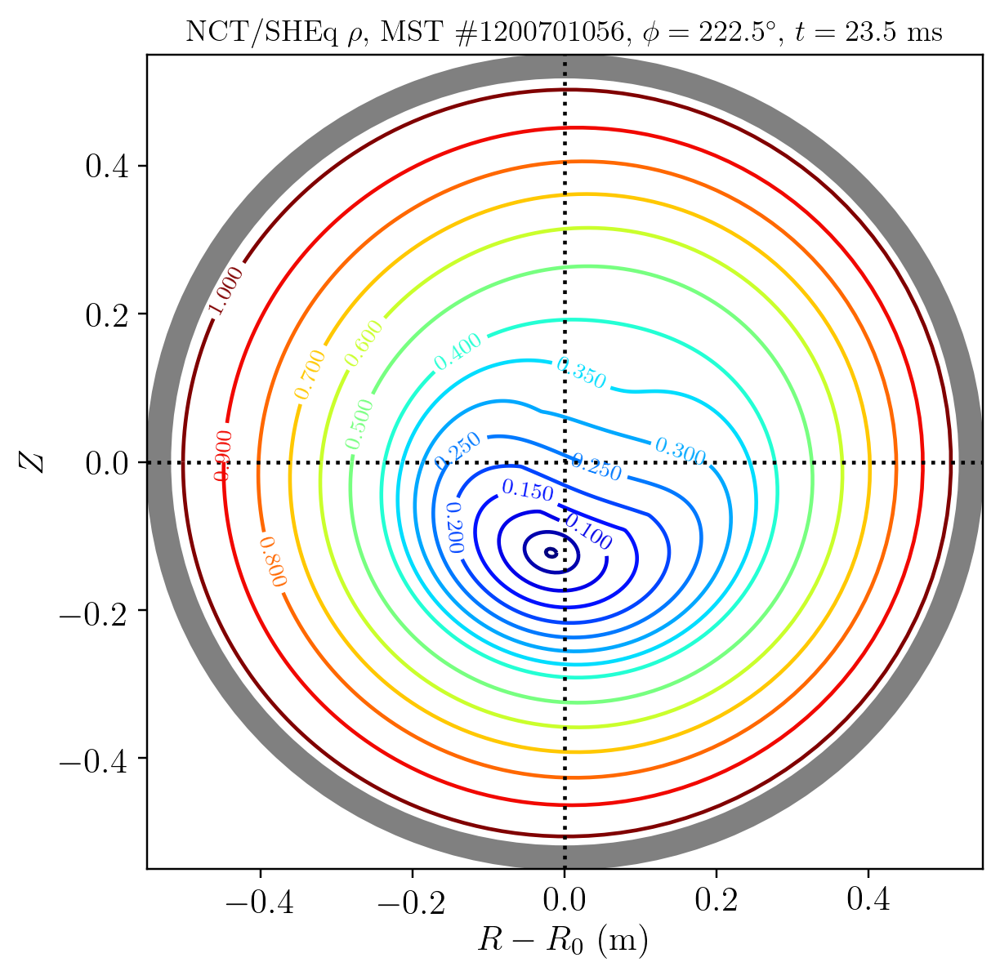

In [110]:
fig = plt.figure(figsize=(6,6))

levels = [0.01, 0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]
cax = plt.contour(flux.r-1.5, flux.z, flux.rho.T, levels=levels, cmap=cm.jet)
plt.clabel(cax, inline=True, fontsize=9)

overplot_shell(plt.gca())
plt.xlim([-0.55, 0.55])
plt.ylim([-0.55, 0.55])
plt.xlabel(r'$R - R_0$ (m)')
plt.ylabel(r'$Z$')
plt.axvline(x=0, linestyle=':', color='black')
plt.axhline(y=0, linestyle=':', color='black')
plt.title(r'NCT/SHEq $\rho$, MST \#{0:10d}, $\phi = 222.5^\circ$, $t = {1:.1f}$ ms'.format(shot,time));

Now, let's look at the flux surface averaged quantities.

In [61]:
idl('averages = sheq_flux_avg({0:}, {1:})'.format(shot, time))
avg = idl.ev('averages')
avg = AttrDict(avg)

In [86]:
print(avg.keys())

dict_keys(['chi', 'rhoh', 'rhop', 'm', 'n', 'rf_axis', 'thetaf_axis', 'phase_axis', 'delta_axis', 'deltaprime_axis', 'fh', 'psih', 'etah', 'q', 'qh', 'qetah', 'btor', 'bpol', 'b', 'b2', 'jtor', 'jpol', 'j2', 'jb', 'mua', 'btheta_up', 'bphi_up', 'buh_up', 'jphi_up', 'g11', 'dvolumedchi', 'volume', 's11', 's12', 's21', 's22', 've'])


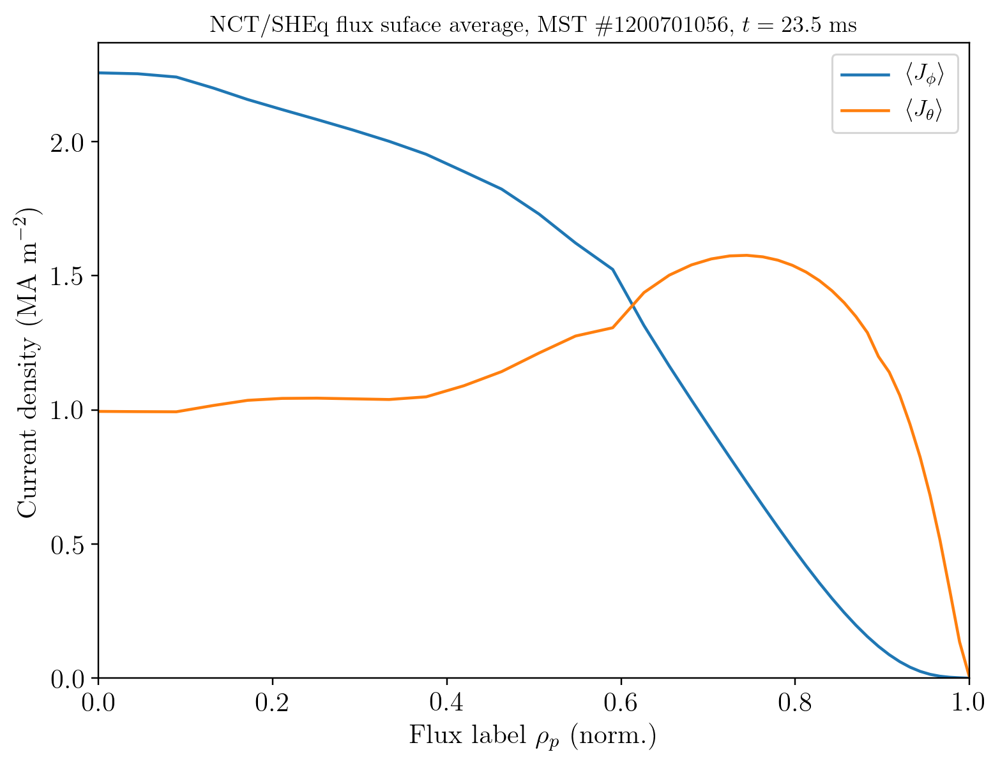

In [175]:
plt.plot(avg.rhop, avg.jtor/1e6, label=r'$\langle J_\phi \rangle$')
plt.plot(avg.rhop, avg.jpol/1e6, label=r'$\langle J_\theta \rangle$')

plt.legend()
plt.ylabel(r'Current density (MA m$^{-2}$)')
plt.xlabel(r'Flux label $\rho_p$ (norm.)')
plt.xlim([0,1])
plt.ylim([0,None])
plt.title(r'NCT/SHEq flux suface average, MST \#{0:10d}, $t = {1:.1f}$ ms'.format(shot,time));

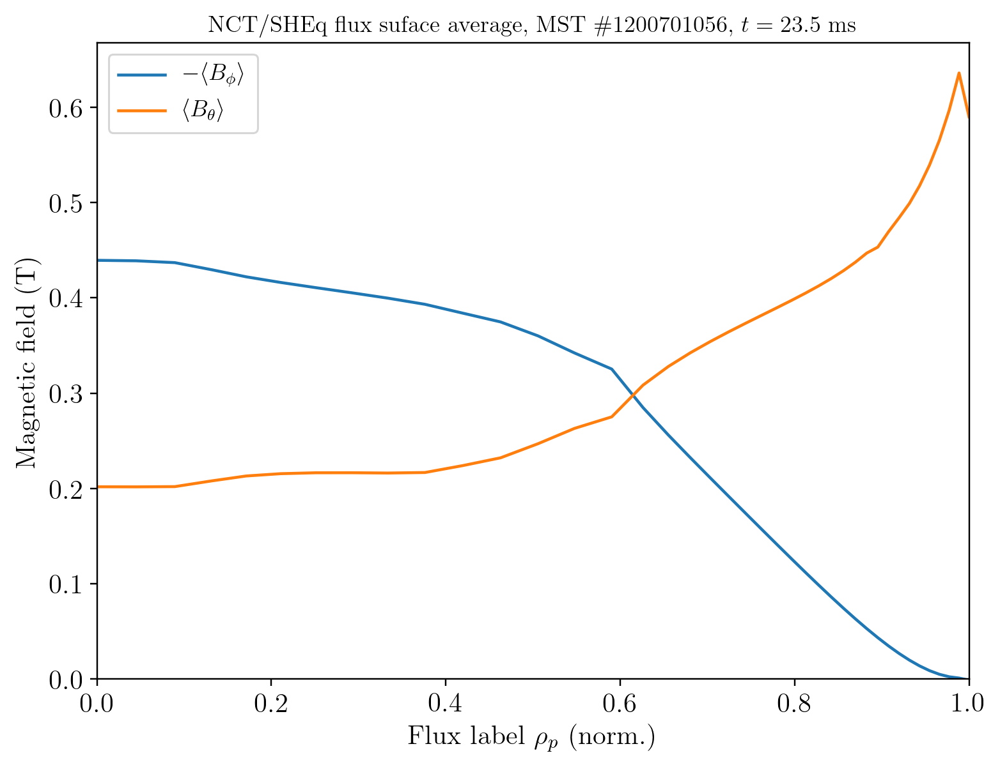

In [178]:
# Not sure of the units here
plt.plot(avg.rhop, -avg.btor, label=r'$-\langle B_\phi \rangle$')
plt.plot(avg.rhop, avg.bpol, label=r'$\langle B_\theta \rangle$')
#plt.axhline(y=0, color='black', linestyle='dashed')

plt.legend()
plt.ylabel(r'Magnetic field (T)')
plt.xlabel(r'Flux label $\rho_p$ (norm.)')
plt.xlim([0,1])
plt.ylim([0,None])
plt.title(r'NCT/SHEq flux suface average, MST \#{0:10d}, $t = {1:.1f}$ ms'.format(shot,time));

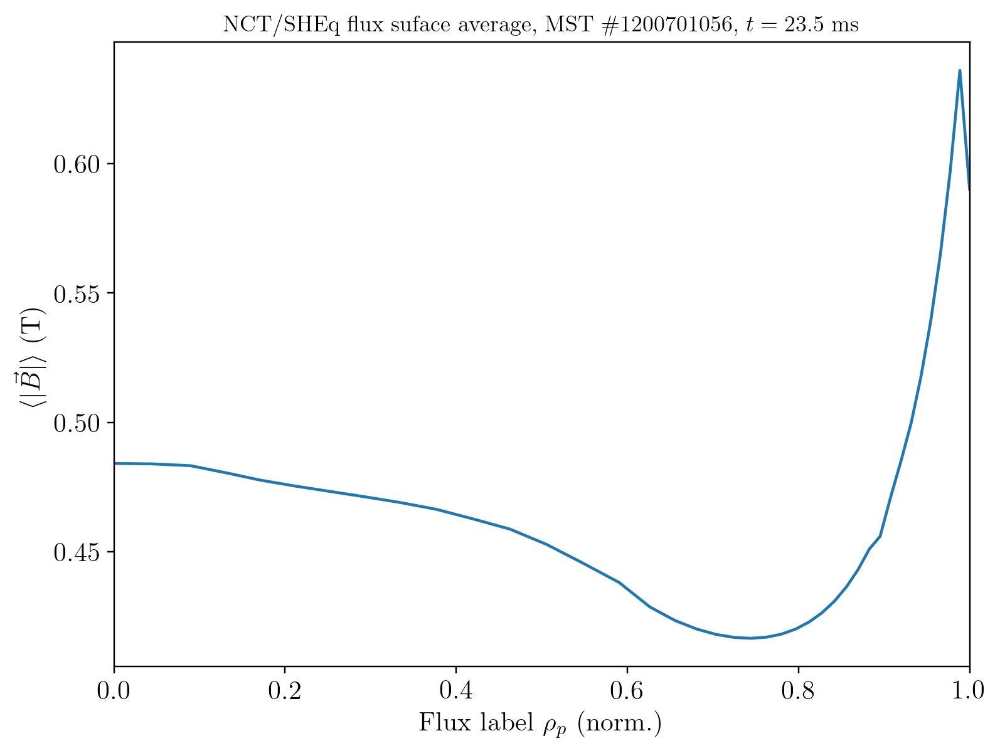

In [171]:
plt.plot(avg.rhop, avg.b)

plt.ylabel(r'$\langle |\vec{B}| \rangle$ (T)')
plt.xlabel(r'Flux label $\rho_p$ (norm.)')
plt.xlim([0,1])
plt.title(r'NCT/SHEq flux suface average, MST \#{0:10d}, $t = {1:.1f}$ ms'.format(shot,time));

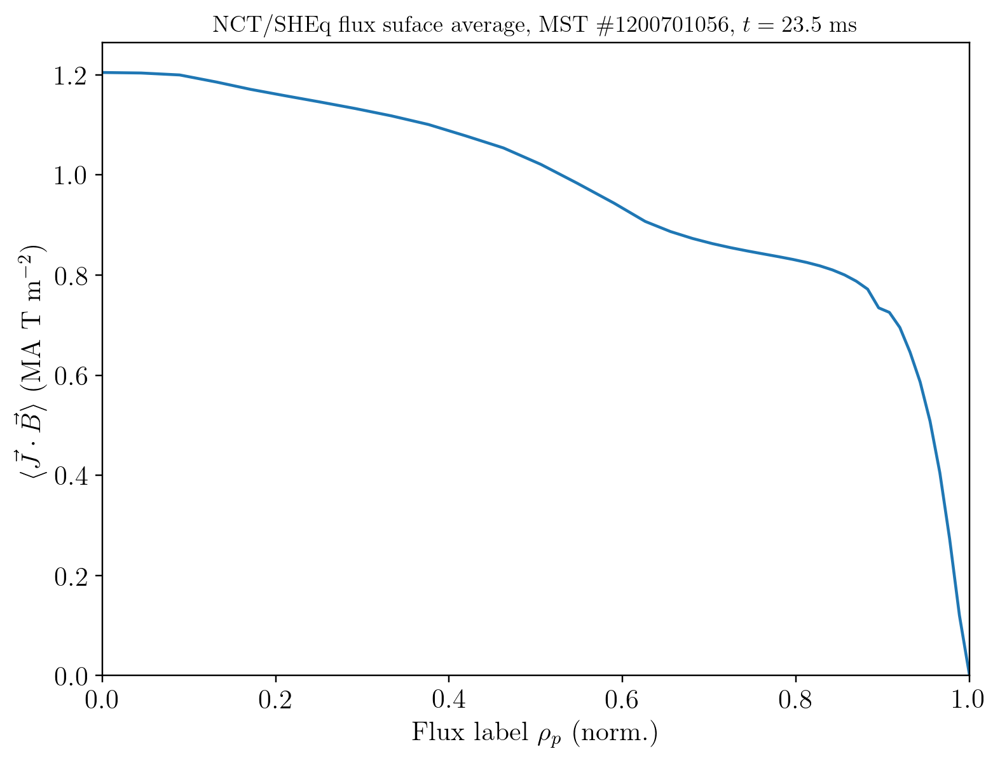

In [172]:
plt.plot(avg.rhop, -avg.jb/1e6)

plt.ylabel(r'$\langle \vec{J} \cdot \vec{B} \rangle$ (MA T m$^{-2}$)')
plt.xlabel(r'Flux label $\rho_p$ (norm.)')
plt.xlim([0,1])
plt.ylim([0,None])
plt.title(r'NCT/SHEq flux suface average, MST \#{0:10d}, $t = {1:.1f}$ ms'.format(shot,time));

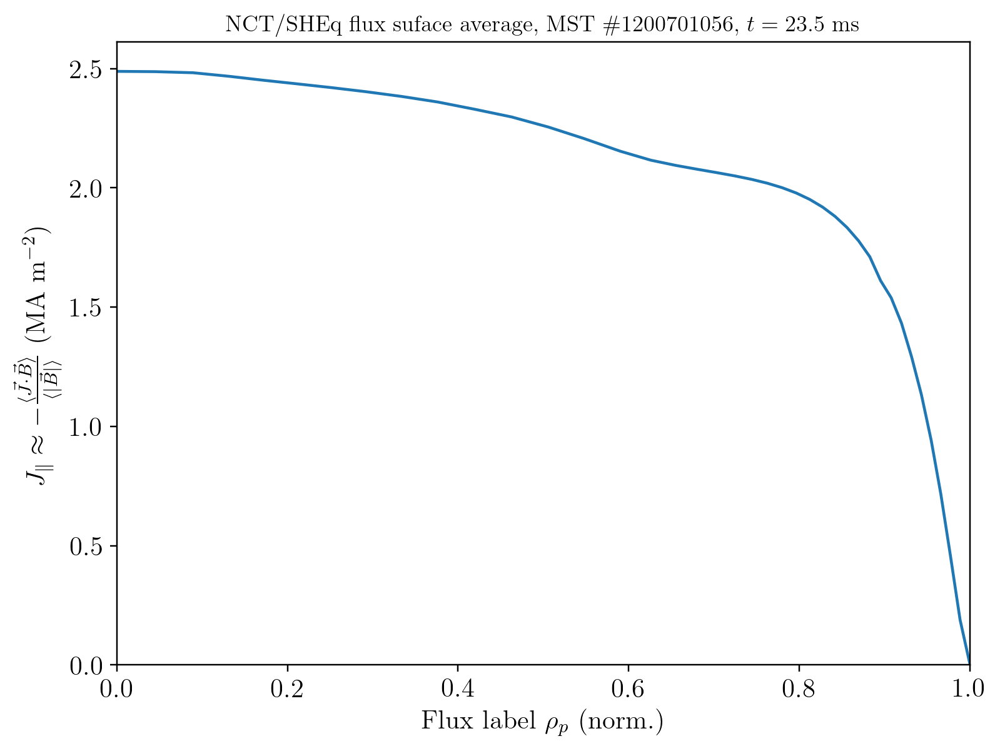

In [168]:
plt.plot(avg.rhop, -avg.jb/avg.b/1e6)

plt.ylabel(r'$J_\parallel \approx -\frac{\langle \vec{J} \cdot \vec{B} \rangle}{\langle |\vec{B}| \rangle}$ (MA m$^{-2}$)')
plt.xlabel(r'Flux label $\rho_p$ (norm.)')
plt.xlim([0,1])
plt.ylim([0,None])
plt.title(r'NCT/SHEq flux suface average, MST \#{0:10d}, $t = {1:.1f}$ ms'.format(shot,time));

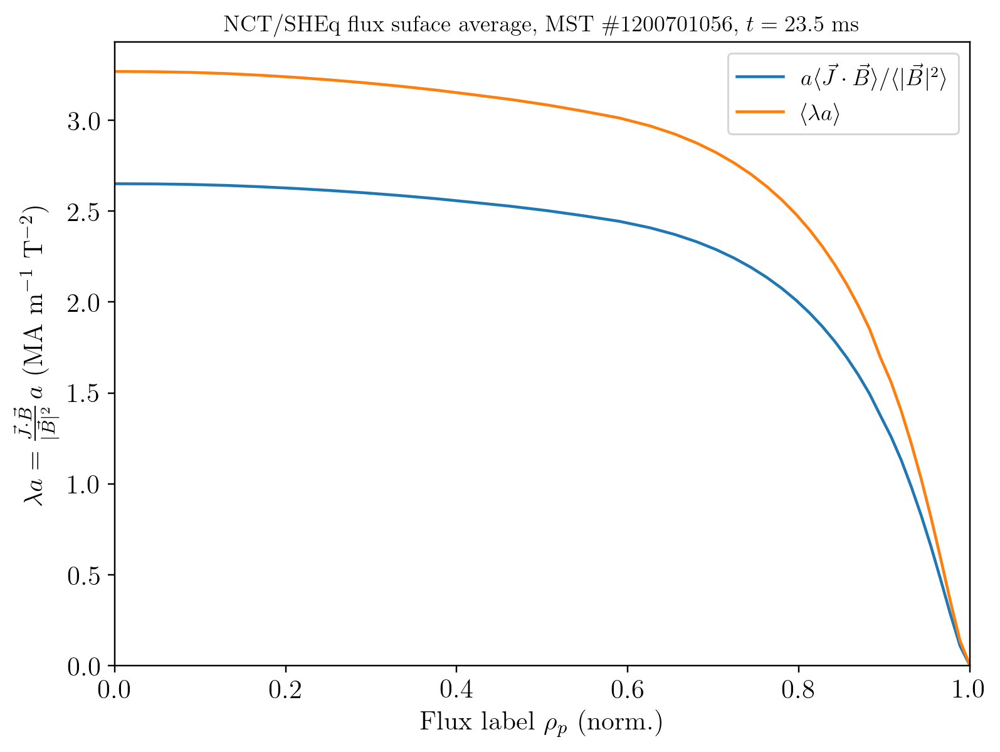

In [174]:
lam = - avg.jb / avg.b2 / 1e6
plt.plot(avg.rhop, lam*0.52, label=r'$a \langle \vec{J} \cdot \vec{B} \rangle / \langle|\vec{B}|^2\rangle$')
plt.plot(avg.rhop, -avg.mua, label=r'$\langle \lambda a \rangle$')

plt.legend()
plt.ylabel(r'$\lambda a = \frac{\vec{J}\cdot\vec{B}}{|\vec{B}|^2} \, a$ (MA m$^{-1}$ T$^{-2}$)')
plt.xlabel(r'Flux label $\rho_p$ (norm.)')
plt.xlim([0,1])
plt.ylim([0,None])
plt.title(r'NCT/SHEq flux suface average, MST \#{0:10d}, $t = {1:.1f}$ ms'.format(shot,time));

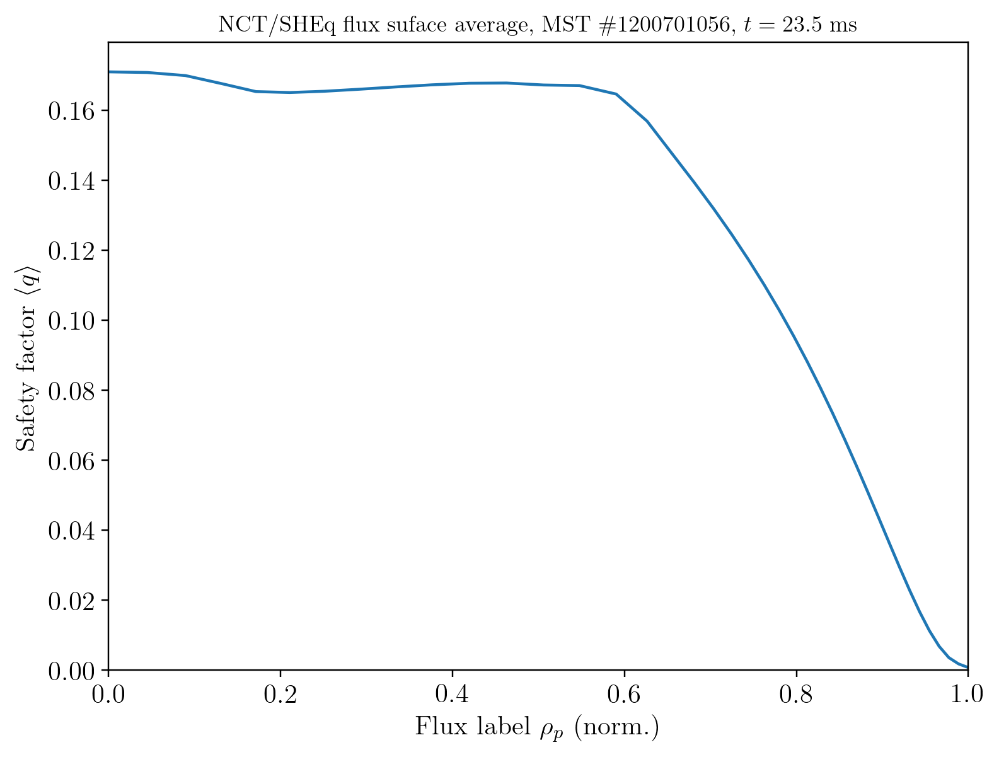

In [167]:
plt.plot(avg.rhop, -avg.q)

plt.ylabel(r'Safety factor $\langle q \rangle$')
plt.xlabel(r'Flux label $\rho_p$ (norm.)')
plt.xlim([0,1])
plt.ylim([0,None])
plt.title(r'NCT/SHEq flux suface average, MST \#{0:10d}, $t = {1:.1f}$ ms'.format(shot,time));

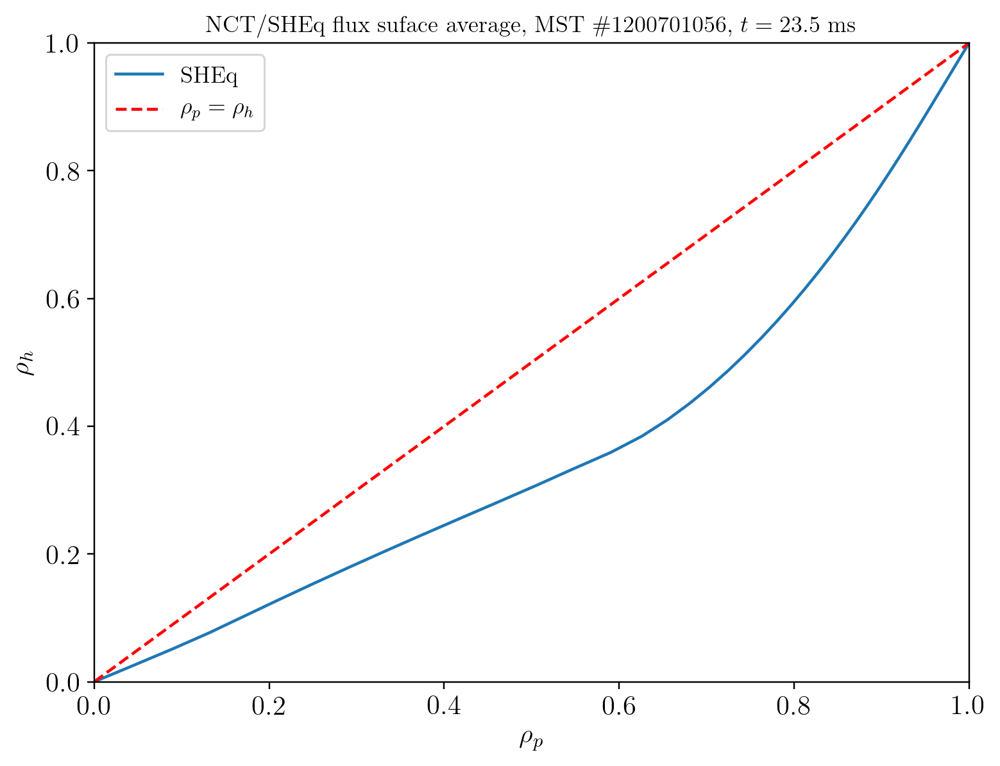

In [179]:
plt.plot(avg.rhop, avg.rhoh, label='SHEq')
plt.plot([0,1], [0,1], linestyle='dashed', color='red', label=r'$\rho_p = \rho_h$')

plt.legend()
plt.ylabel(r'$\rho_h$')
plt.xlabel(r'$\rho_p$')
plt.xlim([0,1])
plt.ylim([0,1])
plt.title(r'NCT/SHEq flux suface average, MST \#{0:10d}, $t = {1:.1f}$ ms'.format(shot,time));

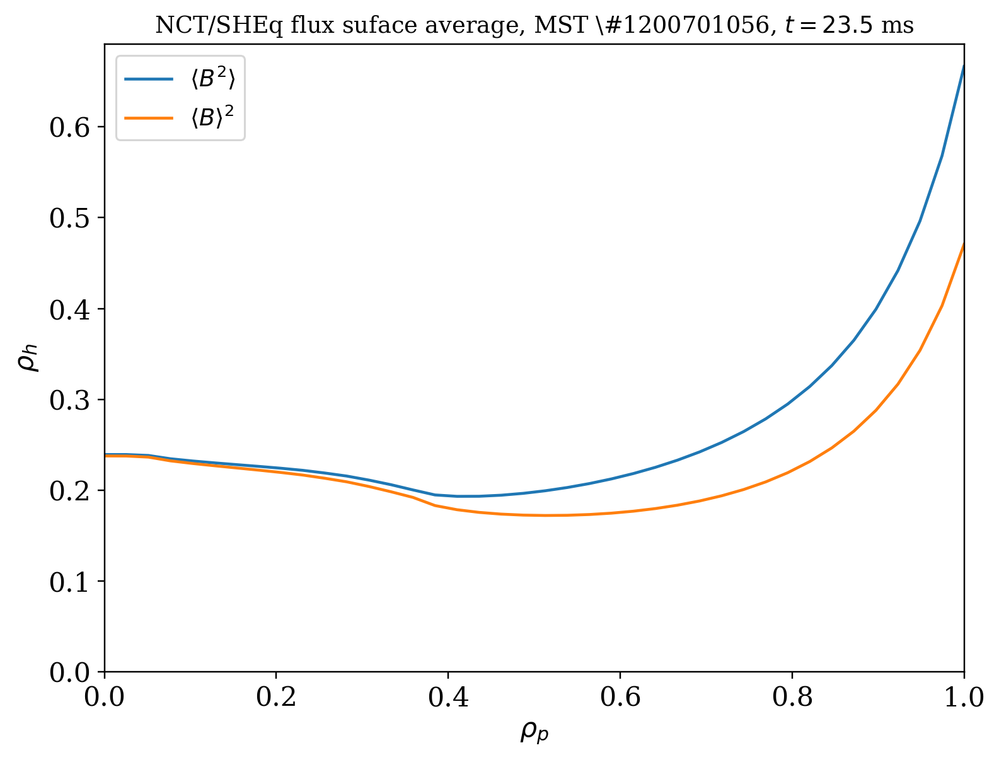

In [1281]:
plt.plot(avg.rhoh, avg.B2, label=r'$\langle B^2 \rangle$')
plt.plot(avg.rhoh, avg.B**2, label=r'$\langle B \rangle^2$')

plt.legend()
plt.ylabel(r'$\rho_h$')
plt.xlabel(r'$\rho_p$')
plt.xlim([0,1])
plt.ylim([0,None])
plt.title(r'NCT/SHEq flux suface average, MST \#{0:10d}, $t = {1:.1f}$ ms'.format(shot,23.5));

## Packaging the software

In [792]:
import pidly
import scipy.interpolate
from mst_ida.models.base.profile_base import Profile_2D_Spline
from mst_ida.utilities.structures import AttrDict

deg2rad = np.pi/180.
R0 = 1.5

def get_flux_grid(shot, time, phi=222.5*deg2rad):
    """
    Use SHEq to directly access the NCT output to evaluate rho on a grid of (R,Z) points.
    
    Inputs:
        - shot = MST shot number, corresponding to an existing NCT run.
        - time = Time point in ms, corresponding to an existing NCT run.
        - phi = Toroidal angle in radians.
    """
    idl = pidly.IDL()
    idl('.r /home/pdvanmeter/lib/idl/startup.pro')
    idl('.r run_sheq')
    idl('flux = run_sheq({0:}, {1:}, phi0={2:})'.format(shot, time, phi))
    flux_grid = idl.ev('flux')
    idl.close()
    
    flux_grid['rho'] = flux_grid['rho'].T
    return AttrDict(flux_grid)

def get_flux(shot, time, phis=[222.5*deg2rad], labels=['TS']):
    """
    """
    flux_grids = {}
    flux = {}
    for label,phi in zip(labels,phis):
        flux_grids[label] = get_flux_grid(shot, time, phi=phi)
        
    # Build the interpolation functions
    for label in labels:
        sample_coords = list(zip(flux_grids[label].r.ravel()-R0, flux_grids[label].z.ravel()))
        flux[label] = Profile_2D_Spline(r'$\rho$', sample_coords, flux_grids[label].rho.T.ravel(), units='norm.', dim_units=['m', 'm'],
                                   method='linear', boundary=1.0)
        
    return flux

def sheq_averages(shot, time, return_all=False):
    """
    Returns flux-surface averaged quantities of physical significance.
    
    Inputs:
        - shot = MST shot number, corresponding to an existing NCT run.
        - time = Time point in ms, corresponding to an existing NCT run.
        - return_all = Set to True to instead return the full sh_averages.pro structure.
    """
    idl = pidly.IDL()
    idl('.r /home/pdvanmeter/lib/idl/startup.pro')
    idl('.r run_sheq')
    idl('averages = sheq_flux_avg({0:}, {1:})'.format(shot, time))
    avg = AttrDict(idl.ev('averages'))
    idl.close()
    
    if return_all:
        return avg
    else:
        return AttrDict({
            'rhop':avg.rhop,
            'rhoh':avg.rhoh,
            'J_pol':avg.jpol/1e6,
            'J_tor':avg.jtor/1e6,
            'B_pol':avg.bpol,
            'B_tor':avg.btor,
            'B':avg.b,
            'B2':avg.b2,
            'JB':-avg.jb/1e6,
            'J_para':-avg.jb/avg.b/1e6,
            'mua':-avg.mua,
            'q':-avg.q,
            'delta':float(avg.delta_axis)
        })

In [225]:
shot = 1200701056
time = 23.5
phi0 = 90.0*deg2rad

In [226]:
%%capture 
fg = get_flux_grid(shot, time, phi=phi0)

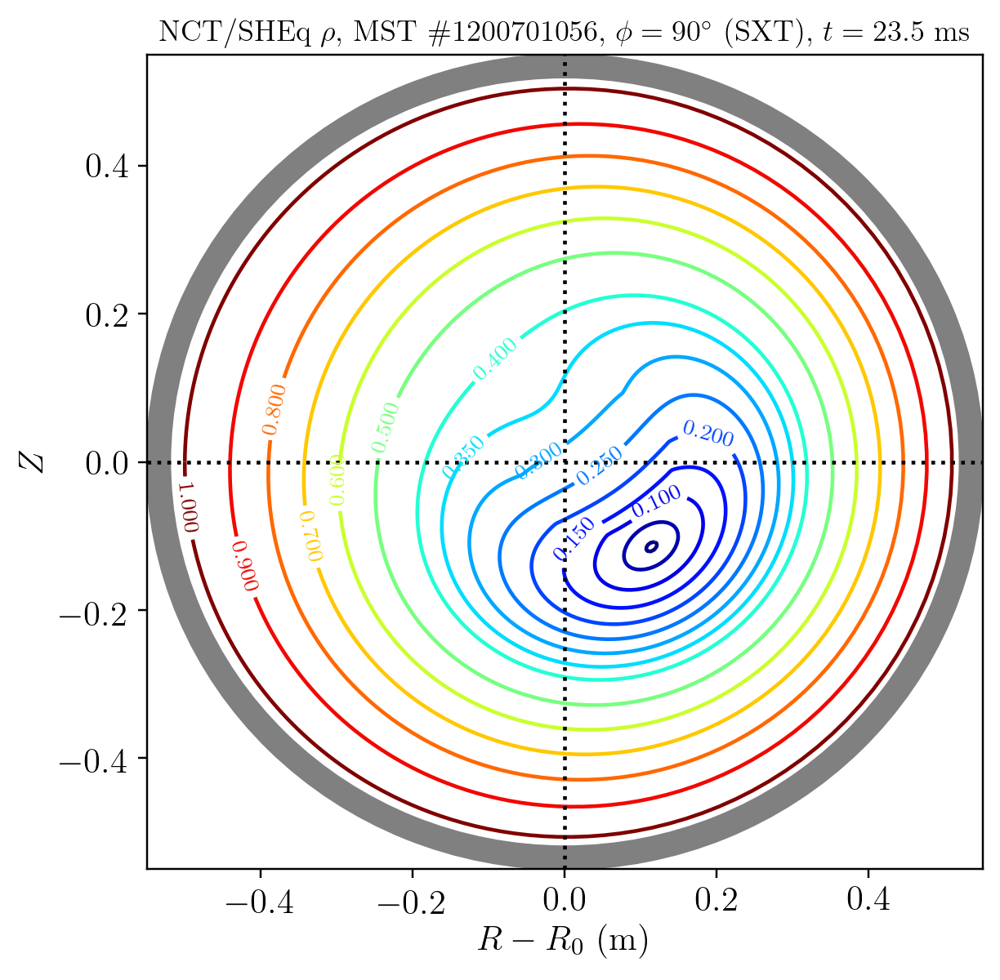

In [240]:
fig = plt.figure(figsize=(6,6))

levels = [0.01, 0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]
cax = plt.contour(fg.r-R0, fg.z, fg.rho.T, levels=levels, cmap=cm.jet)
plt.clabel(cax, inline=True, fontsize=9)

overplot_shell(plt.gca())
plt.xlim([-0.55, 0.55])
plt.ylim([-0.55, 0.55])
plt.xlabel(r'$R - R_0$ (m)')
plt.ylabel(r'$Z$')
plt.axvline(x=0, linestyle=':', color='black')
plt.axhline(y=0, linestyle=':', color='black')
plt.title(r'NCT/SHEq $\rho$, MST \#{0:10d}, $\phi = 90^\circ$ (SXT), $t = {1:.1f}$ ms'.format(shot,time));

In [233]:
fg.r.shape

(200, 200)

In [242]:
%%capture 
flux = get_flux(shot, time, phis=[phi0], labels=['SXT'])

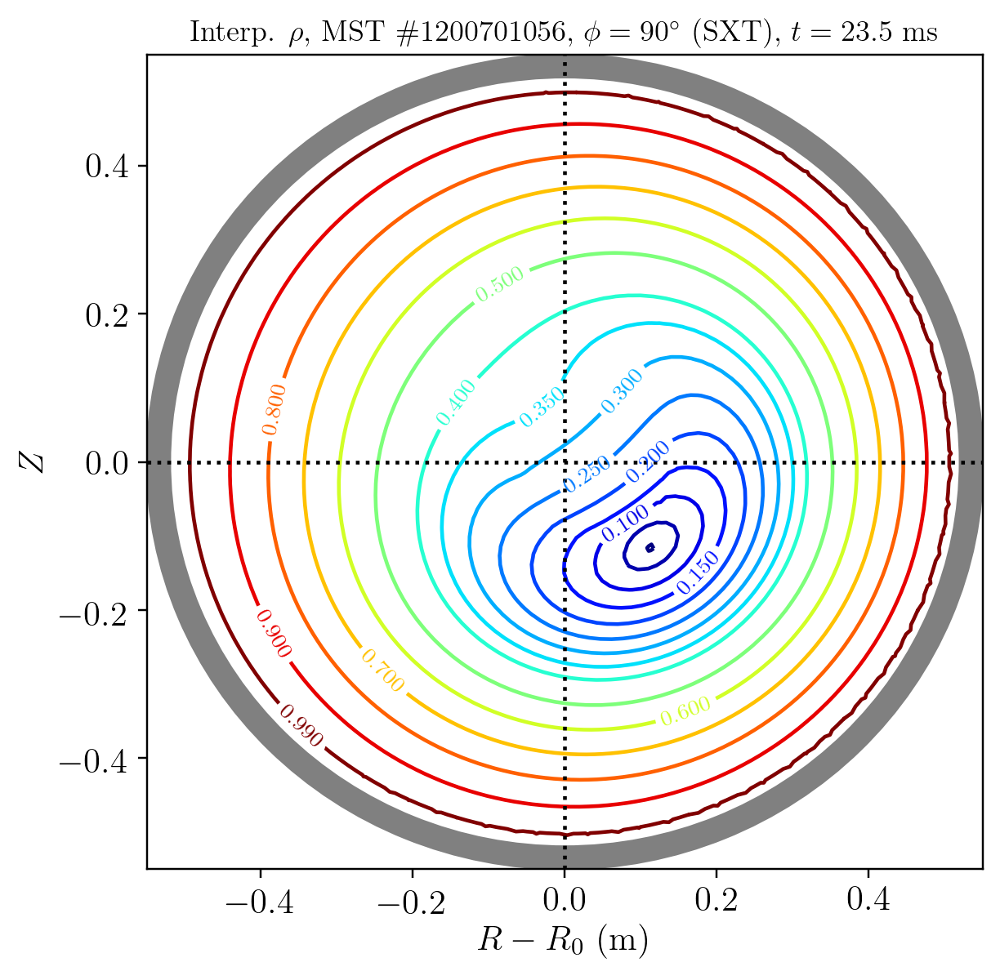

In [251]:
from mst_ida.models.base.geometry import sunflower_points
fig = plt.figure(figsize=(6,6))

xs, ys = sunflower_points(5000)
levels = [0.01, 0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 0.99]
cax = plt.tricontour(xs, ys, flux['SXT'](xs,ys), levels=levels, cmap=cm.jet)
plt.clabel(cax, inline=True, fontsize=9)

overplot_shell(plt.gca())
plt.xlim([-0.55, 0.55])
plt.ylim([-0.55, 0.55])
plt.xlabel(r'$R - R_0$ (m)')
plt.ylabel(r'$Z$')
plt.axvline(x=0, linestyle=':', color='black')
plt.axhline(y=0, linestyle=':', color='black')
plt.title(r'Interp. $\rho$, MST \#{0:10d}, $\phi = 90^\circ$ (SXT), $t = {1:.1f}$ ms'.format(shot,time));

And again the TS position, to make sure these results are consistent with what Karsten found. There is some weirdness going on with array transposition, but as long as I am getting the correct results, I am not going to worry too much about it.

In [247]:
%%capture 
shot = 1200701056
time = 23.5
phi0 = 222.5*deg2rad
fg = get_flux_grid(shot, time, phi=phi0)

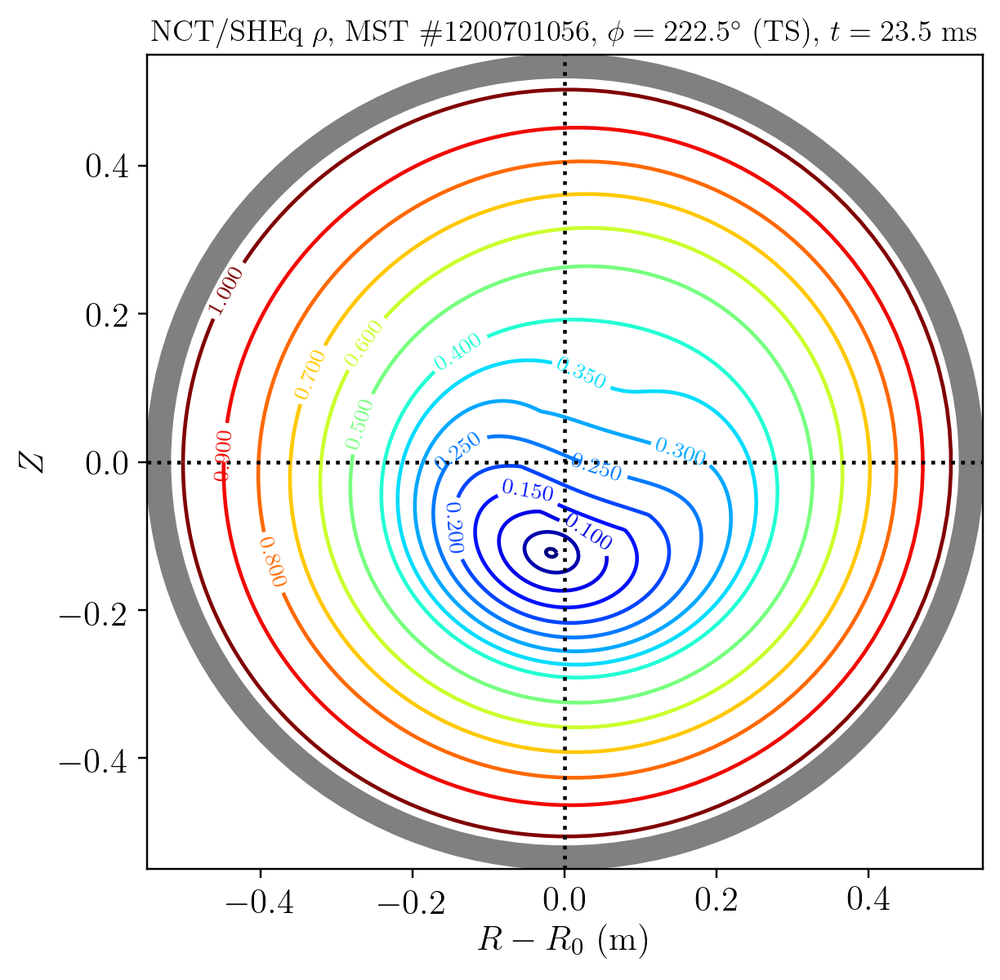

In [248]:
fig = plt.figure(figsize=(6,6))

levels = [0.01, 0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]
cax = plt.contour(fg.r-R0, fg.z, fg.rho.T, levels=levels, cmap=cm.jet)
plt.clabel(cax, inline=True, fontsize=9)

overplot_shell(plt.gca())
plt.xlim([-0.55, 0.55])
plt.ylim([-0.55, 0.55])
plt.xlabel(r'$R - R_0$ (m)')
plt.ylabel(r'$Z$')
plt.axvline(x=0, linestyle=':', color='black')
plt.axhline(y=0, linestyle=':', color='black')
plt.title(r'NCT/SHEq $\rho$, MST \#{0:10d}, $\phi = 222.5^\circ$ (TS), $t = {1:.1f}$ ms'.format(shot,time));

Now, let's make sure that the flux surface averaged quantities are working correctly.

In [259]:
%%capture 
shot = 1200701056
time = 23.5

avg = sheq_averages(shot, time)

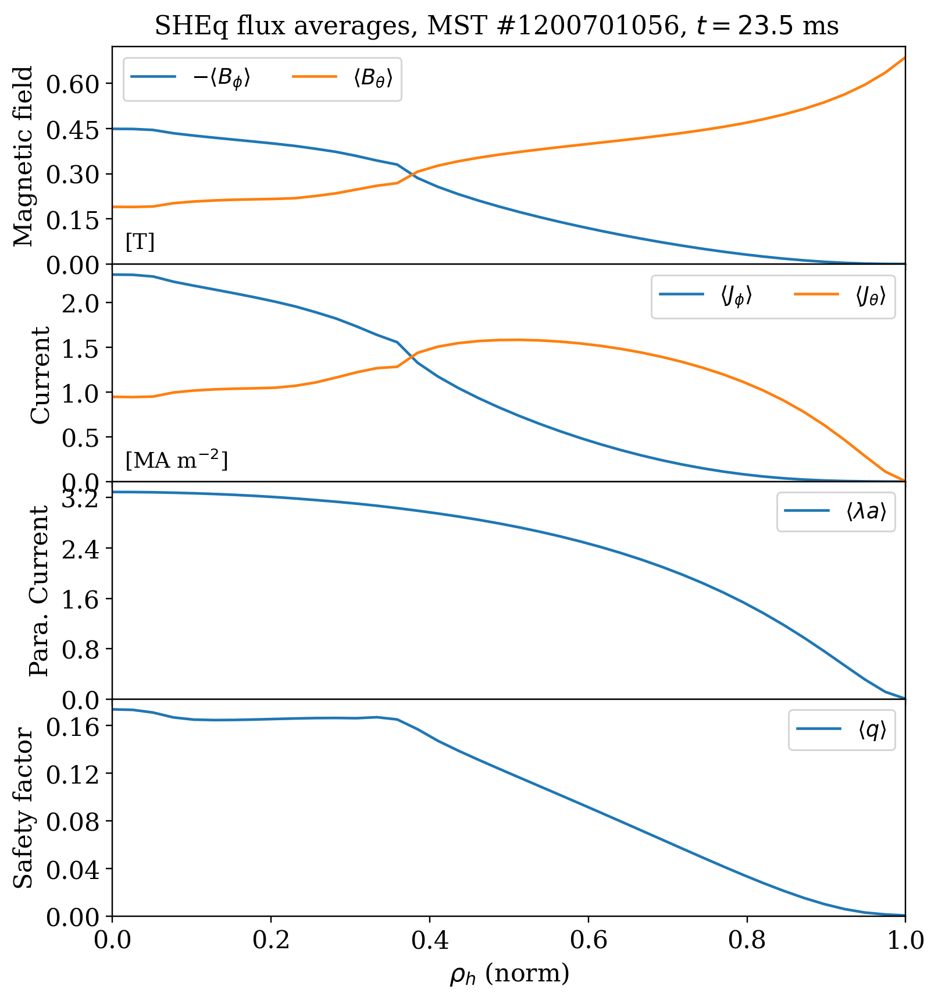

In [1301]:
fig, axs = plt.subplots(4,1, figsize=(8,9))

# Magnetic field
axs[0].plot(avg.rhoh, -avg.B_tor, label=r'$-\langle B_\phi \rangle$')
axs[0].plot(avg.rhoh, avg.B_pol, label=r'$\langle B_\theta \rangle$')
axs[0].legend(ncol=2)
axs[0].set_ylabel('Magnetic field')
text(0.035, 0.1, r'[T]', axs[0])

# Current density
axs[1].plot(avg.rhoh, avg.J_tor, label=r'$\langle J_\phi \rangle$')
axs[1].plot(avg.rhoh, avg.J_pol, label=r'$\langle J_\theta \rangle$')
axs[1].legend(ncol=2)
axs[1].set_ylabel('Current')
text(0.08, 0.1, r'[MA m$^{-2}$]', axs[1])

# Lambda a
axs[2].plot(avg.rhoh, avg.mua, label=r'$\langle \lambda a \rangle$')
axs[2].set_ylabel(r'Para. Current')
axs[2].legend()
#text(0.1, 0.1, r'[MA m$^{-1}$ T$^{-2}$]', axs[2])

# Safety factor
axs[3].plot(avg.rhoh, avg.q, label=r'$\langle q \rangle$')
axs[3].set_ylabel(r'Safety factor')
axs[3].legend()

for ax in axs:
    ax.set_xlim([0,1])
    ax.set_ylim([0,None])
    ax.yaxis.set_major_locator(MaxNLocator(nbins=5, prune='upper'))

for ax in axs[:-1]:
    ax.xaxis.set_ticklabels([])
    
axs[-1].set_xlabel(r'$\rho_h$ (norm)')
plt.subplots_adjust(wspace=0, hspace=0)
fig.suptitle(r'SHEq flux averages, MST #{0:10d}, $t = {1:.1f}$ ms'.format(shot, 23.5), y=0.91);

In [1298]:
mu0 = 1.2566e-6    # H m^-1
mu0 * avg.J_pol[0]*1e6 / avg.mua[0] * 0.52

0.1882907297501828

In [1299]:
avg.B_pol[0]

0.19017516

In [1302]:
mu0*500.0*1e3 / (2 * np.pi * 0.52)

0.19230202066276506

In [1304]:
avg.B_pol[-1] / np.pi

0.2183417576171639

## Plasma evolution with SHEq

In [305]:
from mst_ida.data.sxt import load_brightness, invert_brightness
from mst_ida.data.fir import get_fir_signals
import mst_ida.data.mst_ops as ops
import mst_ida.data.mesxr as mesxr
import mst_ida.analysis.tomography as tom
import MDSplus as mds

def get_fxr_data(shot):
    mstTree = mds.Tree('mst', shot, 'READONLY')
    en_node = mstTree.getNode('\\MST_FXR::TOP:PULSE_ENERGY')
    tm_node = mstTree.getNode('\\MST_FXR::TOP:PULSE_TIME')

    fxr_energy = en_node.getData().data()
    fxr_time = tm_node.getData().data()*1000.0
    return fxr_energy, fxr_time

def get_fxr_hist(shot, times=np.arange(0.5, 55.0), lower_en=2.0, upper_en=70.0):
    fxr_energy, fxr_time = get_fxr_data(shot)
    bin_edges = np.arange(lower_en, upper_en+1)
    energy = np.array([(bin_edges[n] + bin_edges[n+1])/2 for n in range(len(bin_edges)-1)])
    counts = np.zeros([len(times), len(energy)])

    for index,t in enumerate(times):
        t1 = t - 0.5
        t2 = t + 0.5
        indices = np.where((fxr_time > t1) & (fxr_time < t2) )[0]
        counts[index,:] , _ = np.histogram(fxr_energy[indices], bins=bin_edges)
        
    return counts, energy, times

def get_profs(shot, start_frame=0, end_frame=30, smooth=True):
    # Load the data and fit each threshold
    frames = np.arange(start_frame, end_frame+1)
    num_frames = len(frames)
    
    t_start = 2*start_frame+0.5
    t_end = 2*end_frame+0.5
    tiempo = np.arange(t_start, t_end+2, 2)
    
    # Set the first frame manually to get the thresholds
    mesxr_data = mesxr.load_raw_data(shot)
    prof, signed_p, thresholds = mesxr.profiles_from_image(mesxr_data['images'][:,:,0], mesxr_data['thresholds'], smooth=smooth)
    profiles = {Ec:np.zeros([num_frames, 60]) for Ec in thresholds}
    
    for ii,frame in enumerate(frames):
        prof = mesxr.profiles_from_image(mesxr_data['images'][:,:,frame], mesxr_data['thresholds'], smooth=smooth)[0]
        
        for Ec in thresholds:
            profiles[Ec][ii,:] = prof[Ec]
            
    return profiles, tiempo, signed_p, thresholds

In [306]:
%%capture 
shot = 1200701056
t_start = 8.0
t_end = 55.0
delta_t = 0.1

st = load_brightness(shot, t_start=t_start, t_end=t_end, delta=delta_t, smooth=10)
tomo = invert_brightness(shot, t_start=t_start, t_end=t_end, delta=delta_t, smooth=10, exclude=[20,59,60], thin=True)
mags = ops.get_magnetics(shot, t_start=t_start, t_end=t_end, delta_t=delta_t, modes=np.arange(1,16))
fir_data, fir_radius, fir_time = get_fir_signals(shot)
profs, tiempo, signed_p, thresholds = get_profs(shot, start_frame=0)
fxr_energy, fxr_time = get_fxr_data(shot)

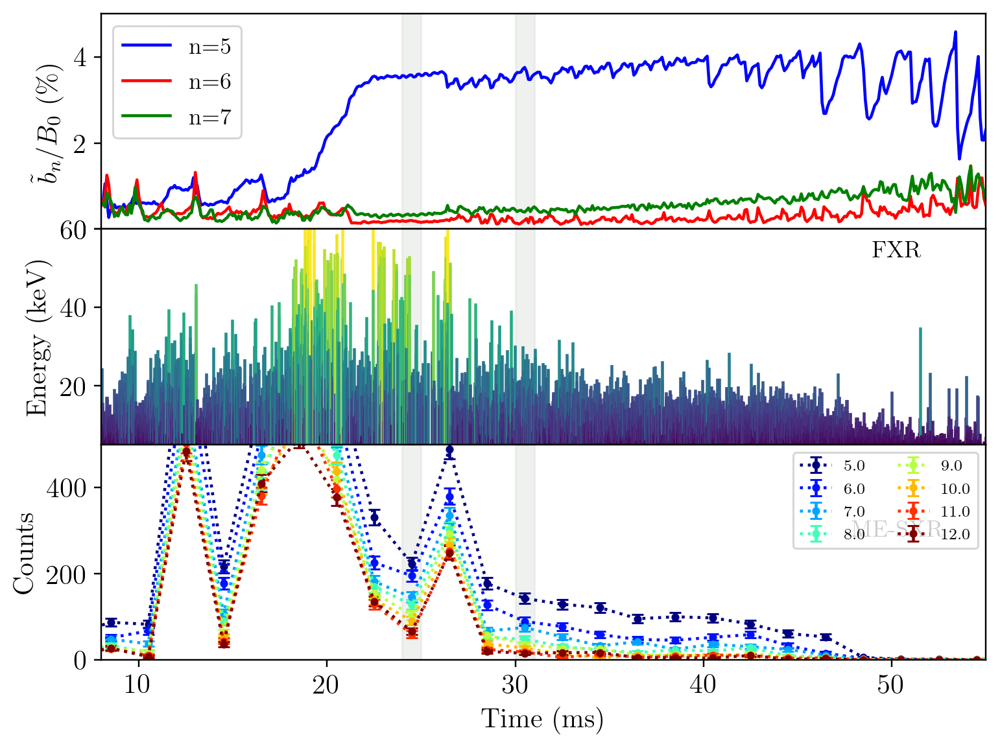

In [309]:
fig, axs = plt.subplots(3,1)
fxr_threshold = 5.0

# Magnetics signals    
b0 = np.sqrt(mags.BP['EQ']**2 + mags.BT['EQ'])
for n,color in zip([5,6,7], ['blue','red','green']):
    key = 'N{0:02d}'.format(n)
    b_n = np.sqrt(mags.BP[key]['Amplitude']**2 + mags.BT[key]['Amplitude'])
    axs[0].plot(mags.Time, b_n / b0 * 100, label='n={0:d}'.format(n), color=color)

axs[0].legend(loc='upper left')
axs[0].set_ylabel(r'$\tilde{b}_n/B_{0}$ (\%)')
axs[0].set_ylim([0,5])

# FXR signals
norm = Normalize(fxr_threshold,60)
cmap = cm.viridis

for index in range(len(fxr_time)):
    amp = fxr_energy[index]
    if amp > fxr_threshold:
        axs[1].plot([fxr_time[index],fxr_time[index]], [0,amp], '-', color=cmap(norm(amp)))

axs[1].set_ylim([fxr_threshold, 60])
axs[1].set_ylabel('Energy (keV)')
text(0.9, 0.9, 'FXR', axs[1], color='black')

# ME-SXR core
x_index = 30
cmap = cm.jet
norm = Normalize(np.amin(thresholds), np.amax(thresholds))
for Ec in thresholds:
    y =  np.maximum(profs[Ec][:,x_index],0)
    axs[2].errorbar(tiempo, y, yerr=np.sqrt(y), label='{0:.1f}'.format(Ec),
                    capsize=3, ms=3, marker='o', linestyle=':', color=cmap(norm(Ec)))
axs[2].legend(ncol=2, fontsize=8)
axs[2].set_ylabel('Counts')
axs[2].set_ylim([0,500])
text(0.9, 0.6, 'ME-SXR', axs[2], color='black')

# Format the axes
for ax in axs[:-1]:
    ax.xaxis.set_ticklabels([])

for ax in axs:
    ax.set_xlim([t_start, t_end])
    ax.axvspan(24.0, 25.0, color='xkcd:light gray', alpha=0.4)
    ax.axvspan(29.5, 30.5, color='xkcd:light gray', alpha=0.4)
    
axs[-1].set_xlabel('Time (ms)')
axs[-1].set_xlim([t_start, t_end])
plt.subplots_adjust(wspace=0, hspace=0);

In [322]:
%%capture 
shot = 1200701056
t1 = 24.5
t2 = 30.0
phi0 = 90*deg2rad

fg1 = get_flux_grid(shot, t1, phi=phi0)
fg2 = get_flux_grid(shot, t2, phi=phi0)

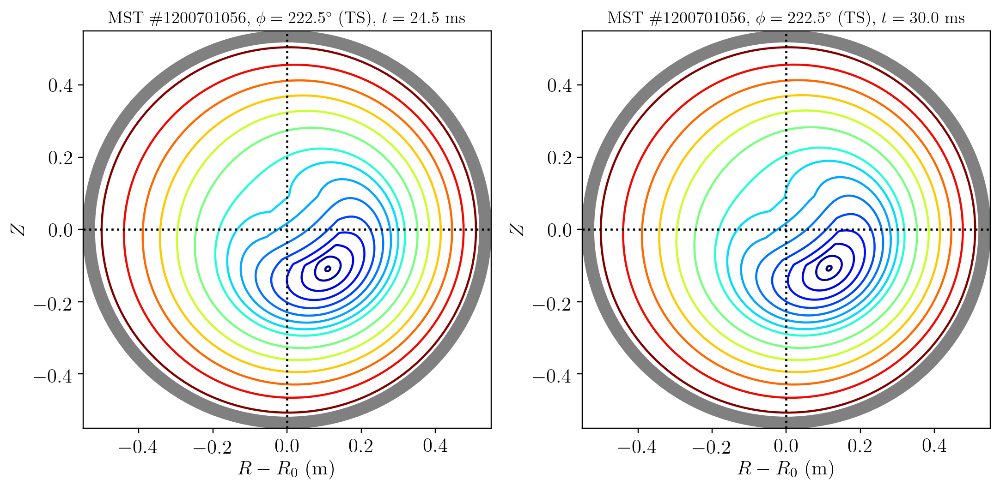

In [323]:
fig, axs = plt.subplots(1, 2, figsize=(10,5))

levels = [0.01, 0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]
cax1 = axs[0].contour(fg1.r-R0, fg1.z, fg1.rho.T, levels=levels, cmap=cm.jet)
cax2 = axs[1].contour(fg2.r-R0, fg2.z, fg2.rho.T, levels=levels, cmap=cm.jet)

for ax in axs:
    overplot_shell(ax)
    ax.set_xlim([-0.55, 0.55])
    ax.set_ylim([-0.55, 0.55])
    ax.set_xlabel(r'$R - R_0$ (m)')
    ax.set_ylabel(r'$Z$')
    ax.axvline(x=0, linestyle=':', color='black')
    ax.axhline(y=0, linestyle=':', color='black')

axs[0].set_title(r'MST \#{0:10d}, $\phi = 222.5^\circ$ (TS), $t = {1:.1f}$ ms'.format(shot,t1))
axs[1].set_title(r'MST \#{0:10d}, $\phi = 222.5^\circ$ (TS), $t = {1:.1f}$ ms'.format(shot,t2))
plt.tight_layout();

In [361]:
%%capture 
shot = 1200701056
t1 = 19.0
t2 = 24.5
phi0 = 90*deg2rad

fg1 = get_flux_grid(shot, t1, phi=phi0)
fg2 = get_flux_grid(shot, t2, phi=phi0)

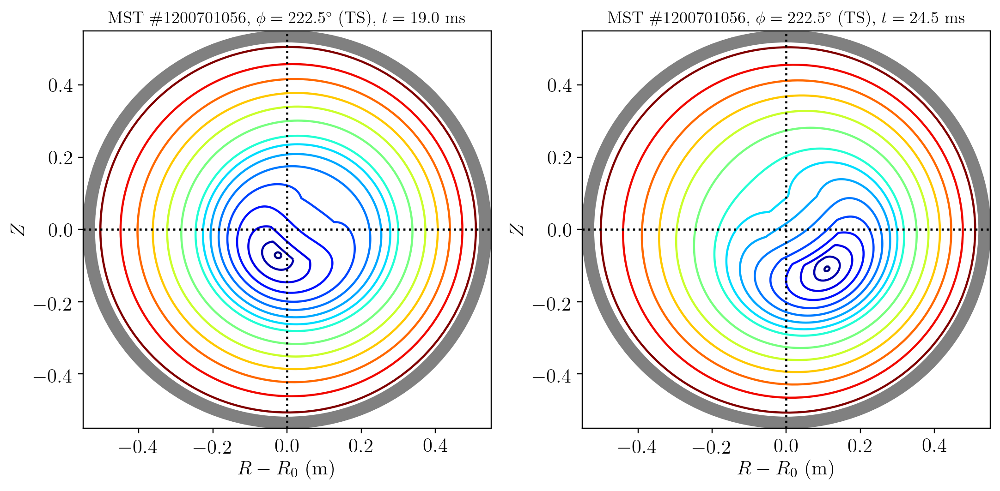

In [362]:
fig, axs = plt.subplots(1, 2, figsize=(10,5))

levels = [0.01, 0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]
cax1 = axs[0].contour(fg1.r-R0, fg1.z, fg1.rho.T, levels=levels, cmap=cm.jet)
cax2 = axs[1].contour(fg2.r-R0, fg2.z, fg2.rho.T, levels=levels, cmap=cm.jet)

for ax in axs:
    overplot_shell(ax)
    ax.set_xlim([-0.55, 0.55])
    ax.set_ylim([-0.55, 0.55])
    ax.set_xlabel(r'$R - R_0$ (m)')
    ax.set_ylabel(r'$Z$')
    ax.axvline(x=0, linestyle=':', color='black')
    ax.axhline(y=0, linestyle=':', color='black')

axs[0].set_title(r'MST \#{0:10d}, $\phi = 222.5^\circ$ (TS), $t = {1:.1f}$ ms'.format(shot,t1))
axs[1].set_title(r'MST \#{0:10d}, $\phi = 222.5^\circ$ (TS), $t = {1:.1f}$ ms'.format(shot,t2))
plt.tight_layout();

In [363]:
times = np.array([
        18.0, 18.5, 19.0, 19.5, 20.0, 20.5, 21.0, 21.5, 22.0, 22.5, 23.0,
        23.5, 24.0, 24.5, 25.0, 25.5, 26.0, 26.5, 27.0, 28.0, 29.0, 30.0,
        31.0, 32.0, 33.0, 34.0, 35.0, 36.0, 37.0, 38.0, 39.0, 40.0
])

In [325]:
%%capture 
# Get the current density as it evolves over time
lam_ts = np.zeros([40, len(times)])
rhos = np.zeros([40, len(times)])

for i,time in enumerate(times):
    avg = sheq_averages(shot, time)
    lam_ts[:,i] = avg.mua
    rhos[:,i] = avg.rhop

In [357]:
%%capture 
# Get the current density as it evolves over time
q_ts = np.zeros([40, len(times)])

for i,time in enumerate(times):
    avg = sheq_averages(shot, time)
    q_ts[:,i] = avg.q

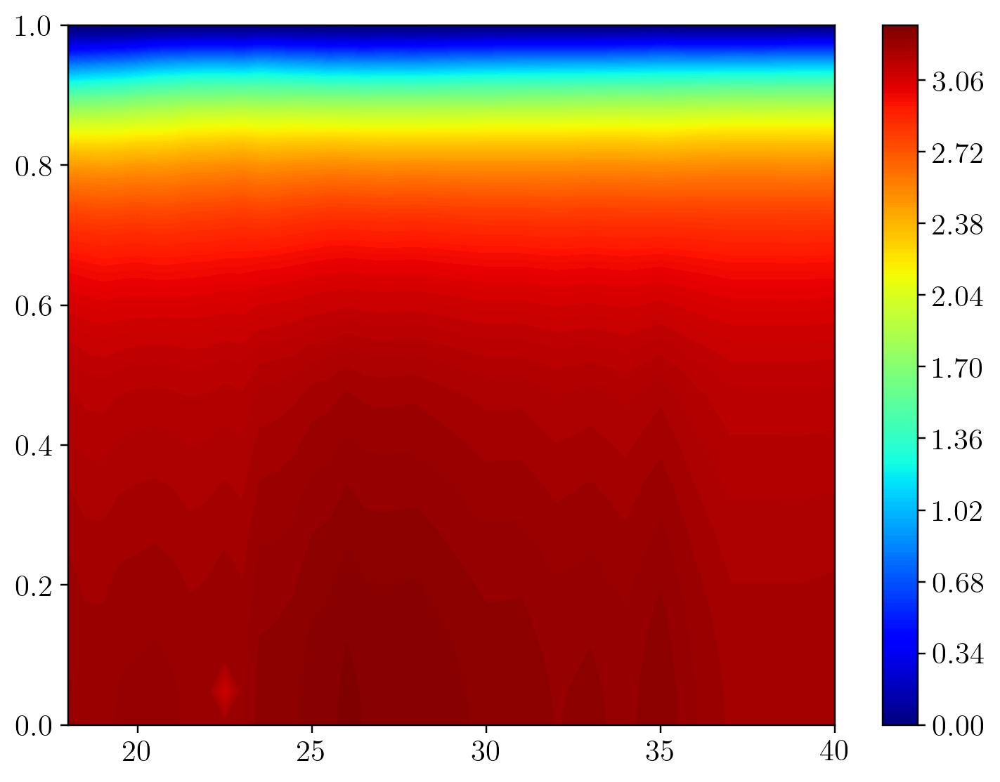

In [340]:
cax = plt.contourf(times, rhos[:,0], lam_ts, 200, cmap=cm.jet)
plt.colorbar(cax, label=r'$\langle \lambda a \rangle$ (MA m$^{-1}$ T$^{-2}$)')
plt.xlabel(r'Time (ms)')
plt.ylabel(r'$\rho$ (norm.)');

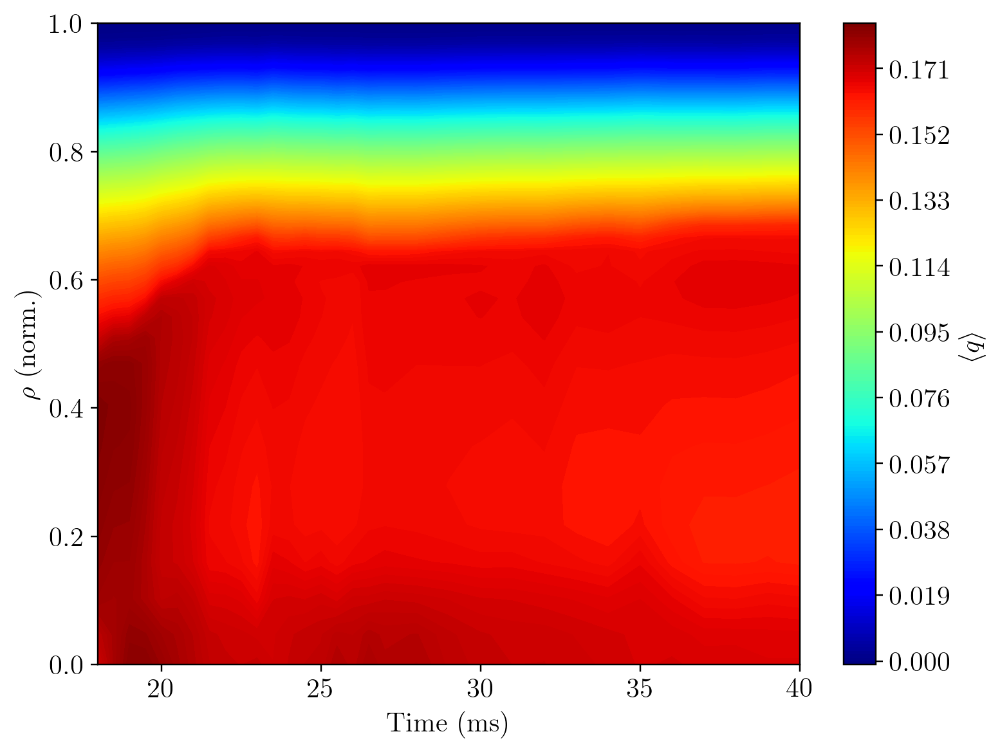

In [358]:
cax = plt.contourf(times, rhos[:,0], q_ts, 200, cmap=cm.jet)
plt.colorbar(cax, label=r'$\langle q \rangle$')
plt.xlabel(r'Time (ms)')
plt.ylabel(r'$\rho$ (norm.)');

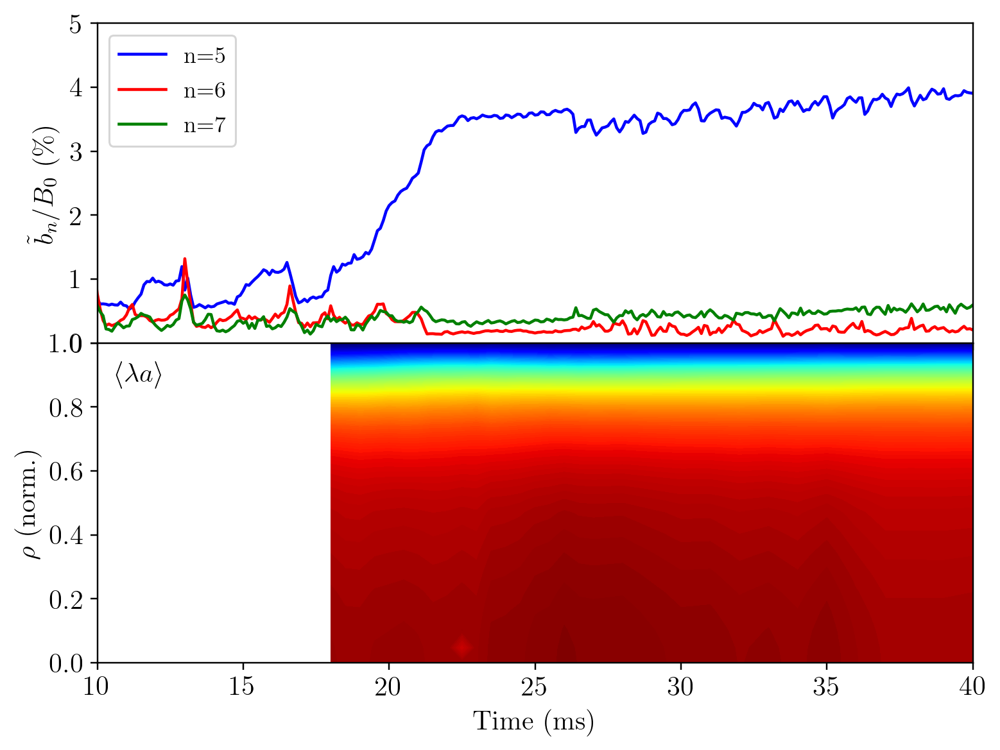

In [356]:
fig, axs = plt.subplots(2,1)
fxr_threshold = 5.0

# Magnetics signals    
b0 = np.sqrt(mags.BP['EQ']**2 + mags.BT['EQ'])
for n,color in zip([5,6,7], ['blue','red','green']):
    key = 'N{0:02d}'.format(n)
    b_n = np.sqrt(mags.BP[key]['Amplitude']**2 + mags.BT[key]['Amplitude'])
    axs[0].plot(mags.Time, b_n / b0 * 100, label='n={0:d}'.format(n), color=color)

axs[0].legend(loc='upper left')
axs[0].set_ylabel(r'$\tilde{b}_n/B_{0}$ (\%)')
axs[0].set_ylim([0,5])

# Current density
axs[1].contourf(times, rhos[:,0], lam_ts, 200, cmap=cm.jet)
axs[1].set_ylabel(r'$\rho$ (norm.)')
text(0.05, 0.9, r'$\langle \lambda a \rangle$', axs[1], fontsize=14)

# Format the axes
for ax in axs[:-1]:
    ax.xaxis.set_ticklabels([])

for ax in axs:
    ax.set_xlim([10, 40])
    
axs[-1].set_xlabel('Time (ms)')
plt.subplots_adjust(wspace=0, hspace=0);

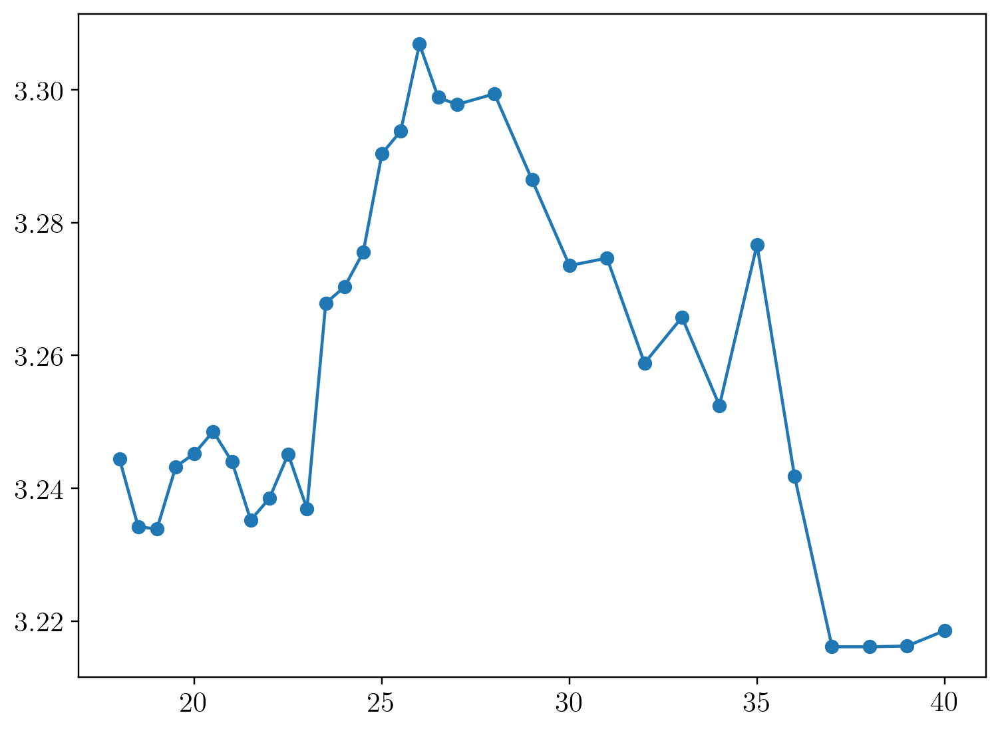

In [346]:
plt.plot(times, lam_ts[0,:], '-o')

Generate a reconstruction plot for each time point in the dataset.

In [365]:
%%capture 
shot = 1200701056
phi0 = 90.0*deg2rad

fdir = '/home/pdvanmeter/plots/sheq'

for time in times:
    fg = get_flux_grid(shot, time, phi=phi0)
    
    fig = plt.figure(figsize=(6,6))
    levels = [0.01, 0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]
    cax = plt.contour(fg.r-R0, fg.z, fg.rho.T, levels=levels, cmap=cm.jet)
    plt.clabel(cax, inline=True, fontsize=9)
    overplot_shell(plt.gca())
    
    plt.xlim([-0.55, 0.55])
    plt.ylim([-0.55, 0.55])
    plt.xlabel(r'$R - R_0$ (m)')
    plt.ylabel(r'$Z$')
    plt.axvline(x=0, linestyle=':', color='black')
    plt.axhline(y=0, linestyle=':', color='black')
    plt.title(r'NCT/SHEq $\rho$, MST \#{0:10d}, $\phi = 90^\circ$ (SXT), $t = {1:.1f}$ ms'.format(shot,time))
    
    fname = 'NCT_SHEq_s{0:10d}_90T_t={1:.1f}.png'.format(shot, time)
    fpath = os.path.join(fdir, fname)
    fig.savefig(fpath)

## Interpolating the reconstructions in time

The goal here is to develop a straightforward framework in order to determine the flux at any point in time based on linear interpolations of the available reconstructions. My guess is that this will take some time to construct, so it is worth saving the result to a pickle file.

In [3]:
%%capture

# Interpolate between two points 
shot = 1200701056
t1 = 24.5
t2 = 25.0
phi0 = 90*deg2rad

fg1 = get_flux_grid(shot, t1, phi=phi0)
fg2 = get_flux_grid(shot, t2, phi=phi0)

In [4]:
# Make the points and values grids for t1
D = 3
N1 = len(fg1.r.ravel())
pts1 = np.stack([fg1.r.ravel(), fg1.z.ravel(), np.ones(N1)*t1], axis=-1)
vals1 = fg1.rho.ravel()

# Make the points and values grids for t2
D = 3
N2 = len(fg2.r.ravel())
pts2 = np.stack([fg2.r.ravel(), fg2.z.ravel(), np.ones(N2)*t2], axis=-1)
vals2 = fg2.rho.ravel()

# Combine into one
pts = np.vstack([pts1, pts2])
vals = np.concatenate([vals1, vals2])

In [ ]:
from mst_ida.models.base.geometry import sunflower_points

xs, ys = sunflower_points(5000)
ts = 24.8
xis = np.stack([xs, ys, np.ones(xs.shape)*ts], axis=-1)
#rhos = sp.interpolate.griddata(pts, vals, xis, method='linear', fill_value=np.nan)

For reasons I do not understand, this does not seem to work. So, an alternative idea is in order. First interpolate the point on the reference grids immediately before and after the desired time point, and then linearly interpolate (weigthed average).

Maybe it does not work because the grid points were out of order? Anyway, I can use the interpolation method I already developed.

In [36]:
%%capture

shot = 1200701056
t1 = 27.0
t2 = 28.0
phi0 = 90*deg2rad

flux1 = get_flux(shot, t1, phis=[phi0], labels=['SXT'])
flux2 = get_flux(shot, t2, phis=[phi0], labels=['SXT'])

In [39]:
xs, ys = sunflower_points(5000)

# Interpolate the intermediate point
ti = 27.45
w1 = 1 - (ti - t1) / (t2 - t1)
w2 = 1 - (t2 - ti) / (t2 - t1)

flux_interp = w1*flux1['SXT'](xs,ys) + w2*flux2['SXT'](xs,ys)

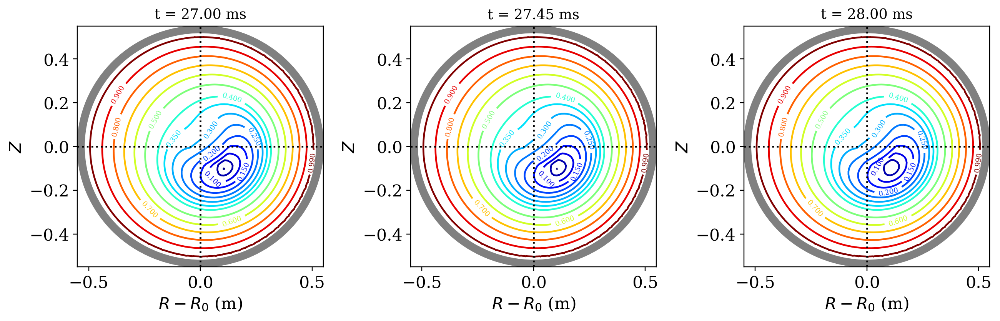

In [43]:
fig, axs = plt.subplots(1,3, figsize=(12,4))
levels = [0.01, 0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 0.99]

cax = axs[0].tricontour(xs, ys, flux1['SXT'](xs,ys), levels=levels, cmap=cm.jet)
axs[0].set_title('t = {0:.2f} ms'.format(t1))
plt.clabel(cax, inline=True, fontsize=6)

cax = axs[1].tricontour(xs, ys, flux_interp, levels=levels, cmap=cm.jet)
axs[1].set_title('t = {0:.2f} ms'.format(ti))
plt.clabel(cax, inline=True, fontsize=6)

cax = axs[2].tricontour(xs, ys, flux2['SXT'](xs,ys), levels=levels, cmap=cm.jet)
axs[2].set_title('t = {0:.2f} ms'.format(t2))
plt.clabel(cax, inline=True, fontsize=6)

for ax in axs:
    overplot_shell(ax)
    ax.set_xlim([-0.55, 0.55])
    ax.set_ylim([-0.55, 0.55])
    ax.set_xlabel(r'$R - R_0$ (m)')
    ax.set_ylabel(r'$Z$')
    ax.axvline(x=0, linestyle=':', color='black')
    ax.axhline(y=0, linestyle=':', color='black')
    
plt.tight_layout()

Now we want to automate this process. This will mean creating (and pickling) an array of the flux interpolation objects and building a function to quickly interpolate between them. I want this to work for several diagnostics (and FIR, which has two views) in particular, so I'll keep that in mind.

In [53]:
%%capture

shot = 1200701056
phis =   [90.0*deg2rad, 255.0*deg2rad, 250.0*deg2rad]
labels = [       'SXT',       'FIR_P',       'FIR_M']

times = np.array([
        18.0, 18.5, 19.0, 19.5, 20.0, 20.5, 21.0, 21.5, 22.0, 22.5, 23.0,
        23.5, 24.0, 24.5, 25.0, 25.5, 26.0, 26.5, 27.0, 28.0, 29.0, 30.0,
        31.0, 32.0, 33.0, 34.0, 35.0, 36.0, 37.0, 38.0, 39.0, 40.0
])

fluxes = []
for t in times:
    fluxes.append( get_flux(shot, t, phis=phis, labels=labels) )

In [55]:
import pickle

fdir = '/home/pdvanmeter/data/sheq/interpolators'
fname = 'rho_interp_s{0:10d}.pkl'.format(shot)
fpath = os.path.join(fdir, fname)

with open(fpath, 'wb') as f:
    pickle.dump(fluxes, f)

In [1315]:
fdir = '/home/pdvanmeter/data/sheq/interpolators'
fname = 'rho_interp_s{0:10d}.pkl'.format(shot)
fpath = os.path.join(fdir, fname)

with open(fpath, 'rb') as f:
    fluxes = pickle.load(f)

In [1316]:
def rho_xy(xs, ys, t, label='SXT'):
    """
    Get value of rho at (x1,y1),(x2,y2),... for at the given time using interpolation.
    """
    # Check if t is exactly in the times array
    if t in times:
        n1 = np.argmin(np.abs(times - t))
        rhos = fluxes[n1][label](xs,ys)
    else:
        t1 = times[times < t].max()
        t2 = times[times > t].min()
        w1 = 1 - (t - t1) / (t2 - t1)
        w2 = 1 - (t2 - t) / (t2 - t1)
        n1 = np.argmin(np.abs(times - t1))
        n2 = np.argmin(np.abs(times - t2))
        rhos = w1*fluxes[n1][label](xs,ys) + w2*fluxes[n2][label](xs,ys)
    return rhos

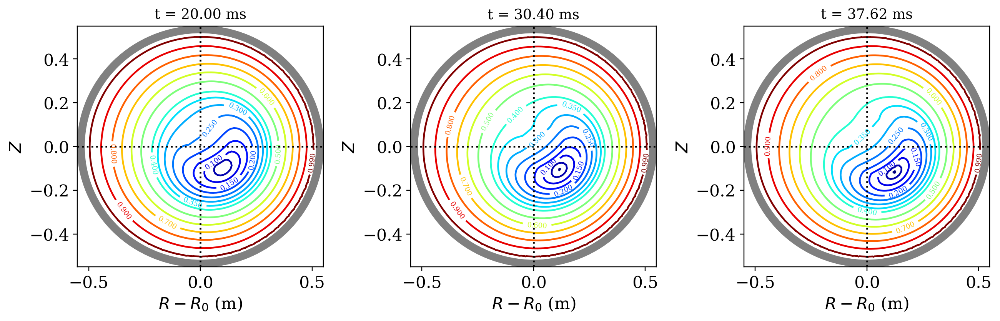

In [1317]:
ts = [20.0, 30.4, 37.62]
xs, ys = sunflower_points(5000)

# Interpolate at 3 random times
fig, axs = plt.subplots(1,3, figsize=(12,4))
levels = [0.01, 0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 0.99]

cax = axs[0].tricontour(xs, ys, rho_xy(xs,ys, ts[0], label='SXT'), levels=levels, cmap=cm.jet)
axs[0].set_title('t = {0:.2f} ms'.format(ts[0]))
plt.clabel(cax, inline=True, fontsize=6)

cax = axs[1].tricontour(xs, ys, rho_xy(xs,ys, ts[1], label='SXT'), levels=levels, cmap=cm.jet)
axs[1].set_title('t = {0:.2f} ms'.format(ts[1]))
plt.clabel(cax, inline=True, fontsize=6)

cax = axs[2].tricontour(xs, ys, rho_xy(xs,ys, ts[2], label='SXT'), levels=levels, cmap=cm.jet)
axs[2].set_title('t = {0:.2f} ms'.format(ts[2]))
plt.clabel(cax, inline=True, fontsize=6)

for ax in axs:
    overplot_shell(ax)
    ax.set_xlim([-0.55, 0.55])
    ax.set_ylim([-0.55, 0.55])
    ax.set_xlabel(r'$R - R_0$ (m)')
    ax.set_ylabel(r'$Z$')
    ax.axvline(x=0, linestyle=':', color='black')
    ax.axhline(y=0, linestyle=':', color='black')
    
plt.tight_layout()

## Density inversion only

To start with, let's consider only the $n_e(\rho)$ profile using FIR data and the SHEq reconstructions. This should help me understand the right kind of profile shapes that will be needed to get good agreement with the data. These calculations can be performed fast, which should allow for some time dynamics.

I'll start with the parameterization discussed in Auriemma _et al._, PPCF, (2011):

$$
    n_e (\rho) = (n_0 - n_1)(1 - \rho^\alpha)^\beta + n_1 (1 - \rho^\gamma)
$$

where $n_0$ is the core density, $n_1$ controls the density near the edge, and $\alpha$, $\beta$, and $\gamma$ are positive integers which control the shape of the profile. I will use a full Bayesian computation in order to examine the influence and correlation of each of these parameters. For now, I will focus on a single time point. Time evolution will come later.

In [1310]:
def ne_prof(rs, n0, n1, alpha, beta, gamma):
    dens = (n0 - n1) * (1 - rs**alpha)**beta + n1 * (1 - rs**gamma)
    return np.maximum(dens, 0.0)

In [1318]:
# Guess parameters
_n0 = 0.6
_n1 = 0.1
_alpha = 5.0
_beta = 4.0
_gamma = 50.0
x0 = [_n0, _n1, _alpha, _beta, _gamma]

# Load in points for a contour map
t = 25.0
xs, ys = sunflower_points(5000)
rs = rho_xy(xs, ys, t, label='FIR_P')
nes = ne_prof(rs, *x0)

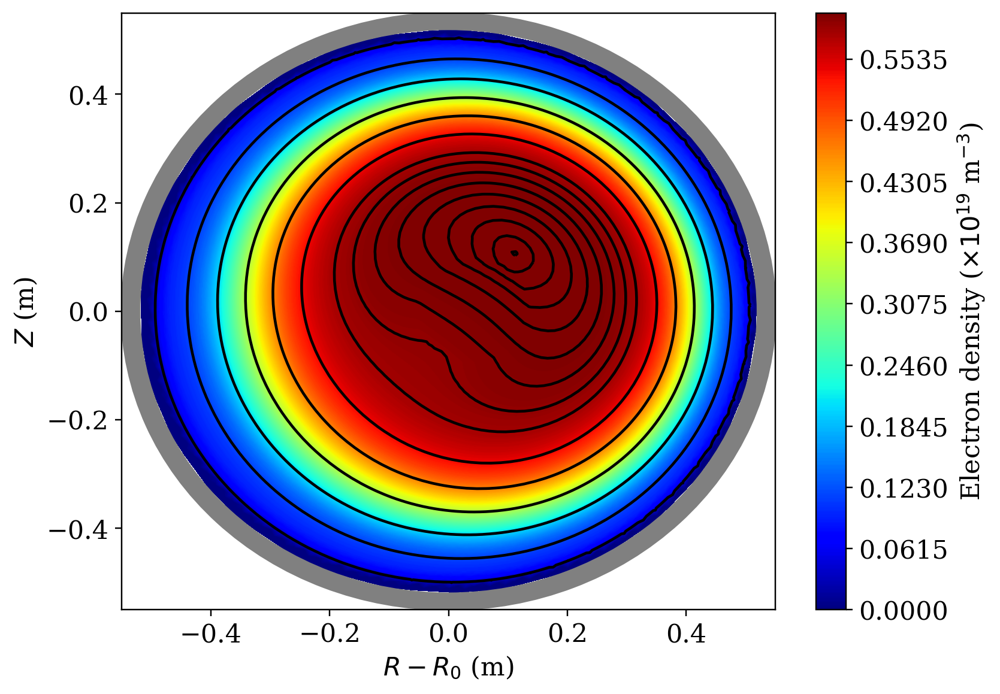

In [89]:
cax1 = plt.tricontourf(xs, ys, nes, 500, cmap=cm.jet)
cb = plt.colorbar(cax1, label=r'Electron density ($\times 10^{19}$ m$^{-3}$)')

# Oveplot flux contours
levels = [0.01, 0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 0.99]
cax2 = plt.tricontour(xs, ys, rhos, levels=levels, colors='black')

plt.xlabel('$R - R_0$ (m)')
plt.ylabel('$Z$ (m)')
overplot_shell(plt.gca())
plt.xlim([-0.55, 0.55])
plt.ylim([-0.55, 0.55]);

In [1325]:
# Now we need a synthetic diagnostic measurement for this geometry - accounting for both toroidal locations
# No need to reinvent the wheel, I can use my existing 3D model for the geometry
from mst_ida.models.fir import FIR_3D

fir_det = FIR_3D()
rs = fir_det.radius

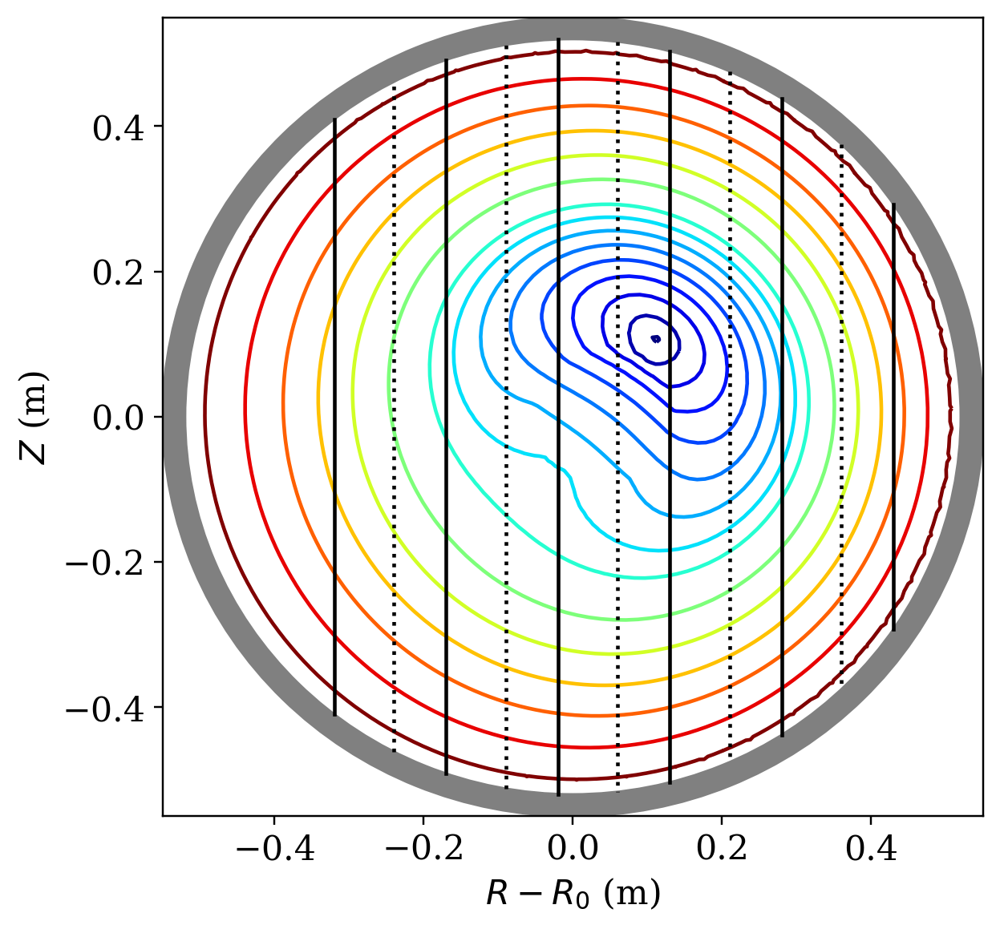

In [100]:
fig = plt.figure(figsize=(6,6))

# Plot flux contours
levels = [0.01, 0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 0.99]
xs, ys = sunflower_points(5000)
rs = rho_xy(xs, ys, t, label='FIR_P')
cax2 = plt.tricontour(xs, ys, rs, levels=levels, cmap=cm.jet)

# Plot the chords
dist = np.zeros(len(fir_det.chords))
for index, chord in enumerate(fir_det.chords):
    a = chord.los.intercept_with_circle(0.52)
    ells = np.linspace(-a, a, num=100)
    xl, yl = chord.los.get_xy(ells)
    
    if fir_det.pluses[index]:
        linestyle='-'
    else:
        linestyle=':'
    plt.plot(xl, yl, color='black', linestyle=linestyle)
    dist[index] = 2*a

plt.xlabel('$R - R_0$ (m)')
plt.ylabel('$Z$ (m)')
overplot_shell(plt.gca())
plt.xlim([-0.55, 0.55])
plt.ylim([-0.55, 0.55]);

In [1319]:
# Build the rho matrix
n_rs = 500
n_chords = len(fir_det.chords)
Rhos = np.zeros([n_rs, n_chords])
Xs = np.zeros([n_rs, n_chords])

for index, chord in enumerate(fir_det.chords):
    a = chord.los.intercept_with_circle(0.52)
    ells = np.linspace(-a, a, num=n_rs)
    xl, yl = chord.los.get_xy(ells)
    
    if fir_det.pluses[index]:
        label = 'FIR_P'
    else:
        label = 'FIR_M'
    
    Rhos[:,index] = rho_xy(xl, yl, t, label=label)
    Xs[:, index] = ells
    
# Build the density matrix
Nes = ne_prof(Rhos, *x0)
dist = np.array([chord.length for chord in fir_det.chords])

# Explicitly limit the Rhos matrix to between 0 and 1
Rhos[Rhos < 0] = 0.0
Rhos[Rhos > 1] = 1.0

In [148]:
# Compare np.trapz vs mean
%timeit ne_avg = np.average(Nes, axis=0)

27.7 µs ± 102 ns per loop (mean ± std. dev. of 7 runs, 10000 loops each)


In [147]:
%timeit ne_trapz = np.array([np.trapz(Nes[:,index], x=Xs[:,index])/dist[index] for index in range(len(fir_det.chords))])

419 µs ± 3.23 µs per loop (mean ± std. dev. of 7 runs, 1000 loops each)


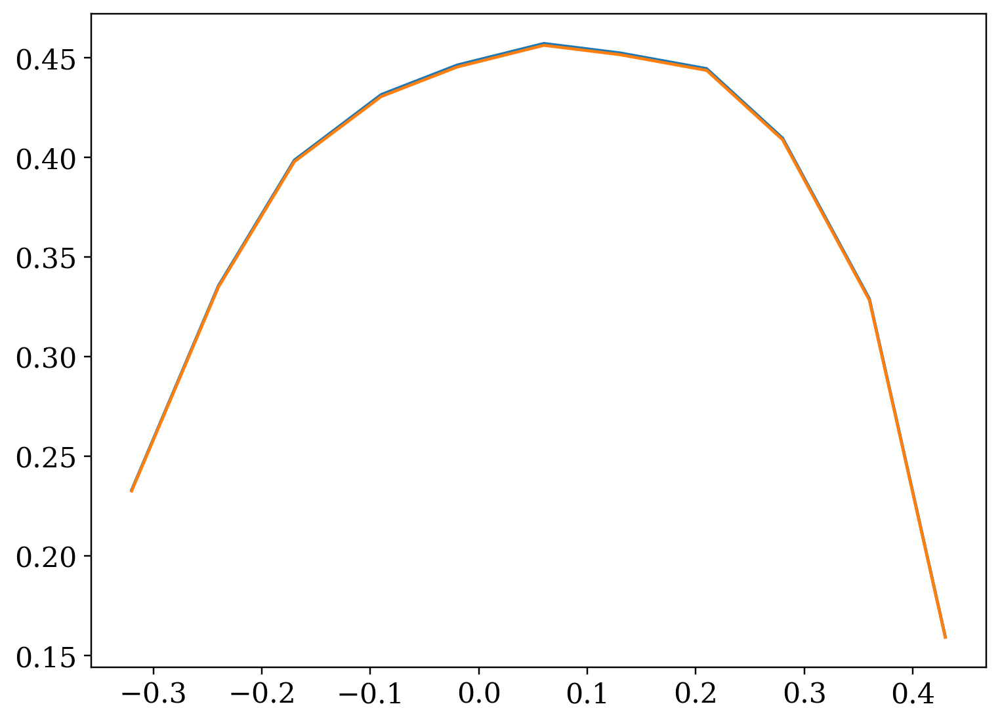

In [146]:
plt.plot(rs, ne_trapz)
plt.plot(rs, ne_avg)

In [1320]:
def get_model(n0, n1, alpha, beta, gamma):
    Nes = ne_prof(Rhos, n0, n1, alpha, beta, gamma)
    return np.average(Nes, axis=0)

In [1321]:
import mst_ida.data.fir as fir

dt = 0.5
fir_data, fir_radius, fir_time = fir.get_fir_signals(shot)
tn0 = np.argmin(np.abs(fir_time - (t - dt/2) ))
tn1 = np.argmin(np.abs(fir_time - (t + dt/2) )) + 1
y_data = np.array([np.average(fir_data[index,tn0:tn1]) for index in range(n_chords)])
y_sigma = np.array([np.std(fir_data[index,tn0:tn1]) for index in range(n_chords)])

In [1322]:
# The model profile
def ne_prof(rs, n0, n1, alpha, beta, gamma=100.):
    dens = (n0 - n1) * (1 - rs**alpha)**beta + n1 * (1 - rs**gamma)
    return np.maximum(dens, 0.0)

# The model function
def get_model(n0, n1, alpha, beta, gamma=100.):
    Nes = ne_prof(Rhos, n0, n1, alpha, beta, gamma=gamma)
    return np.average(Nes, axis=0)

# Define probability functions
def ln_likelihood(theta, gamma=100.):
    y_model = get_model(*theta, gamma=gamma)
    return -0.5*np.sum( (y_data - y_model)**2 / (y_sigma)**2 )

def ln_prior(theta):
    n0, n1, alpha, beta = theta
    prior = (0.2 < n0 < 1.0) *\
            (0.0 < n1 < 0.2) *\
            (1 < alpha < 16) *\
            (1 < beta < 16)
    if prior:
        return 0.0
    else:
        return -np.inf
    
def ln_prob(theta, gamma=100.):
    lp = ln_prior(theta)
    if np.isfinite(lp):
        return lp + ln_likelihood(theta, gamma=gamma)
    else:
        return -np.inf

In [1323]:
from mst_ida.utilities.functions import get_MLE, identify_outliers

x0 = [_n0, _n1, _alpha, _beta]
bounds = [(0.2, 1.0),
          (0.0, 0.2),
          (1.0, 14.0),
          (1.0, 14.0)]
theta0 = get_MLE(ln_likelihood, x0, bounds=bounds)

MLE required 0.3467104434967041 seconds.
      fun: 244.33291813146067
 hess_inv: <4x4 LbfgsInvHessProduct with dtype=float64>
      jac: array([-2.41783481e-02, -1.19058541e-02, -1.35003121e-03, -2.91758202e+00])
  message: b'CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH'
     nfev: 185
      nit: 33
     njev: 37
   status: 0
  success: True
        x: array([ 0.64695903,  0.10839196,  4.93024478, 14.        ])


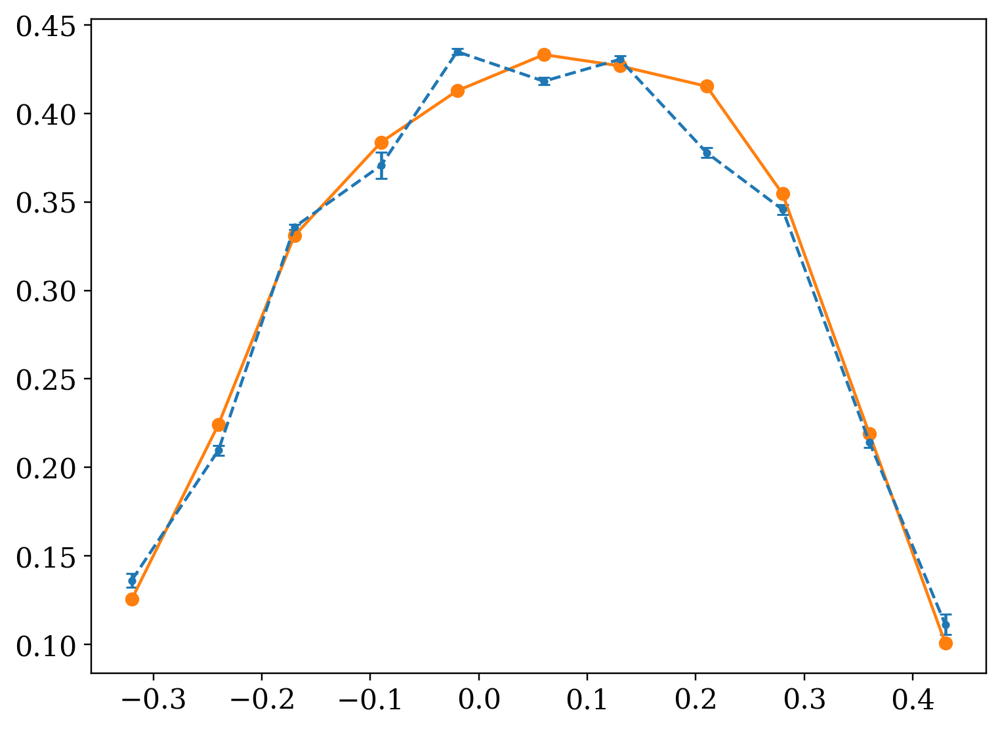

In [1326]:
# Plot the data
plt.errorbar(rs, y_data, yerr=y_sigma, marker='o', ms=3, capsize=3, linestyle='--')

# Plot the model (intial guess)
gamma = 100.
y_model = get_model(*theta0, gamma=gamma)
plt.plot(rs, y_model, '-o')

In [1327]:
import time
import emcee

# Sampling parameters
n_steps = 10000
nwalkers = 50
ndim = len(theta0)

# Generate the initial positions based on the MLE
dim_scale = np.array([0.1, 0.01, 0.5, 0.5])
pos0 = np.zeros([nwalkers, ndim])
for ii in range(nwalkers):
    pos0[ii,:] = theta0 + dim_scale* np.random.randn(ndim)

# Set up the moves strategy - good for lightly multimodal distributions
moves=[(emcee.moves.DEMove(), 0.8), (emcee.moves.DESnookerMove(), 0.2),]
sampler = emcee.EnsembleSampler(nwalkers, ndim, ln_prob, moves=moves, kwargs={'gamma':gamma})

In [1328]:
start = time.time()
sampler.run_mcmc(pos0, 5000, progress=True)
end = time.time()
delta_time = end - start

print("Multiprocessing took {0:.1f} minutes".format(delta_time/60.))

100%|██████████| 5000/5000 [04:31<00:00, 18.42it/s]

Multiprocessing took 4.5 minutes


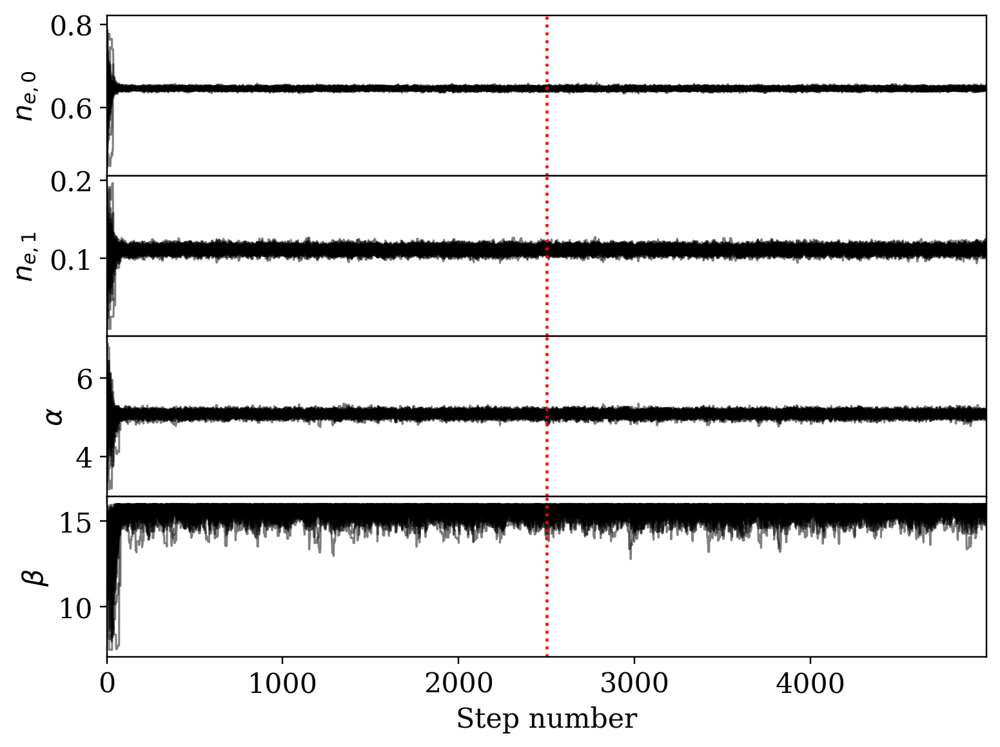

In [1330]:
import mst_ida.analysis.plots as idap

params = [r'$n_{e,0}$', r'$n_{e,1}$', r'$\alpha$', r'$\beta$', '$\gamma$']
burn_step = 2500
fig, ax = idap.burn_plot(sampler.chain, burn_step, nwalkers, indices=range(ndim), labels=params, figsize=(8,6))

In [ ]:
samples = sampler.get_chain(discard=burn_step, flat=True)
#samples = identify_outliers(samples, param=1)
distplot(samples, labels=params)

In [248]:
import mst_ida.analysis.ida as ida

num_samples = 500
num_pts = 100

ys = np.linspace(0, 1, num=num_pts)
ne_samples = np.zeros([num_samples, num_pts])

for index, n in enumerate(np.random.randint(samples.shape[0], size=num_samples)):
    ne_samples[index] = ne_prof(ys, *samples[n,:], gamma=gamma)
    
ne_CI = ida.profile_confidence(ne_samples)

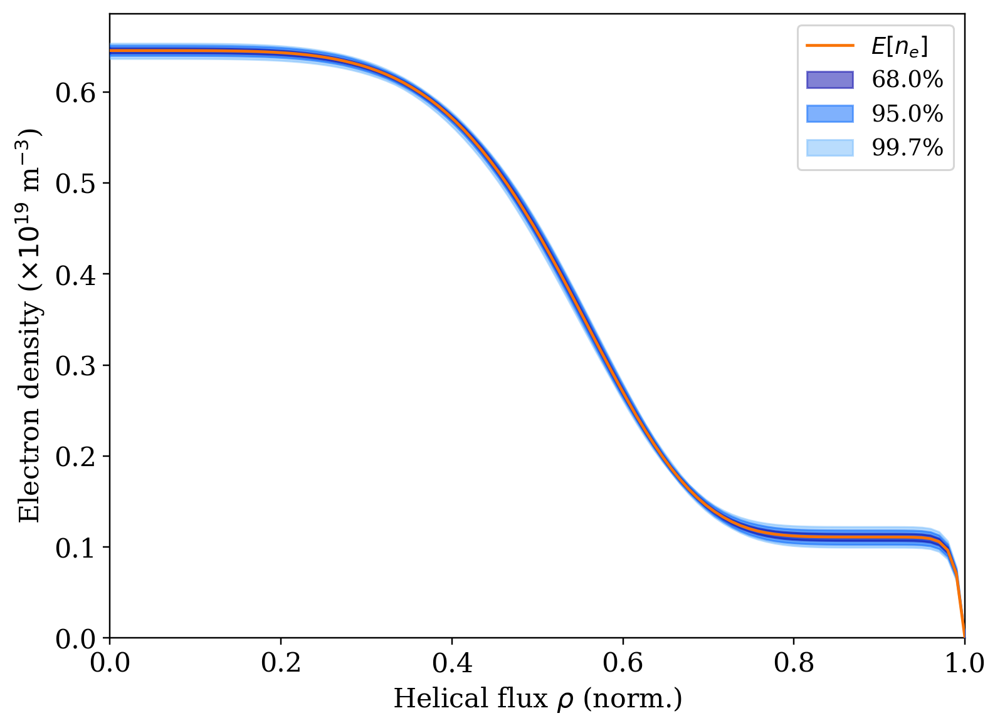

In [261]:
ax = plt.subplot(1,1,1)
idap.profile_CIs(ax, ne_CI, ys, ylim=[0,1], ylabel='$n_e$')

plt.xlabel(r'Helical flux $\rho$ (norm.)')
plt.ylabel(r'Electron density ($\times 10^{19}$ m$^{-3}$)')
plt.xlim([0,1])
plt.ylim([0,None]);

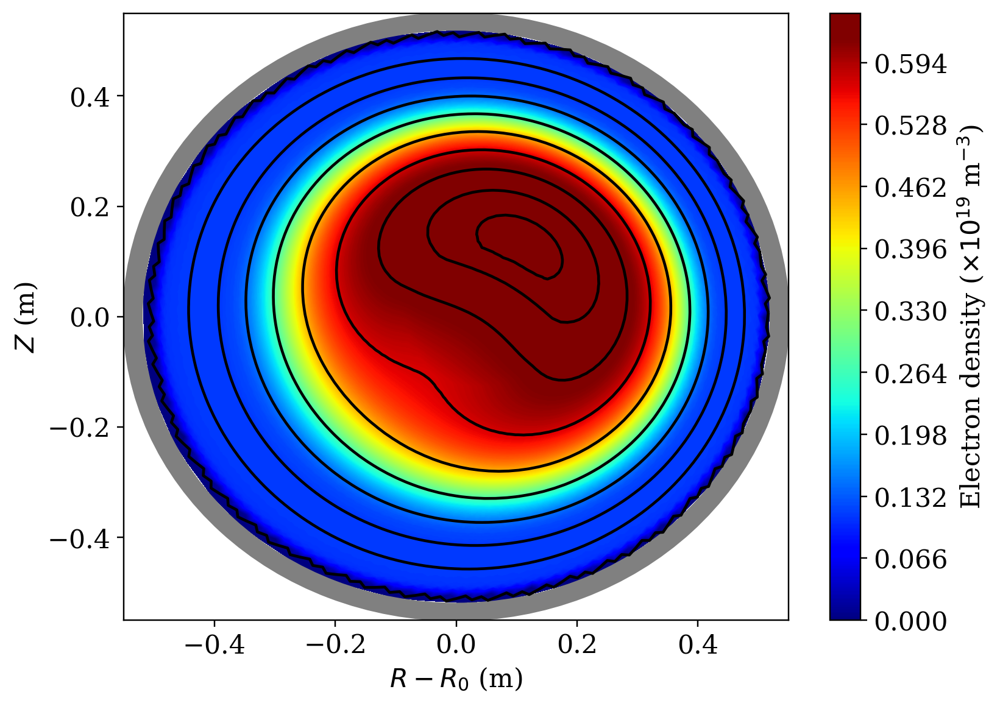

In [334]:
# Plot the contours
theta_avg = np.average(samples, axis=0)

xs, ys = sunflower_points(5000)
rhos = rho_xy(xs, ys, t, label='FIR_P')
rhos[rhos < 0] = 0.0
rhos[rhos > 1] = 1.0
nes = ne_prof(rhos, *theta_avg)

cax1 = plt.tricontourf(xs, ys, nes, 500, cmap=cm.jet, vmin=0, vmax=0.62)
cb = plt.colorbar(cax1, label=r'Electron density ($\times 10^{19}$ m$^{-3}$)')

# Oveplot flux contours
#levels = [0.01, 0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 0.99]
cax2 = plt.tricontour(xs, ys, rhos, 10, colors='black')

plt.xlabel('$R - R_0$ (m)')
plt.ylabel('$Z$ (m)')
overplot_shell(plt.gca())
plt.xlim([-0.55, 0.55])
plt.ylim([-0.55, 0.55]);

In [256]:
# Measurement samples
num_samples = 500
y_samples = np.zeros([num_samples, len(rs)])

for index, n in enumerate(np.random.randint(samples.shape[0], size=num_samples)):
    y_samples[index,:] = get_model(*samples[n,:], gamma=gamma)
    
y_avg = np.average(y_samples, axis=0)

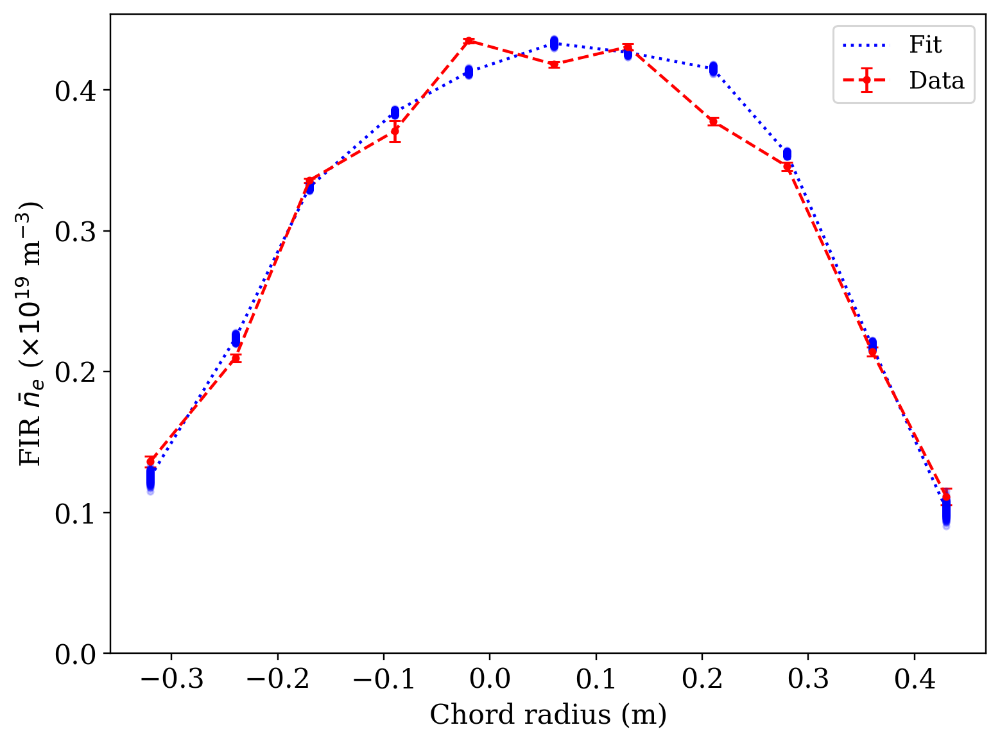

In [259]:
# Plot the data
plt.errorbar(rs, y_data, yerr=y_sigma, marker='o', color='red', ms=3, capsize=3, linestyle='--', label='Data')

for index in range(num_samples):
    plt.plot(rs, y_samples[index,:], linestyle='none', marker='o', ms=3, color='blue', alpha=0.2)
    
plt.plot(rs, y_avg, color='blue', linestyle=':', label='Fit')

plt.legend()
plt.xlabel('Chord radius (m)')
plt.ylabel(r'FIR $\bar{n}_e$ ($\times 10^{19}$ m$^{-3}$)')
plt.ylim([0,None]);

Alright, let's try some time evolution! The idea will be to use the previous these results as the starting point for MLEs. Then, the results from the previous time point will be the starting point for the next time point.

In [265]:
theta_avg = np.average(samples, axis=0)

In [295]:
import mst_ida.data.mst_ops as ops
mags = ops.get_magnetics(shot, t_start=ts[0], t_end=ts[-1], delta_t=0.1, modes=np.arange(1,16))

In [1008]:
def ne_prof(rs, n0, n1, alpha, beta, gamma=100.):
    dens = (n0 - n1) * (1 - rs**alpha)**beta + n1 * (1 - rs**gamma)
    return np.maximum(dens, 0.0)

# The model function
def get_model(Rhos, n0, n1, alpha, beta, gamma=100.):
    Nes = ne_prof(Rhos, n0, n1, alpha, beta, gamma=gamma)
    return np.average(Nes, axis=0)

# Define probability functions
def ln_likelihood(Rhos, theta, gamma=100.):
    y_model = get_model(Rhos, *theta, gamma=gamma)
    return -0.5*np.sum( (y_data - y_model)**2 / (y_sigma)**2 )

In [1010]:
ts = np.arange(20, 40.5, 0.5)
n_rs = 500
gamma = 100.0

# FIR data
dt = 0.5
fir_data, fir_radius, fir_time = fir.get_fir_signals(shot)

# MLE parameters
theta0 = np.array([ 0.64695903,  0.10839196,  4.93024478, 14.        ])
bounds = [(0.2, 1.0),
          (0.0, 0.2),
          (1.0, 14.0),
          (1.0, 14.0)]

# Make the detector object
fir_det = FIR_3D()
rs = fir_det.radius
n_chords = len(fir_det.chords)
labels = ['FIR_P' if fir_det.pluses[index] else 'FIR_M' for index in range(n_chords)]

# Containers for the results
popt_set = np.zeros([len(ts), 4])
cov_set = np.zeros([len(ts), 4, 4])
chi2 = np.zeros(len(ts))
ps = np.linspace(0, 1, num=100)
dens_MLE = np.zeros([len(ts), len(ps)])

for ii,t in enumerate(tqdm(ts)):
    # Load the data
    tn0 = np.argmin(np.abs(fir_time - (t - dt/2) ))
    tn1 = np.argmin(np.abs(fir_time - (t + dt/2) )) + 1
    y_data = np.array([np.average(fir_data[index,tn0:tn1]) for index in range(n_chords)])
    y_sigma = np.array([np.std(fir_data[index,tn0:tn1]) for index in range(n_chords)])
    
    # Set the default MLE
    if ii == 0:
        x0 = theta0
    else:
        x0 = popt_set[ii-1,:]
    
    # Build the Rhos matrix
    Rhos = np.zeros([n_rs, n_chords])
    Xs = np.zeros([n_rs, n_chords])
    for jj, chord in enumerate(fir_det.chords):
        a = chord.los.intercept_with_circle(0.52)
        ells = np.linspace(-a, a, num=n_rs)
        xl, yl = chord.los.get_xy(ells)
        Rhos[:,jj] = rho_xy(xl, yl, t, label=labels[jj])
        Xs[:, jj] = ells

    # Explicitly limit the Rhos matrix to between 0 and 1
    Rhos[Rhos < 0] = 0.0
    Rhos[Rhos > 1] = 1.0
    
    # Use MLE to find the optimal fits
    def get_chi2(theta):
        y_model = get_model(Rhos, *theta, gamma=gamma)
        return np.sum( (y_data - y_model)**2 / (y_sigma)**2 )
    
    func = lambda theta: -0.5*get_chi2(theta)
    params = get_MLE(func, x0, bounds=bounds, verbose=False)
    
    # Generate the profiles
    dens_MLE[ii,:] = ne_prof(ps, *params, gamma=gamma)
    popt_set[ii,:] = params
    chi2[ii] = get_chi2(params)

100%|██████████| 41/41 [00:05<00:00,  7.11it/s]


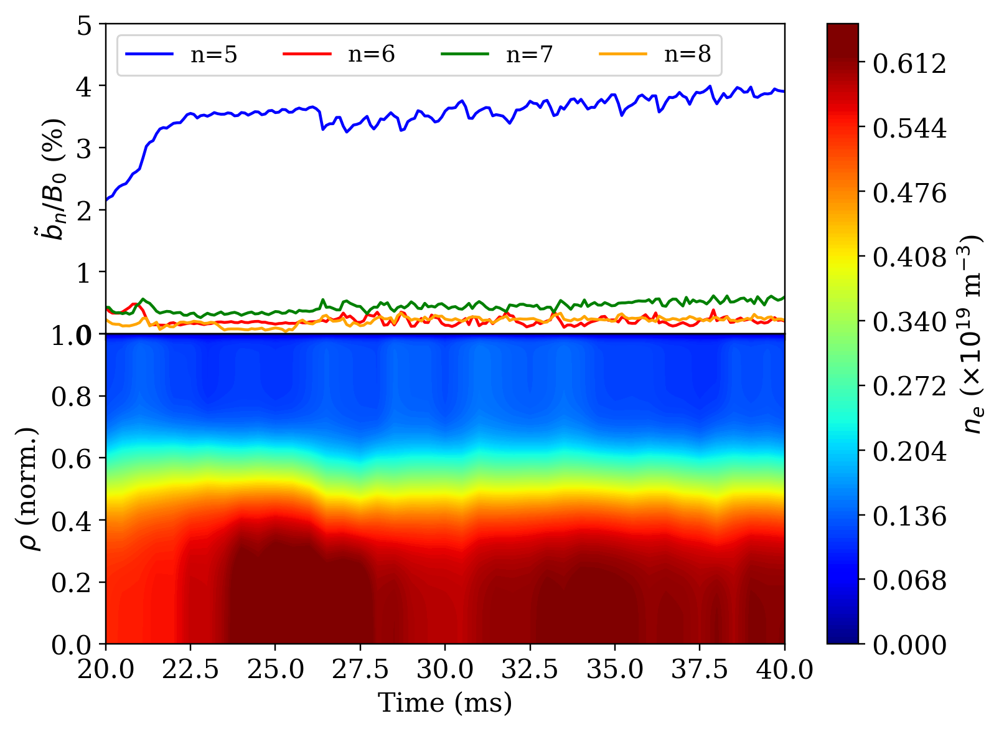

In [1011]:
fig, axs = plt.subplots(2,1)
fxr_threshold = 5.0

# Magnetics signals    
b0 = np.sqrt(mags.BP['EQ']**2 + mags.BT['EQ'])
for n,color in zip([5,6,7,8], ['blue','red','green','orange']):
    key = 'N{0:02d}'.format(n)
    b_n = np.sqrt(mags.BP[key]['Amplitude']**2 + mags.BT[key]['Amplitude'])
    axs[0].plot(mags.Time, b_n / b0 * 100, label='n={0:d}'.format(n), color=color)

axs[0].legend(loc='upper left', ncol=4)
axs[0].set_ylabel(r'$\tilde{b}_n/B_{0}$ (%)')
axs[0].set_ylim([0,5])

# Current density
cax = axs[1].contourf(ts, ps, dens_MLE.T, 200, cmap=cm.jet, vmin=0, vmax=0.62)
axs[1].set_ylabel(r'$\rho$ (norm.)')

# Format the axes
for ax in axs[:-1]:
    ax.xaxis.set_ticklabels([])

for ax in axs:
    ax.set_xlim([ts[0], ts[-1]])
    
axs[-1].set_xlabel('Time (ms)')
plt.subplots_adjust(wspace=0, hspace=0)
fig.colorbar(cax, ax=axs, label=r'$n_e$ ($\times 10^{19}$ m$^{-3}$)');

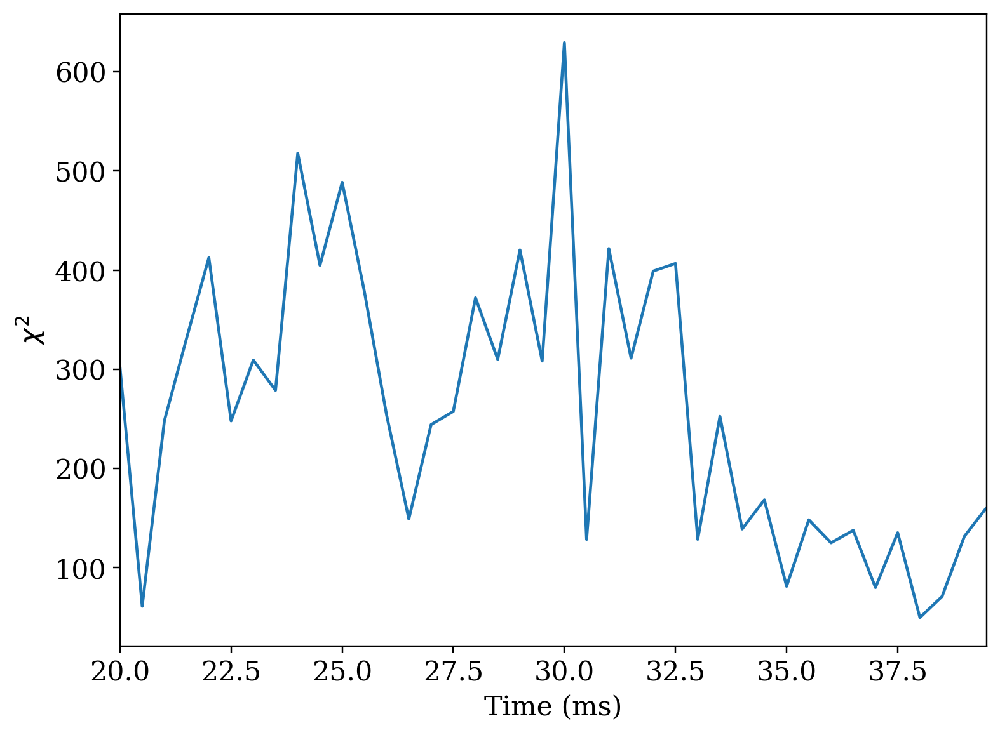

In [343]:
plt.plot(ts, chi2)
plt.xlabel('Time (ms)')
plt.ylabel(r'$\chi^2$')
plt.xlim([ts[0],ts[-2]]);

In [610]:
popt_set_dens = popt_set
chi2_dens = chi2

## Soft X-ray tomography

I want to use the same methodology to map SXR tomo measurements to SHEq surfaces, which can be compared to tomographic inversions. This will give me a feel for which profile functions might best represent the temperature.

To start with I'll use the model used in Auriemma's paper:

$$
    \varepsilon (\rho) = \varepsilon_0 (1 - \rho^\alpha) + \varepsilon_1 \exp{\bigg[-\bigg(\frac{\rho}{\Delta\rho}\bigg)^\beta \bigg]}
$$

In [409]:
from mst_ida.models.sxt import SXT
from mst_ida.data.sxt import load_brightness, invert_brightness, filter_list

# Make the detector model
sxt_det = SXT()
filters = filter_list('thin')
sxt_los = np.concatenate([sxt_det.los[f] for f in filters])
sxt_ps = np.concatenate([sxt_det.p[f] for f in filters])
labels = np.concatenate([[f]*len(sxt_det.los[f]) for f in filters])
n_chords = len(sxt_los)

In [416]:
# Tomography data parameters
t_start = 20.0
t_end = 40.0
delta_t = 0.5
smooth = 10
exclude = [20, 59, 60]
p_ref = [0.08, -0.04, 0.0]

# Load in the tomography data
st = load_brightness(shot, t_start=t_start, t_end=t_end, delta=delta_t, smooth=smooth, exclude=exclude)
tomo = invert_brightness(shot, t_start=t_start, t_end=t_end, delta=delta_t, smooth=smooth, exclude=exclude, thin=True, p_ref=p_ref)

% SXR_MST_BOX_GET_SIGNALS: beginning for shot #1200701056
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO signals in W/m2
% SXR_MST_BOX_GET_SIGNALS: opening MST for shot 1200701056
% Compiled module: WHOAMI.
% Compiled module: FILEBREAK.
% Compiled module: CALC_GEOM_2.
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO time base, Thu Jul 30 15:51:04 2020
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO signals
% SXR_MST_BOX_GET_SIGNALS: assembling bright structure and transposing matrix
% SXR_MST_BOX_GET_SIGNALS: SXRTOMO done
Time=1.8215520 s
% SXR_MST_BOX_GET_SIGNALS: beginning for shot #1200701056
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO signals in W/m2
% SXR_MST_BOX_GET_SIGNALS: opening MST for shot 1200701056
% Compiled module: WHOAMI.
% Compiled module: FILEBREAK.
% Compiled module: CALC_GEOM_2.
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO time base, Thu Jul 30 15:51:06 2020
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO signals
% SXR_MST_BOX_GET_SIGNALS: assembling bright structure and transposing matr

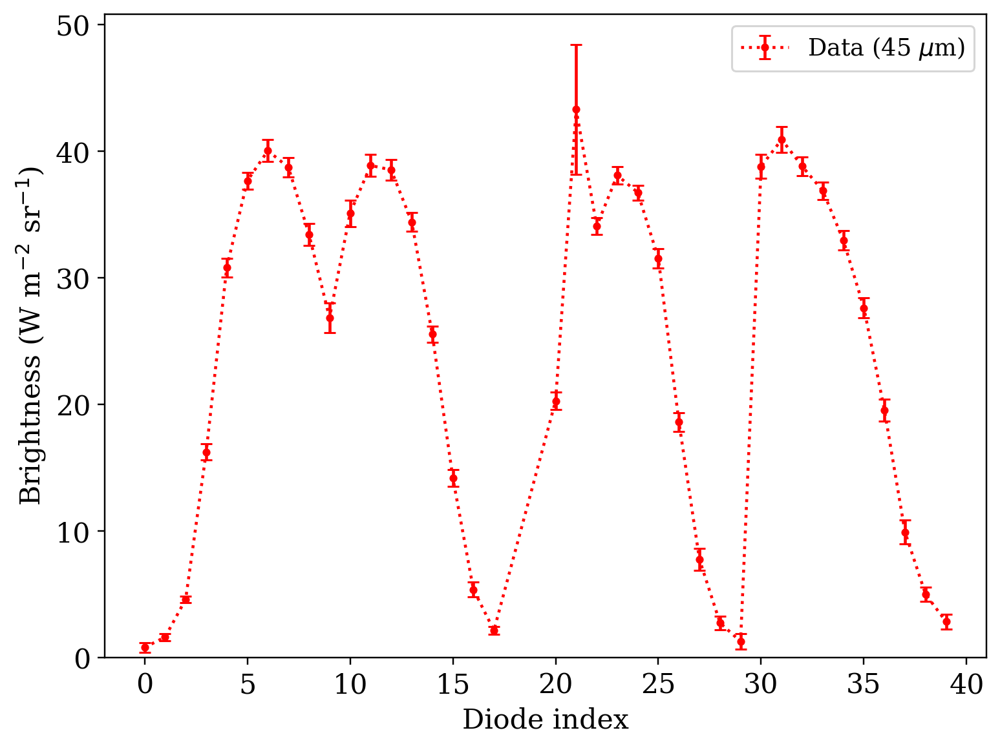

In [384]:
t = 25.0
tn = np.argmin(np.abs(st.time - t))

x_data = np.array([n for n in range(40) if n+41 not in exclude])
y_data = np.concatenate([st.bright[f][:,tn] for f in filters])
y_sigma = np.concatenate([st.sigma[f][:,tn] for f in filters])

plt.errorbar(x_data, y_data, yerr=y_sigma, marker='o', ms=3, capsize=3, linestyle=':', color='red', label=r'Data (45 $\mu$m)')
plt.legend()
plt.xlabel('Diode index')
plt.ylabel(r'Brightness (W m$^{-2}$ sr$^{-1}$)')
plt.ylim([0, None]);

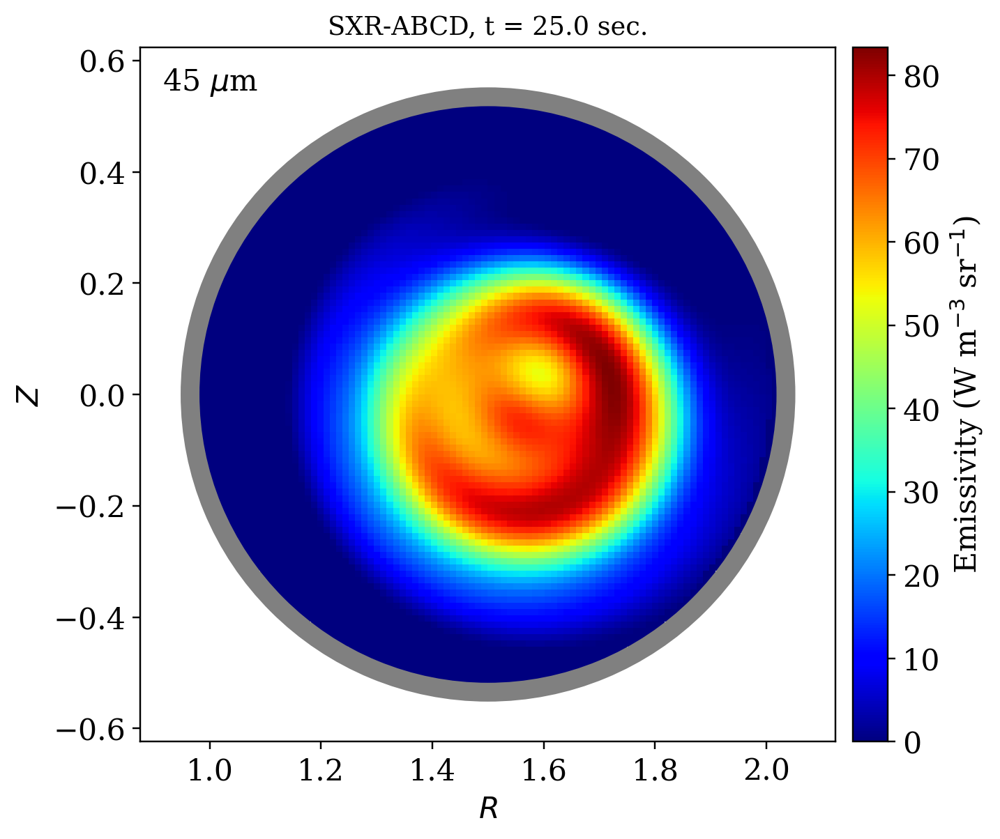

In [417]:
import mst_ida.analysis.tomography as tom

fig, ax = tom.plot_emiss(tomo, tn, label=r'45 $\mu$m', cmap=cm.jet)

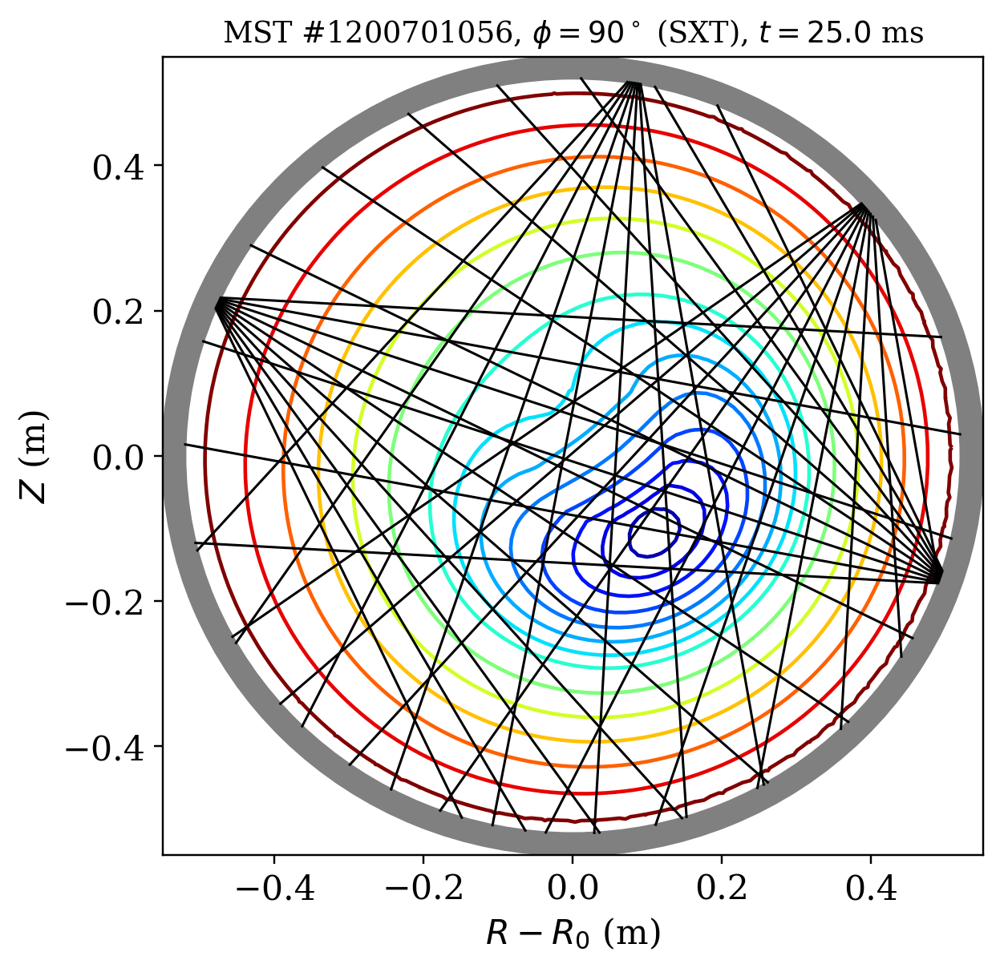

In [489]:
fig = plt.figure(figsize=(6,6))

# Plot flux contours
levels = [0.01, 0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 0.99]
xs, ys = sunflower_points(5000)
rhos = rho_xy(xs, ys, t, label='SXT')
cax2 = plt.tricontour(xs, ys, rhos, levels=levels, cmap=cm.jet)

# Plot the chords
for index, los in enumerate(sxt_los):
    a = los.intercept_with_circle(0.52)
    ells = np.linspace(-a, a, num=100)
    xl, yl = los.get_xy(ells)
    plt.plot(xl, yl, color='black', linestyle='-', linewidth=1)

plt.xlabel('$R - R_0$ (m)')
plt.ylabel('$Z$ (m)')
overplot_shell(plt.gca())
plt.xlim([-0.55, 0.55])
plt.ylim([-0.55, 0.55])
plt.title(r'MST #{0:10d}, $\phi = 90^\circ$ (SXT), $t = {1:.1f}$ ms'.format(shot,t));

In [441]:
_eps0 = 5.0
_eps1 = 75.0
_alpha = 18.0
_beta = 6.0
_dr = 0.4
x0 = np.array([_eps0, _eps1, _alpha, _beta, _dr])

def emiss_prof(rs, eps0, eps1, alpha, beta, dr):
    return eps0 * (1 - rs**alpha) + eps1 * np.exp( -(rs/dr)**beta)

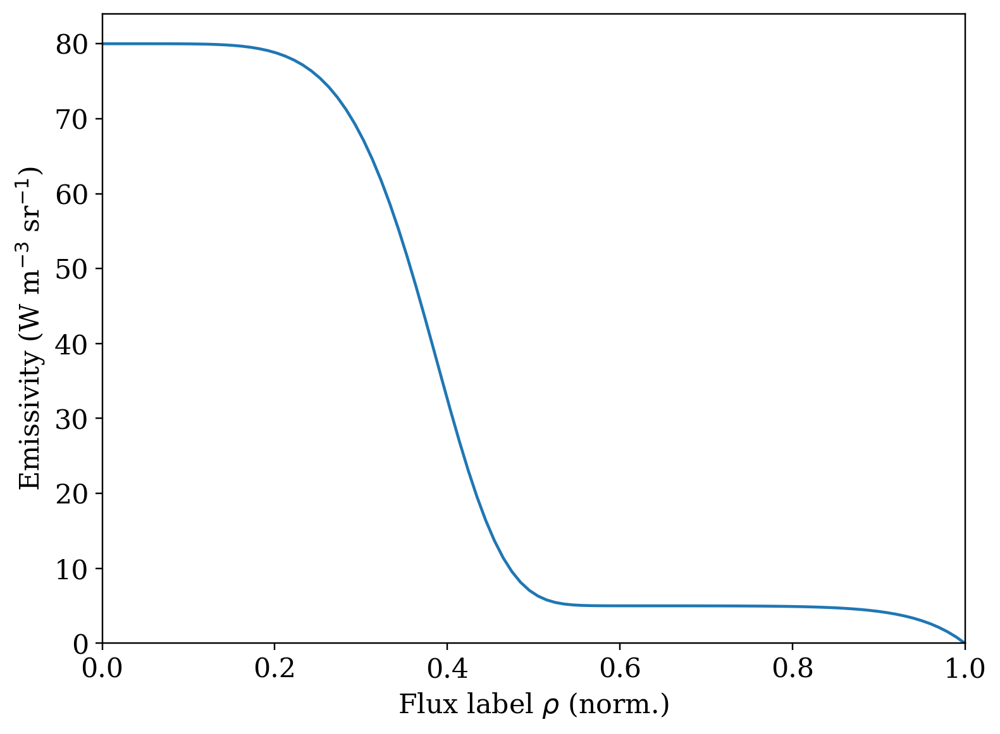

In [496]:
rhos = np.linspace(0, 1, num=100)
plt.plot(rhos, emiss_prof(rhos, *x0))

plt.xlabel(r'Flux label $\rho$ (norm.)')
plt.ylabel(r'Emissivity (W m$^{-3}$ sr$^{-1}$)')
plt.xlim([0,1])
plt.ylim([0,None]);

In [501]:
nrs = 500

# Build the Rhos matrix
Rhos = np.zeros([n_rs, n_chords])
Xs = np.zeros([n_rs, n_chords])
for jj, los in enumerate(sxt_los):
    a = los.intercept_with_circle(0.52)
    ells = np.linspace(-a, a, num=n_rs)
    xl, yl = los.get_xy(ells)
    Rhos[:,jj] = rho_xy(xl, yl, t, label='SXT')
    Xs[:, jj] = ells

# Explicitly limit the Rhos matrix to between 0 and 1
Rhos[Rhos < 0] = 0.0
Rhos[Rhos > 1] = 1.0

# Delta matrix for quick trapezoidal integration
Dx = np.ones(Xs.shape)
Dx[0,:] = Dx[1,:] = 0.5
for j in range(n_chords):
    Dx[:,j] *= Xs[1,j] - Xs[0,j]

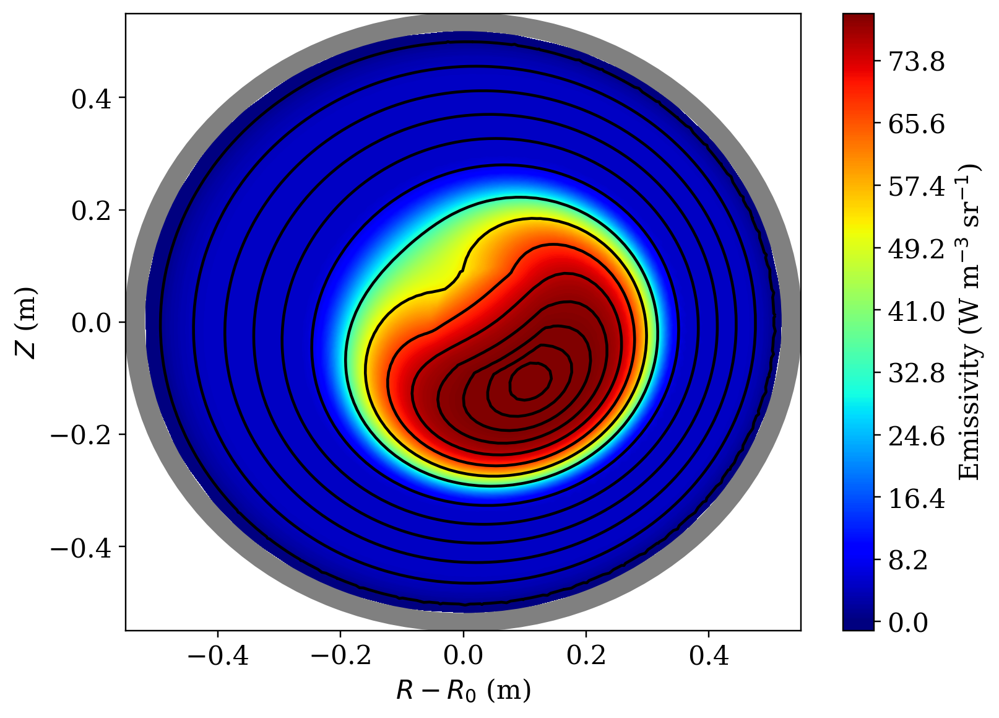

In [444]:
# Load the default profile
xs, ys = sunflower_points(5000)
rs = rho_xy(xs, ys, t, label='SXT')
emiss = emiss_prof(rs, *x0)

# Plot it
cax1 = plt.tricontourf(xs, ys, emiss, 500, cmap=cm.jet, vmax=80, vmin=0)
cb = plt.colorbar(cax1, label=r'Emissivity (W m$^{-3}$ sr$^{-1}$)')

# Oveplot flux contours
xs, ys = sunflower_points(5000)
rhos = rho_xy(xs, ys, t, label='SXT')
levels = [0.01, 0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 0.99]
cax2 = plt.tricontour(xs, ys, rhos, levels=levels, colors='black')

plt.xlabel('$R - R_0$ (m)')
plt.ylabel('$Z$ (m)')
overplot_shell(plt.gca())
plt.xlim([-0.55, 0.55])
plt.ylim([-0.55, 0.55]);

In [502]:
# Synthetic diagnostic
Ems = emiss_prof(Rhos, *x0)
y_model = np.array([np.trapz(Ems[:,index], x=Xs[:,index]) for index in range(n_chords)])
y_model2 = np.sum(Ems*Dx, axis=0)

In [503]:
%timeit y_model = np.array([np.trapz(Ems[:,index], x=Xs[:,index]) for index in range(n_chords)])

1.42 ms ± 1.58 µs per loop (mean ± std. dev. of 7 runs, 1000 loops each)


In [504]:
%timeit y_model2 = np.sum(Ems*Dx, axis=0)

43.9 µs ± 76.2 ns per loop (mean ± std. dev. of 7 runs, 10000 loops each)


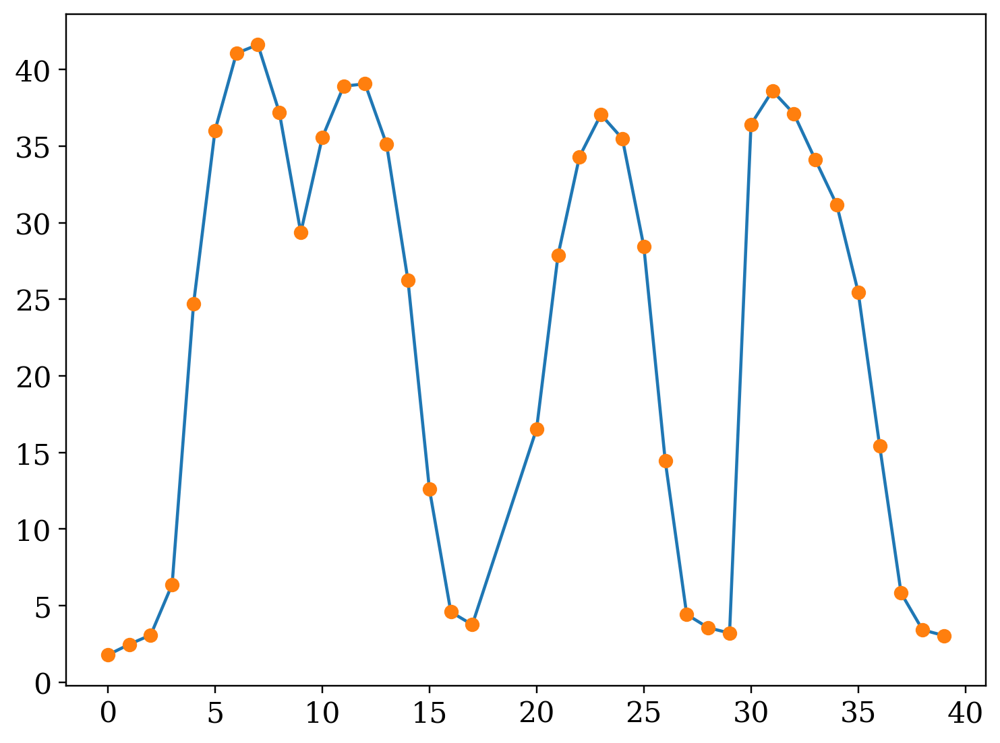

In [507]:
plt.plot(x_data, y_model)
plt.plot(x_data, y_model2, 'o')

In [509]:
print(y_model - y_model2)

[ 1.93178806e-14 -5.55111512e-14 -3.77475828e-14  0.00000000e+00
  2.13162821e-14  4.05009359e-13 -6.89226454e-13 -5.47117907e-13
  8.10018719e-13 -6.64357458e-13  3.41060513e-13 -9.09494702e-13
 -6.60804744e-13 -4.47641924e-13 -2.80664381e-13  4.79616347e-14
  6.03961325e-14 -3.37507799e-14 -2.09610107e-13 -1.27897692e-13
  4.40536496e-13 -2.91322522e-13 -7.53175300e-13 -2.84217094e-14
  1.79412041e-13  3.81916720e-14 -5.15143483e-14  1.33226763e-14
  1.06581410e-13 -7.81597009e-14 -5.96855898e-13  7.10542736e-15
 -1.45661261e-13  1.91846539e-13 -3.37507799e-14  1.95399252e-14
  2.30926389e-14  2.13162821e-14]


The matrix-ified version is clearly superior. It is 100 times faster and agrees to within 1e14.

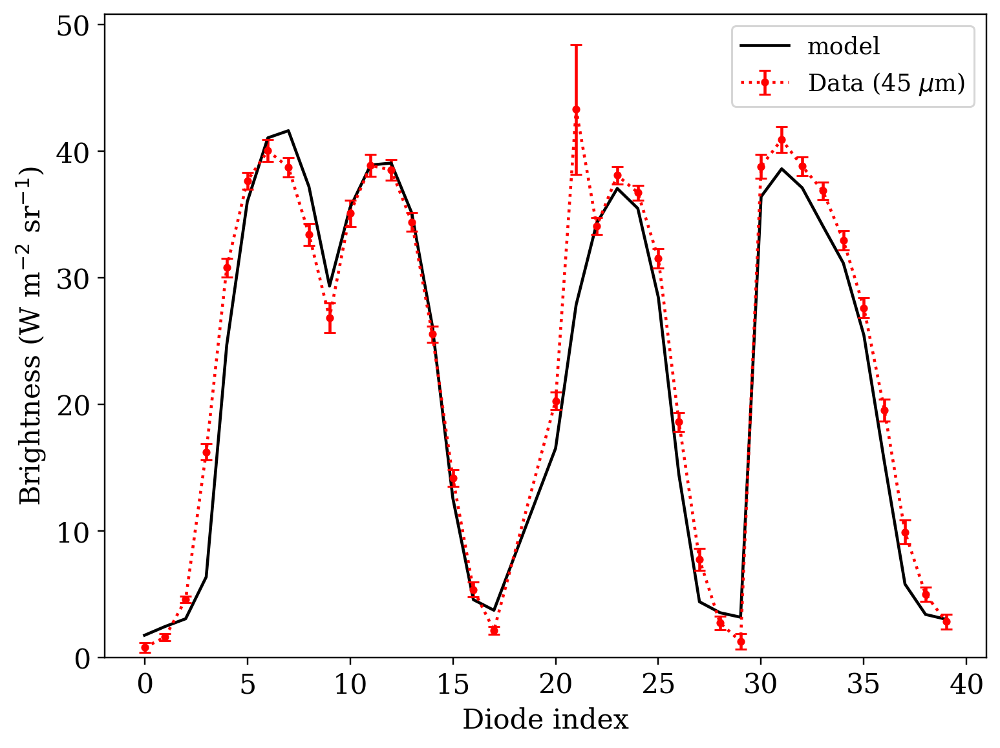

In [511]:
y_model = np.sum(Ems*Dx, axis=0)
plt.plot(x_data, y_model, color='black', label='model')

plt.errorbar(x_data, y_data, yerr=y_sigma, marker='o', ms=3, capsize=3, linestyle=':', color='red', label=r'Data (45 $\mu$m)')
plt.legend()
plt.xlabel('Diode index')
plt.ylabel(r'Brightness (W m$^{-2}$ sr$^{-1}$)')
plt.ylim([0, None]);

In [519]:
# The model profile
def emiss_prof(rs, eps0, eps1, alpha, beta, dr):
    return eps0 * (1 - rs**alpha) + eps1 * np.exp( -(rs/dr)**beta)

# The model function
def get_model(eps0, eps1, alpha, beta, dr):
    Ems = emiss_prof(Rhos, eps0, eps1, alpha, beta, dr)
    return np.sum(Ems*Dx, axis=0)

# Define probability functions
def ln_likelihood(theta):
    y_model = get_model(*theta)
    return -0.5*np.sum( (y_data - y_model)**2 / (y_sigma**2 + (0.02*y_model)**2) )

def ln_prior(theta):
    eps0, eps1, alpha, beta, dr = theta
    prior = (0.0 < eps0 < 5.0) *\
            (5.0 < eps1 < 150.0) *\
            (2 < alpha < 40) *\
            (1 < beta < 16) *\
            (0.1 < dr < 0.6)
    if prior:
        return 0.0
    else:
        return -np.inf
    
def ln_prob(theta):
    lp = ln_prior(theta)
    if np.isfinite(lp):
        return lp + ln_likelihood(theta)
    else:
        return -np.inf

In [520]:
x0 = np.array([_eps0, _eps1, _alpha, _beta, _dr])
bounds = [(0.0, 5.0),
          (5.0, 150.0),
          (2, 40),
          (1, 16),
          (0.1, 0.6)]
theta0 = get_MLE(ln_likelihood, x0, bounds=bounds)

MLE required 0.7064619064331055 seconds.
      fun: 138.65012354830185
 hess_inv: <5x5 LbfgsInvHessProduct with dtype=float64>
      jac: array([ 0.07791527, -0.00416663,  0.00601119, -0.13282033,  1.25755548])
  message: b'CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH'
     nfev: 216
      nit: 31
     njev: 36
   status: 0
  success: True
        x: array([ 2.87086027, 79.45931675, 18.23332376,  3.157298  ,  0.44007737])


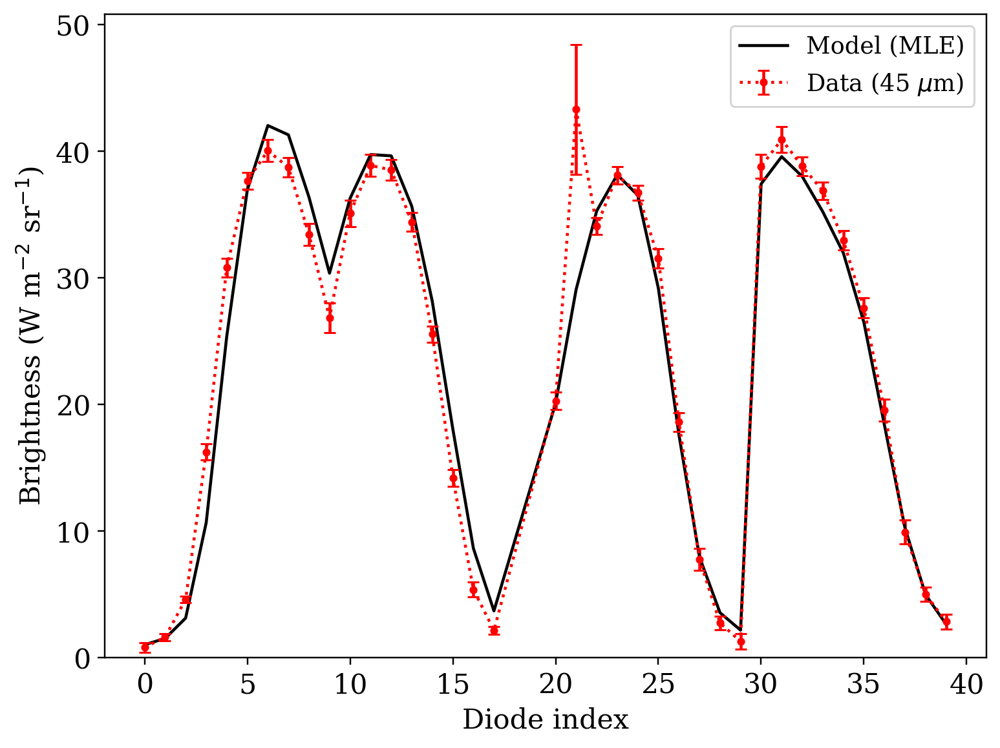

In [521]:
y_model = get_model(*theta0)
plt.plot(x_data, y_model, color='black', label='Model (MLE)')

plt.errorbar(x_data, y_data, yerr=y_sigma, marker='o', ms=3, capsize=3, linestyle=':', color='red', label=r'Data (45 $\mu$m)')
plt.legend()
plt.xlabel('Diode index')
plt.ylabel(r'Brightness (W m$^{-2}$ sr$^{-1}$)')
plt.ylim([0, None]);

In [522]:
# Sampling parameters
n_steps = 10000
nwalkers = 50
ndim = len(theta0)

# Generate the initial positions based on the MLE
dim_scale = np.array([0.1, 5.0, 1.0, 0.5, 0.1])
pos0 = np.zeros([nwalkers, ndim])
for ii in range(nwalkers):
    pos0[ii,:] = theta0 + dim_scale* np.random.randn(ndim)

# Set up the moves strategy - good for lightly multimodal distributions
moves=[(emcee.moves.DEMove(), 0.8), (emcee.moves.DESnookerMove(), 0.2),]
sampler = emcee.EnsembleSampler(nwalkers, ndim, ln_prob, moves=moves)

In [523]:
start = time.time()
sampler.run_mcmc(pos0, 10000, progress=True)
end = time.time()
delta_time = end - start

print("Multiprocessing took {0:.1f} minutes".format(delta_time/60.))

  0%|          | 0/10000 [00:00<?, ?it/s]/home/pdvanmeter/anaconda3/lib/python3.7/site-packages/emcee/moves/red_blue.py:99: RuntimeWarning: invalid value encountered in double_scalars
  lnpdiff = f + nlp - state.log_prob[j]
100%|██████████| 10000/10000 [17:39<00:00,  9.44it/s]

Multiprocessing took 17.7 minutes


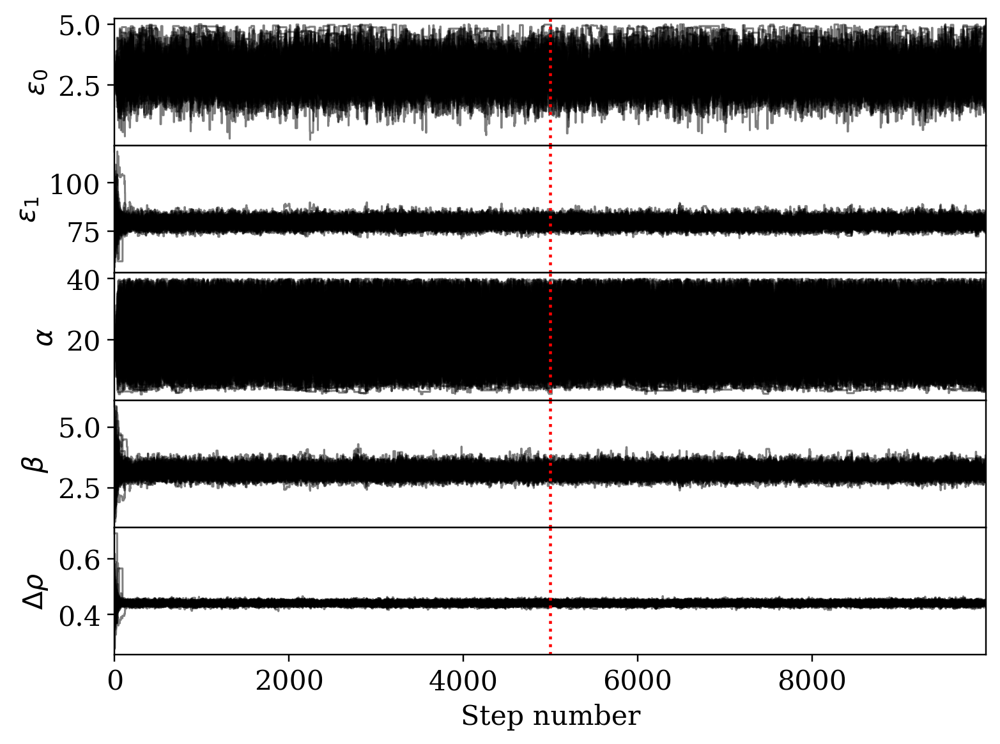

In [611]:
params = [r'$\varepsilon_{0}$', r'$\varepsilon_{1}$', r'$\alpha$', r'$\beta$', r'$\Delta \rho$']
burn_step = 5000
fig, ax = idap.burn_plot(sampler.chain, burn_step, nwalkers, indices=range(ndim), labels=params, figsize=(8,6))

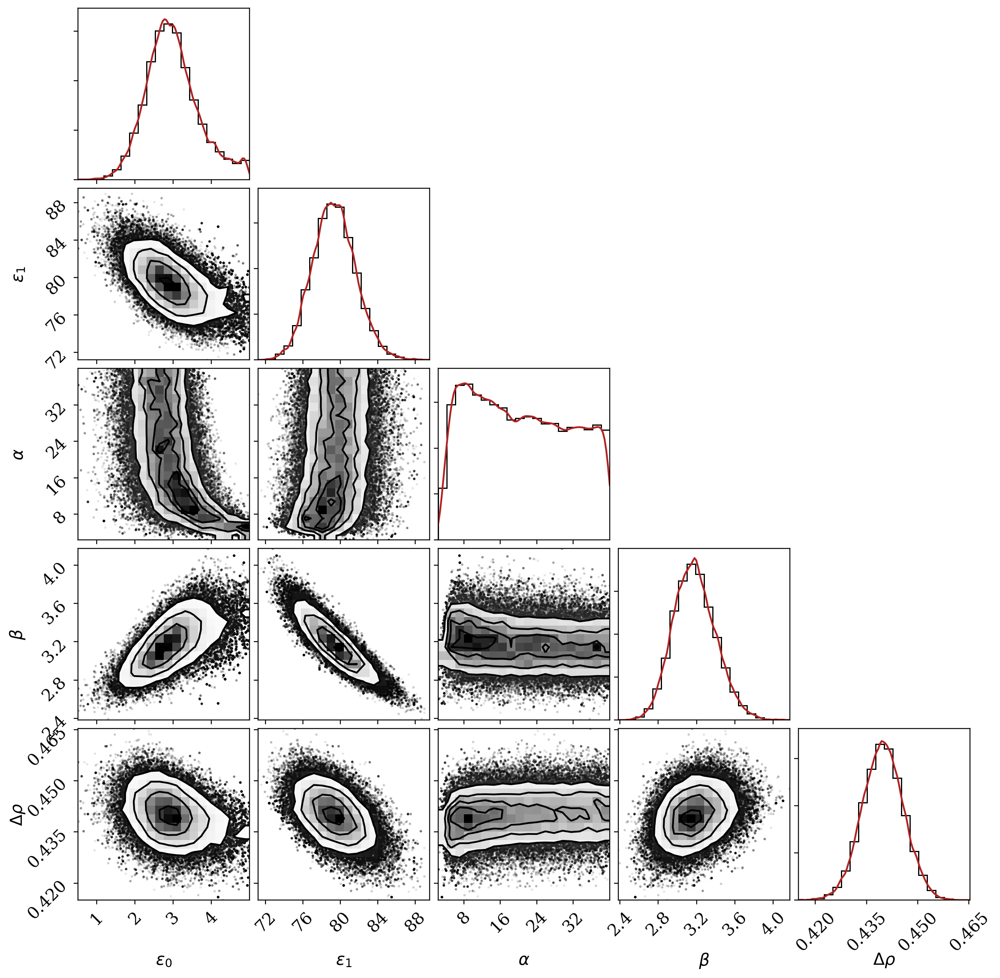

In [612]:
samples = sampler.get_chain(discard=burn_step, flat=True)
distplot(samples, labels=params)

In [528]:
num_samples = 500
num_pts = 100

ys = np.linspace(0, 1, num=num_pts)
emiss_samples = np.zeros([num_samples, num_pts])

for index, n in enumerate(np.random.randint(samples.shape[0], size=num_samples)):
    emiss_samples[index] = emiss_prof(ys, *samples[n,:])
    
emiss_CI = ida.profile_confidence(emiss_samples)

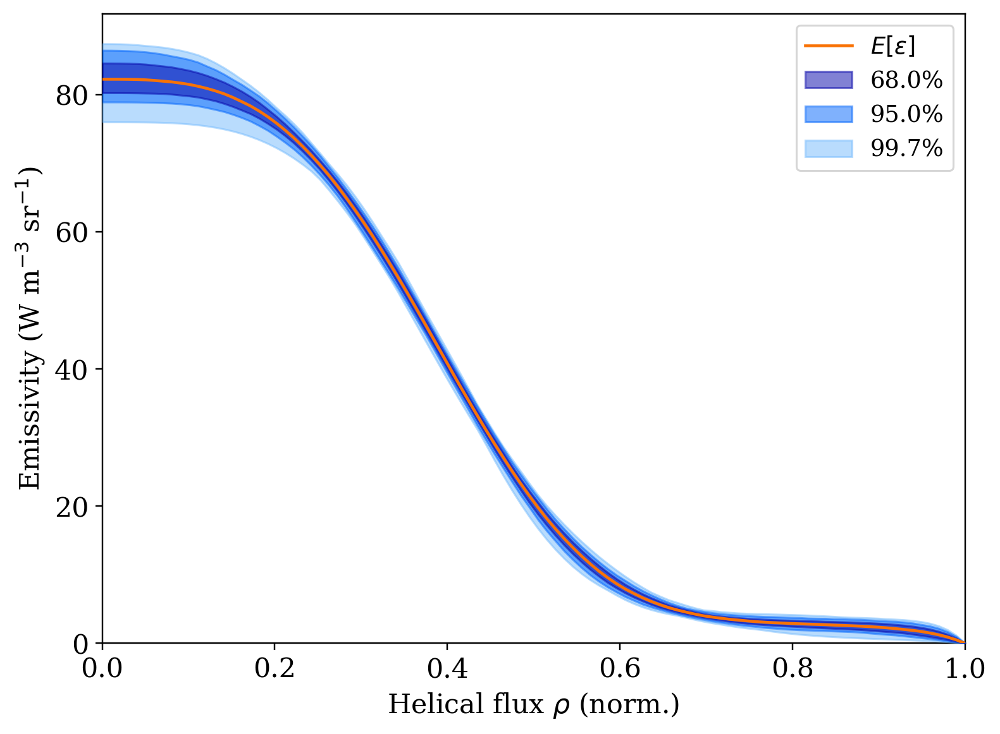

In [532]:
ax = plt.subplot(1,1,1)
idap.profile_CIs(ax, emiss_CI, ys, ylim=[0,1], ylabel=r'$\varepsilon$')

plt.xlabel(r'Helical flux $\rho$ (norm.)')
plt.ylabel(r'Emissivity (W m$^{-3}$ sr$^{-1}$)')
plt.xlim([0,1])
plt.ylim([0,None]);

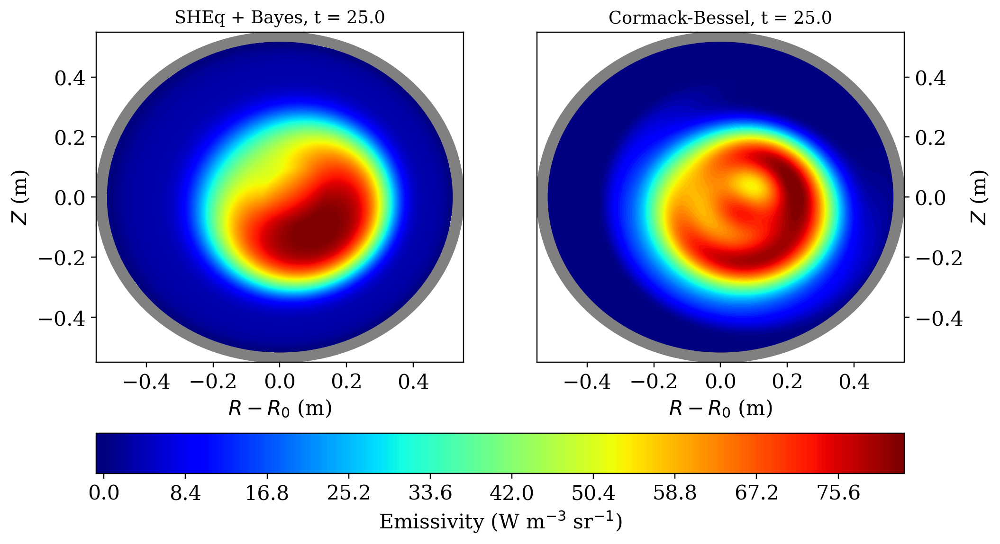

In [547]:
fig, axs = plt.subplots(1, 2, figsize=(10,6))

# Load the default profile
theta_avg = np.average(samples, axis=0)
xs, ys = sunflower_points(5000)
rs = rho_xy(xs, ys, t, label='SXT')
emiss = emiss_prof(rs, *theta_avg)

# SHEq/Bayes
cax1 = axs[0].tricontourf(xs, ys, emiss, 500, cmap=cm.jet, vmax=82, vmin=0)
axs[0].set_title('SHEq + Bayes, t = {0:.1f}'.format(t))

# Tomography
vals = np.copy(tomo.emiss[:,:,tn])
xs = tomo.xs - tomo.major
ys = tomo.ys

for i,x in enumerate(xs):
    for j,y in enumerate(ys):
        if (x**2 + y**2 > 0.53**2):
            vals[i,j] = np.nan

cax = axs[1].contourf(xs, ys, vals.T, 100, cmap=cm.jet, vmax=82, vmin=0)
axs[1].yaxis.tick_right()
axs[1].yaxis.set_label_position("right")
axs[1].set_title('Cormack-Bessel, t = {0:.1f}'.format(t))

# Add the colorbar
cb = fig.colorbar(cax1, ax=axs, label=r'Emissivity (W m$^{-3}$ sr$^{-1}$)', orientation='horizontal')

for ax in axs:
    ax.set_xlabel('$R - R_0$ (m)')
    ax.set_ylabel('$Z$ (m)')
    overplot_shell(ax)
    ax.set_xlim([-0.55, 0.55])
    ax.set_ylim([-0.55, 0.55])

In [548]:
# Measurement samples
num_samples = 500
y_samples = np.zeros([num_samples, len(x_data)])

for index, n in enumerate(np.random.randint(samples.shape[0], size=num_samples)):
    y_samples[index,:] = get_model(*samples[n,:])
    
y_avg = np.average(y_samples, axis=0)

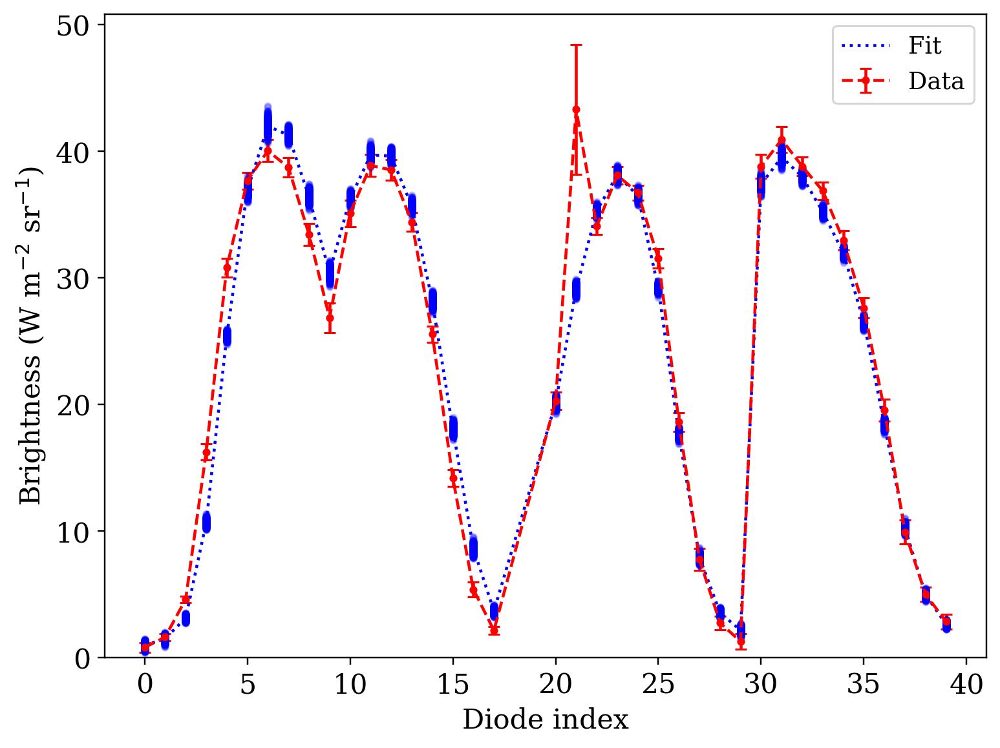

In [551]:
# Plot the data
plt.errorbar(x_data, y_data, yerr=y_sigma, marker='o', color='red', ms=3, capsize=3, linestyle='--', label='Data')

for index in range(num_samples):
    plt.plot(x_data, y_samples[index,:], linestyle='none', marker='o', ms=3, color='blue', alpha=0.2)
    
plt.plot(x_data, y_avg, color='blue', linestyle=':', label='Fit')

plt.legend()
plt.legend()
plt.xlabel('Diode index')
plt.ylabel(r'Brightness (W m$^{-2}$ sr$^{-1}$)')
plt.ylim([0, None]);

In [562]:
# How does this compare to the Cormack-Bessel
xg, yg = np.meshgrid(tomo.xs - tomo.major, tomo.ys, indexing='ij')
sample_coords = list(zip(xg.ravel(), yg.ravel()))
emiss_tomo = Profile_2D_Spline(r'$\rho$', sample_coords, tomo.emiss[:,:,tn].ravel(), units='norm.', dim_units=['m', 'm'],
                               method='linear', boundary=1.0)

y_tomo = np.zeros(y_avg.shape)
for jj, los in enumerate(sxt_los):
    a = los.intercept_with_circle(0.52)
    ells = np.linspace(-a, a, num=n_rs)
    xl, yl = los.get_xy(ells)
    y_tomo[jj] = np.trapz(emiss_tomo(xl,yl), x=ells)

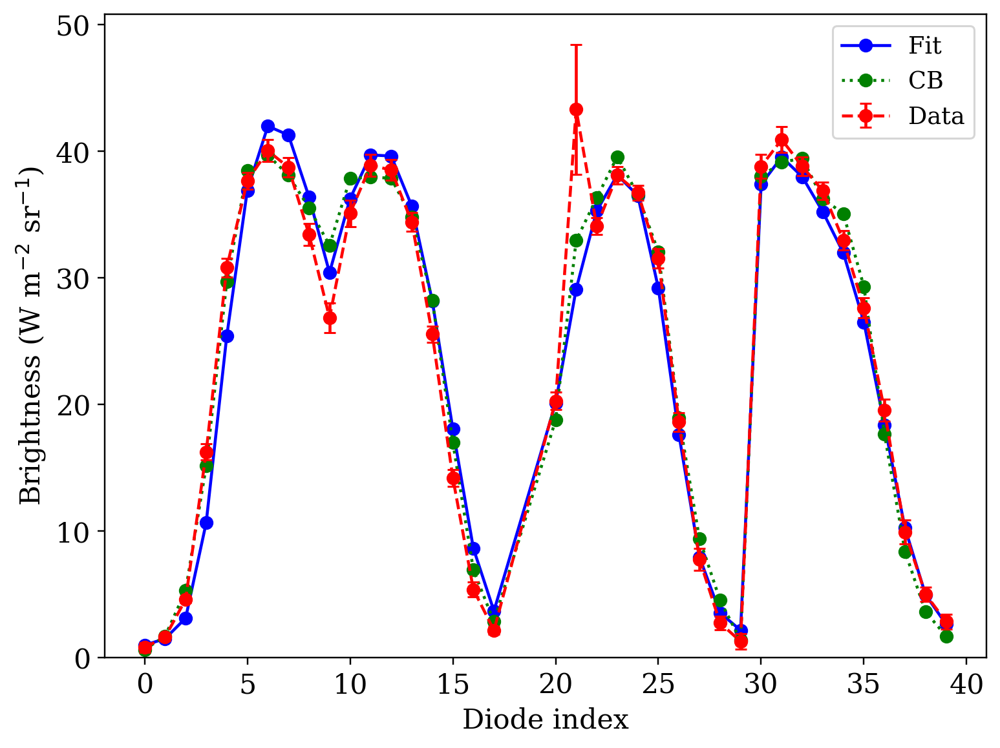

In [567]:
# Plot the data
plt.errorbar(x_data, y_data, yerr=y_sigma, marker='o', color='red', capsize=3, linestyle='--', label='Data', zorder=100)
    
plt.plot(x_data, y_avg, color='blue', linestyle='-', marker='o', label='Fit')
plt.plot(x_data, y_tomo, color='green', linestyle=':',marker='o', label='CB')

plt.legend()
plt.legend()
plt.xlabel('Diode index')
plt.ylabel(r'Brightness (W m$^{-2}$ sr$^{-1}$)')
plt.ylim([0, None]);

In [592]:
chi2_avg = np.sum((y_data - y_avg)**2 / y_sigma**2)
chi2_tomo = np.sum((y_data - y_tomo)**2 / y_sigma**2)

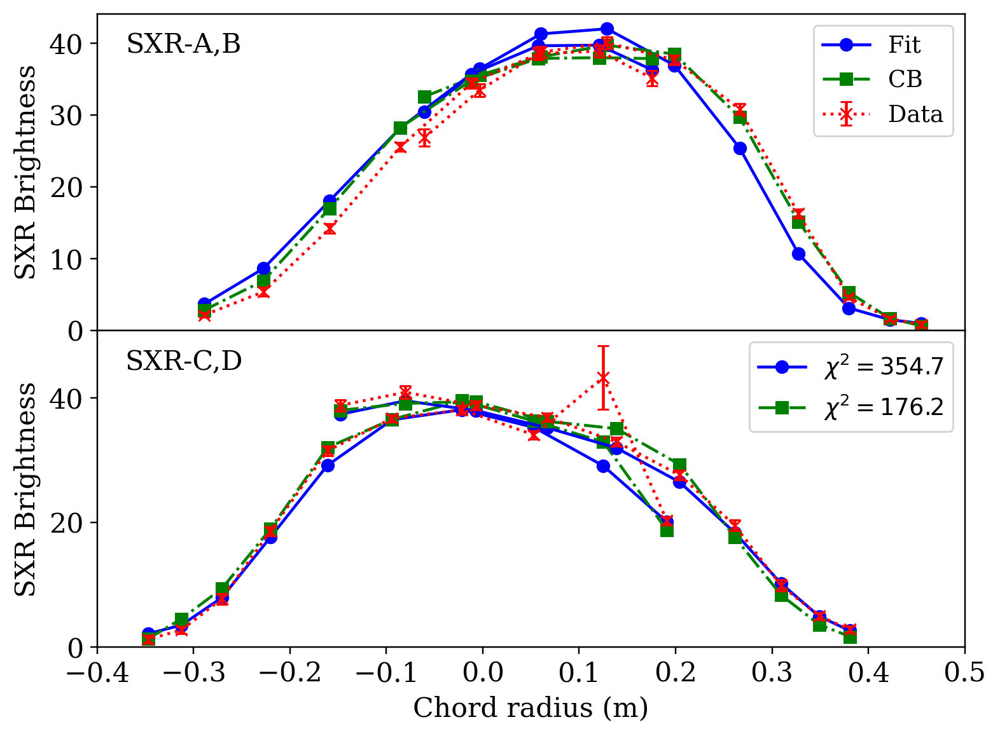

In [605]:
# Use labels to plot more physically
fig, axs = plt.subplots(2,1)

# SXR-A,B
ii, = np.where(labels == 'A thin')
axs[0].errorbar(sxt_ps[ii], y_data[ii], yerr=y_sigma[ii], marker='x', color='red', capsize=3, linestyle=':', label='Data', zorder=100)
axs[0].plot(sxt_ps[ii], y_avg[ii], color='blue', linestyle='-', marker='o', label='Fit')
axs[0].plot(sxt_ps[ii], y_tomo[ii], color='green', linestyle='-.',marker='s', label='CB')

ii, = np.where(labels == 'B thin')
axs[0].errorbar(sxt_ps[ii], y_data[ii], yerr=y_sigma[ii], marker='x', color='red', capsize=3, linestyle=':', zorder=100)
axs[0].plot(sxt_ps[ii], y_avg[ii], color='blue', linestyle='-', marker='o')
axs[0].plot(sxt_ps[ii], y_tomo[ii], color='green', linestyle='-.',marker='s')

# SXR-C,D
ii, = np.where(labels == 'C thin')
axs[1].errorbar(sxt_ps[ii], y_data[ii], yerr=y_sigma[ii], marker='x', color='red', capsize=3, linestyle=':', zorder=100)
axs[1].plot(sxt_ps[ii], y_avg[ii], color='blue', linestyle='-', marker='o', label=r'$\chi^2 = {0:.1f}$'.format(chi2_avg))
axs[1].plot(sxt_ps[ii], y_tomo[ii], color='green', linestyle='-.',marker='s', label=r'$\chi^2 = {0:.1f}$'.format(chi2_tomo))

ii, = np.where(labels == 'D thin')
axs[1].errorbar(sxt_ps[ii], y_data[ii], yerr=y_sigma[ii], marker='x', color='red', capsize=3, linestyle=':', zorder=100)
axs[1].plot(sxt_ps[ii], y_avg[ii], color='blue', linestyle='-', marker='o')
axs[1].plot(sxt_ps[ii], y_tomo[ii], color='green', linestyle='-.',marker='s')

# Add labels
text(0.1, 0.9, 'SXR-A,B', axs[0], fontsize=14)
text(0.1, 0.9, 'SXR-C,D', axs[1], fontsize=14)

# Format the axes
axs[0].legend()
axs[1].legend()
axs[0].xaxis.set_ticklabels([])

for ax in axs:
    ax.set_xlim([-0.4, 0.5])
    ax.set_ylim([0,None])
    ax.set_ylabel('SXR Brightness')

axs[-1].set_xlabel('Chord radius (m)')
plt.subplots_adjust(wspace=0, hspace=0);

Next, time evolution.

In [614]:
# The model profile
def emiss_prof(rs, eps0, eps1, alpha, beta, dr):
    return eps0 * (1 - rs**alpha) + eps1 * np.exp( -(rs/dr)**beta)

# The model function
def get_model(Rhos, Dx, eps0, eps1, alpha, beta, dr):
    Ems = emiss_prof(Rhos, eps0, eps1, alpha, beta, dr)
    return np.sum(Ems*Dx, axis=0)

In [617]:
ts = np.arange(20, 40.5, 0.5)
n_rs = 500
theta0 = theta_avg

# MLE parameters
theta0 = theta_avg
bounds = [(0.0, 5.0),
          (5.0, 150.0),
          (2, 40),
          (1, 16),
          (0.1, 0.6)]

# Make the detector object
sxt_det = SXT()
filters = filter_list('thin')
sxt_los = np.concatenate([sxt_det.los[f] for f in filters])
sxt_ps = np.concatenate([sxt_det.p[f] for f in filters])
labels = np.concatenate([[f]*len(sxt_det.los[f]) for f in filters])
n_chords = len(sxt_los)

# Containers for the results
n_params = len(theta0)
popt_set = np.zeros([len(ts), n_params])
cov_set = np.zeros([len(ts), n_params, n_params])
chi2 = np.zeros(len(ts))
ps = np.linspace(0, 1, num=100)
emiss_MLE = np.zeros([len(ts), len(ps)])

for ii,t in enumerate(tqdm(ts)):
    # Load the data
    tn = np.argmin(np.abs(st.time - t))
    x_data = np.array([n for n in range(40) if n+41 not in exclude])
    y_data = np.concatenate([st.bright[f][:,tn] for f in filters])
    y_sigma = np.concatenate([st.sigma[f][:,tn] for f in filters])
    
    # Set the default MLE
    if ii == 0:
        x0 = theta0
    else:
        x0 = popt_set[ii-1,:]
    
    # Build the Rhos matrix
    Rhos = np.zeros([n_rs, n_chords])
    Xs = np.zeros([n_rs, n_chords])
    for jj, los in enumerate(sxt_los):
        a = los.intercept_with_circle(0.52)
        ells = np.linspace(-a, a, num=n_rs)
        xl, yl = los.get_xy(ells)
        Rhos[:,jj] = rho_xy(xl, yl, t, label='SXT')
        Xs[:, jj] = ells

    # Explicitly limit the Rhos matrix to between 0 and 1
    Rhos[Rhos < 0] = 0.0
    Rhos[Rhos > 1] = 1.0

    # Delta matrix for quick trapezoidal integration
    Dx = np.ones(Xs.shape)
    Dx[0,:] = Dx[1,:] = 0.5
    for j in range(n_chords):
        Dx[:,j] *= Xs[1,j] - Xs[0,j]
    
    # Use MLE to find the optimal fits
    def get_chi2(theta):
        y_model = get_model(Rhos, Dx, *theta)
        return np.sum( (y_data - y_model)**2 / (y_sigma)**2 )
    
    func = lambda theta: -0.5*get_chi2(theta)
    params = get_MLE(func, x0, bounds=bounds, verbose=False)
    
    # Generate the profiles
    emiss_MLE[ii,:] = emiss_prof(ps, *params)
    popt_set[ii,:] = params
    chi2[ii] = get_chi2(params)

100%|██████████| 41/41 [07:14<00:00, 10.59s/it]


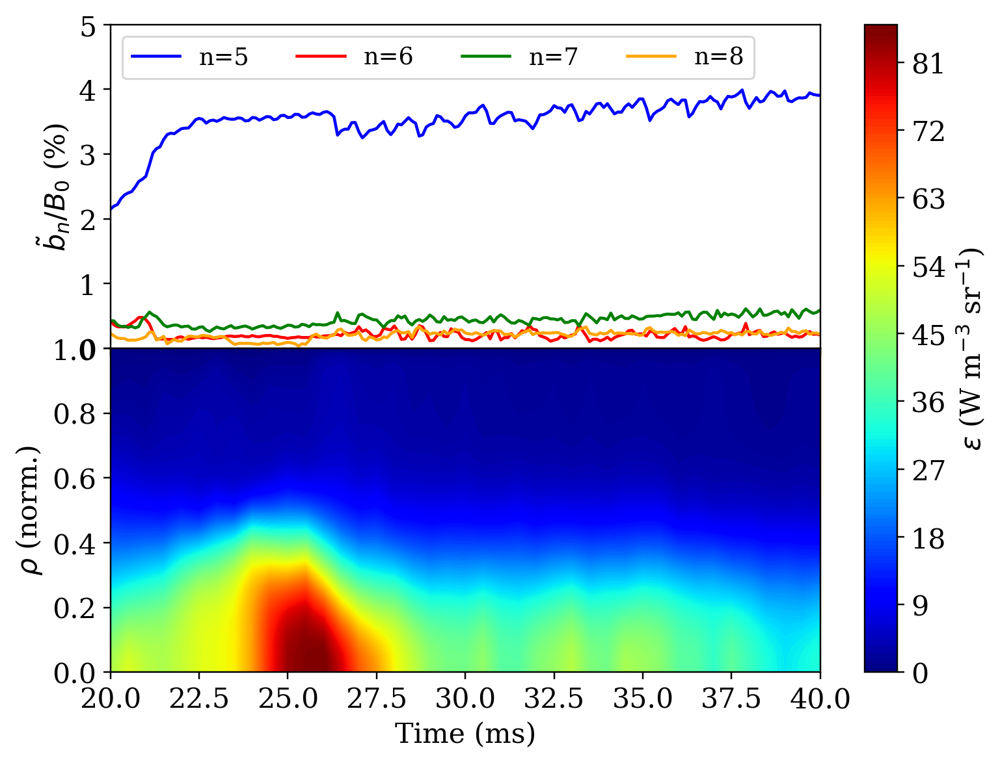

In [637]:
fig, axs = plt.subplots(2,1)

# Magnetics signals    
b0 = np.sqrt(mags.BP['EQ']**2 + mags.BT['EQ'])
for n,color in zip([5,6,7,8], ['blue','red','green','orange']):
    key = 'N{0:02d}'.format(n)
    b_n = np.sqrt(mags.BP[key]['Amplitude']**2 + mags.BT[key]['Amplitude'])
    axs[0].plot(mags.Time, b_n / b0 * 100, label='n={0:d}'.format(n), color=color)

axs[0].legend(loc='upper left', ncol=4)
axs[0].set_ylabel(r'$\tilde{b}_n/B_{0}$ (%)')
axs[0].set_ylim([0,5])

# Emissivity
cax = axs[1].contourf(ts, ps, emiss_MLE.T, 200, cmap=cm.jet, vmin=0, vmax=85)
axs[1].set_ylabel(r'$\rho$ (norm.)')

# Format the axes
for ax in axs[:-1]:
    ax.xaxis.set_ticklabels([])

for ax in axs:
    ax.set_xlim([ts[0], ts[-1]])
    
axs[-1].set_xlabel('Time (ms)')
plt.subplots_adjust(wspace=0, hspace=0)
fig.colorbar(cax, ax=axs, label=r'$\varepsilon$ (W m$^{-3}$ sr$^{-1}$)');

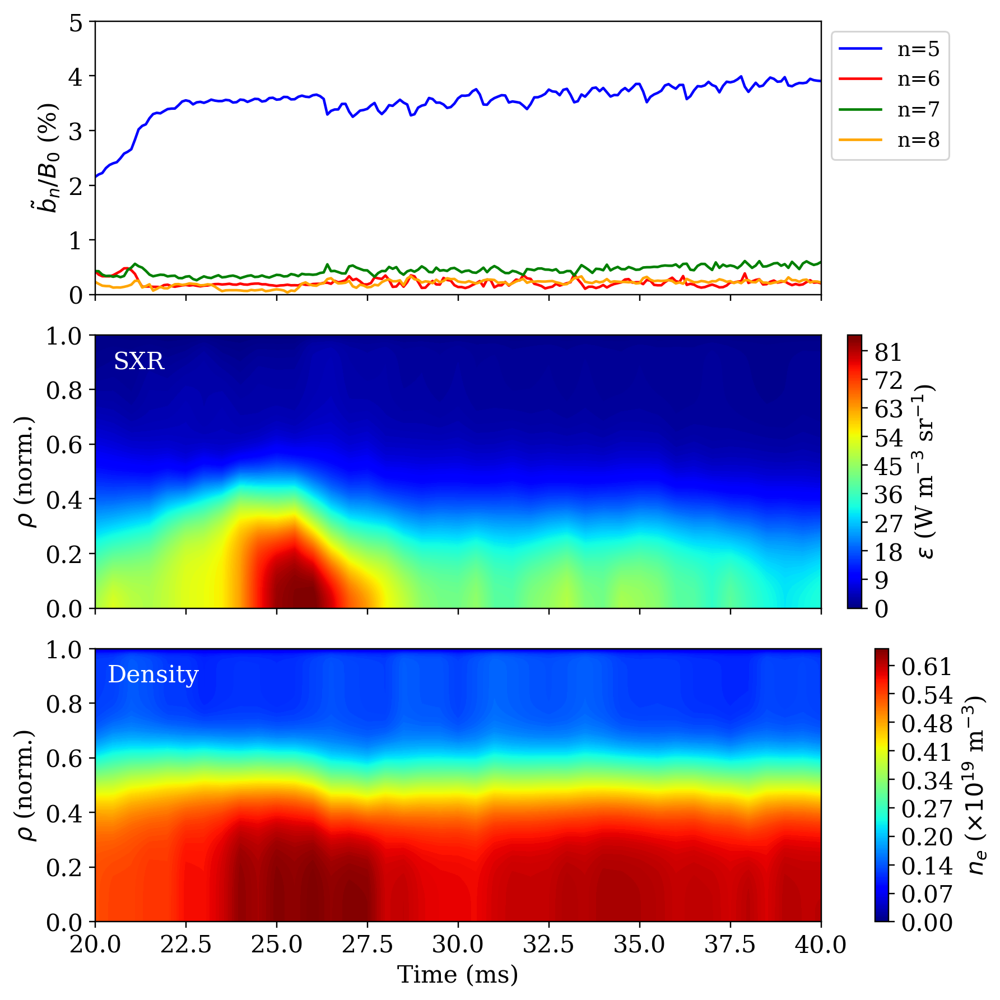

In [673]:
fig, axs = plt.subplots(3, 1, sharex=True, constrained_layout=True, figsize=(8,8))

# Magnetics signals    
b0 = np.sqrt(mags.BP['EQ']**2 + mags.BT['EQ'])
for n,color in zip([5,6,7,8], ['blue','red','green','orange']):
    key = 'N{0:02d}'.format(n)
    b_n = np.sqrt(mags.BP[key]['Amplitude']**2 + mags.BT[key]['Amplitude'])
    axs[0].plot(mags.Time, b_n / b0 * 100, label='n={0:d}'.format(n), color=color)

axs[0].legend(loc='upper left', bbox_to_anchor=(1.00, 1.0))
axs[0].set_ylabel(r'$\tilde{b}_n/B_{0}$ (%)')
axs[0].set_ylim([0,5])

# Emissivity
cax = axs[1].contourf(ts, ps, emiss_MLE.T, 200, cmap=cm.jet, vmin=0, vmax=85)
fig.colorbar(cax, ax=axs[1], label=r'$\varepsilon$ (W m$^{-3}$ sr$^{-1}$)')
axs[1].set_ylabel(r'$\rho$ (norm.)')
text(0.06, 0.9, 'SXR', axs[1], fontsize=14, color='white')

# Density
cax = axs[2].contourf(ts, ps, dens_MLE.T, 200, cmap=cm.jet, vmin=0, vmax=0.65)
cb = fig.colorbar(cax, ax=axs[2], label=r'$n_e$ ($\times 10^{19}$ m$^{-3}$)')
cb.ax.set_yticklabels(["{:.2f}".format(i) for i in cb.get_ticks()])
axs[2].set_ylabel(r'$\rho$ (norm.)')
text(0.08, 0.9, 'Density', axs[2], fontsize=14, color='white')

for ax in axs:
    ax.set_xlim([ts[0], ts[-1]])
    
axs[-1].set_xlabel('Time (ms)');

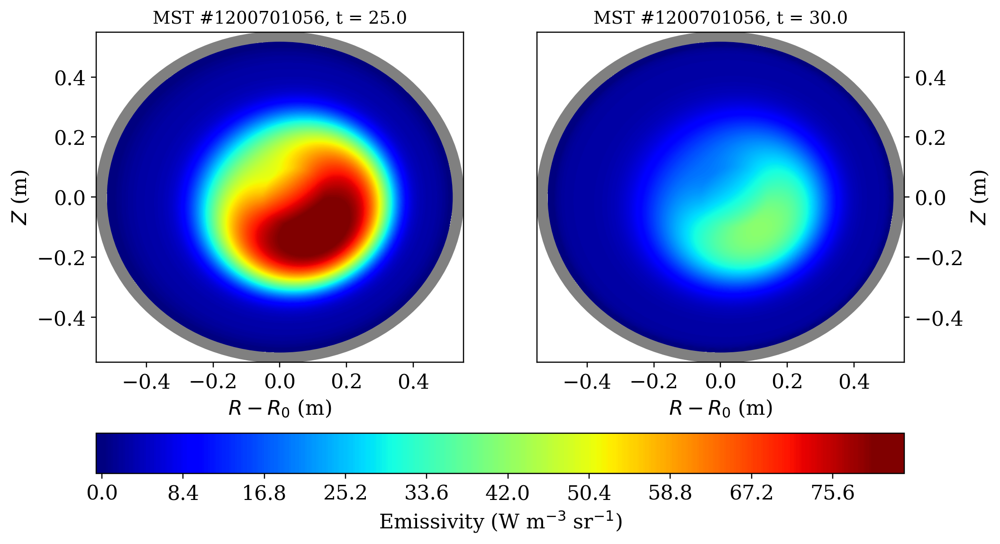

In [670]:
fig, axs = plt.subplots(1, 2, figsize=(10,6))

# Hot island
t = 25.0
tn = np.argmin(np.abs(ts - t))
xs, ys = sunflower_points(5000)
rs = rho_xy(xs, ys, t, label='SXT')
emiss = emiss_prof(rs, *popt_set[tn,:])

cax1 = axs[0].tricontourf(xs, ys, emiss, 500, cmap=cm.jet, vmax=80, vmin=0)
axs[0].set_title('MST #{0:10d}, t = {1:.1f}'.format(shot,ts[tn]))

# Tomography
t = 30.0
tn = np.argmin(np.abs(ts - t))
xs, ys = sunflower_points(5000)
rs = rho_xy(xs, ys, t, label='SXT')
emiss = emiss_prof(rs, *popt_set[tn,:])

cax2 = axs[1].tricontourf(xs, ys, emiss, 500, cmap=cm.jet, vmax=80, vmin=0)
axs[1].set_title('MST #{0:10d}, t = {1:.1f}'.format(shot,ts[tn]))
axs[1].yaxis.tick_right()
axs[1].yaxis.set_label_position("right")

# Add the colorbar
cb = fig.colorbar(cax1, ax=axs, label=r'Emissivity (W m$^{-3}$ sr$^{-1}$)', orientation='horizontal')

for ax in axs:
    ax.set_xlabel('$R - R_0$ (m)')
    ax.set_ylabel('$Z$ (m)')
    overplot_shell(ax)
    ax.set_xlim([-0.55, 0.55])
    ax.set_ylim([-0.55, 0.55])

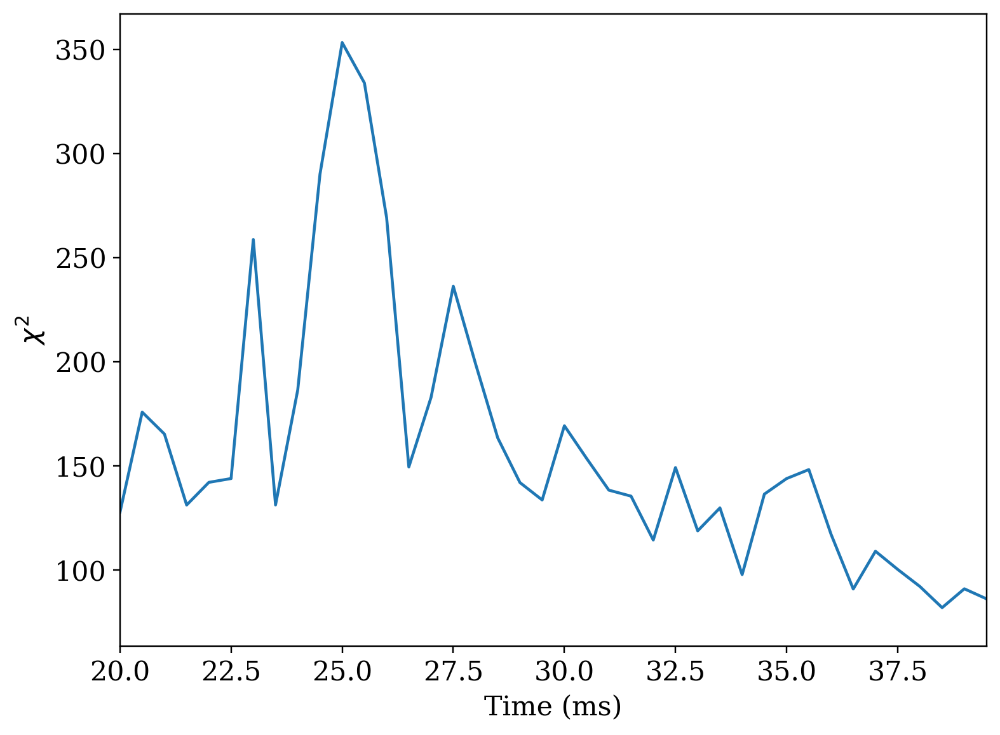

In [679]:
plt.plot(ts, chi2)
plt.xlabel('Time (ms)')
plt.ylabel(r'$\chi^2$')
plt.xlim([ts[0],ts[-2]]);

## Repeat the analysis, but with improved time resolution ($\Delta t = 0.1$ ms)

In [682]:
#Analysis parameters
shot = 1200701056
dt = 0.1
ts = np.arange(20, 40+dt, dt)
ps = np.linspace(0, 1, num=100)
n_rs = 500

# FIR data
fir_data, fir_radius, fir_time = fir.get_fir_signals(shot)

# SXT data
smooth = 10
exclude = [20, 59, 60]
st = load_brightness(shot, t_start=ts[0], t_end=ts[-1], delta=dt, smooth=10, exclude=exclude)
x_data = np.array([n for n in range(40) if n+41 not in exclude])

% SXR_MST_BOX_GET_SIGNALS: beginning for shot #1200701056
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO signals in W/m2
% SXR_MST_BOX_GET_SIGNALS: opening MST for shot 1200701056
% Compiled module: WHOAMI.
% Compiled module: FILEBREAK.
% Compiled module: CALC_GEOM_2.
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO time base, Fri Jul 31 12:06:02 2020
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO signals
% SXR_MST_BOX_GET_SIGNALS: assembling bright structure and transposing matrix
% SXR_MST_BOX_GET_SIGNALS: SXRTOMO done
Time=4.7567811 s


In [1016]:
def ne_prof(rs, n0, n1, alpha, beta, gamma=100.):
    dens = (n0 - n1) * (1 - rs**alpha)**beta + n1 * (1 - rs**gamma)
    return np.maximum(dens, 0.0)

# The model function
def get_model_dens(Rhos, n0, n1, alpha, beta, gamma=100.):
    Nes = ne_prof(Rhos, n0, n1, alpha, beta, gamma=gamma)
    return np.average(Nes, axis=0)

# The model profile
def emiss_prof(rs, eps0, eps1, alpha, beta, dr):
    return eps0 * (1 - rs**alpha) + eps1 * np.exp( -(rs/dr)**beta)

# The model function
def get_model_emiss(Rhos, Dx, eps0, eps1, alpha, beta, dr):
    Ems = emiss_prof(Rhos, eps0, eps1, alpha, beta, dr)
    return np.sum(Ems*Dx, axis=0)

In [704]:
# MLE parameters
gamma = 100.0
theta0 = np.array([0.53833125,  0.11819256,  4.84176419, 14.])
bounds = [(0.2, 1.0),
          (0.0, 0.2),
          (1.0, 14.0),
          (1.0, 14.0)]

# Make the detector object
fir_det = FIR_3D()
rs = fir_det.radius
n_chords = len(fir_det.chords)
labels = ['FIR_P' if fir_det.pluses[index] else 'FIR_M' for index in range(n_chords)]

# Containers for the results
n_params = len(theta0)
popt_dens = np.zeros([len(ts), n_params])
chi2_dens = np.zeros(len(ts))
dens_MLE = np.zeros([len(ts), len(ps)])

for ii,t in enumerate(tqdm(ts)):
    # Avoid issue with rounding on last frame
    t = 40. if t > 40. else t
    
    # Load the data
    tn0 = np.argmin(np.abs(fir_time - (t - dt/2) ))
    tn1 = np.argmin(np.abs(fir_time - (t + dt/2) )) + 1
    y_data = np.array([np.average(fir_data[index,tn0:tn1]) for index in range(n_chords)])
    y_sigma = np.array([np.std(fir_data[index,tn0:tn1]) for index in range(n_chords)])
    
    # Set the default MLE
    if ii == 0:
        x0 = theta0
    else:
        x0 = popt_dens[ii-1,:]
    
    # Build the Rhos matrix
    Rhos = np.zeros([n_rs, n_chords])
    Xs = np.zeros([n_rs, n_chords])
    for jj, chord in enumerate(fir_det.chords):
        a = chord.los.intercept_with_circle(0.52)
        ells = np.linspace(-a, a, num=n_rs)
        xl, yl = chord.los.get_xy(ells)
        Rhos[:,jj] = rho_xy(xl, yl, t, label=labels[jj])
        Xs[:, jj] = ells

    # Explicitly limit the Rhos matrix to between 0 and 1
    Rhos[Rhos < 0] = 0.0
    Rhos[Rhos > 1] = 1.0
    
    # Use MLE to find the optimal fits
    def get_chi2(theta):
        y_model = get_model_dens(Rhos, *theta, gamma=gamma)
        return np.sum( (y_data - y_model)**2 / (y_sigma)**2 )
    
    func = lambda theta: -0.5*get_chi2(theta)
    params = get_MLE(func, x0, bounds=bounds, verbose=False)
    
    # Generate the profiles
    dens_MLE[ii,:] = ne_prof(ps, *params, gamma=gamma)
    popt_dens[ii,:] = params
    chi2_dens[ii] = get_chi2(params)

100%|██████████| 201/201 [00:30<00:00,  6.69it/s]


In [ ]:
# The model profile
def emiss_prof(rs, eps0, eps1, alpha, beta, dr):
    return eps0 * (1 - rs**alpha) + eps1 * np.exp( -(rs/dr)**beta)

# The model function
def get_model_emiss(Rhos, Dx, eps0, eps1, alpha, beta, dr):
    Ems = emiss_prof(Rhos, eps0, eps1, alpha, beta, dr)
    return np.sum(Ems*Dx, axis=0)

In [705]:
# MLE parameters
theta0 = np.array([ 2.99294787, 79.33864868, 20.69115458,  3.17955924,  0.43978552])
bounds = [(0.0, 5.0),
          (5.0, 150.0),
          (2, 40),
          (1, 16),
          (0.1, 0.6)]

# Make the detector object
sxt_det = SXT()
filters = filter_list('thin')
sxt_los = np.concatenate([sxt_det.los[f] for f in filters])
sxt_ps = np.concatenate([sxt_det.p[f] for f in filters])
labels = np.concatenate([[f]*len(sxt_det.los[f]) for f in filters])
n_chords = len(sxt_los)

# Containers for the results
n_params = len(theta0)
popt_emiss = np.zeros([len(ts), n_params])
chi2_emiss = np.zeros(len(ts))
emiss_MLE = np.zeros([len(ts), len(ps)])

for ii,t in enumerate(tqdm(ts)):
    # Avoid issue with rounding on last frame
    t = 40. if t > 40. else t
    
    # Load the data
    tn = np.argmin(np.abs(st.time - t))
    y_data = np.concatenate([st.bright[f][:,tn] for f in filters])
    y_sigma = np.concatenate([st.sigma[f][:,tn] for f in filters])
    
    # Set the default MLE
    if ii == 0:
        x0 = theta0
    else:
        x0 = popt_emiss[ii-1,:]
    
    # Build the Rhos matrix
    Rhos = np.zeros([n_rs, n_chords])
    Xs = np.zeros([n_rs, n_chords])
    for jj, los in enumerate(sxt_los):
        a = los.intercept_with_circle(0.52)
        ells = np.linspace(-a, a, num=n_rs)
        xl, yl = los.get_xy(ells)
        Rhos[:,jj] = rho_xy(xl, yl, t, label='SXT')
        Xs[:, jj] = ells

    # Explicitly limit the Rhos matrix to between 0 and 1
    Rhos[Rhos < 0] = 0.0
    Rhos[Rhos > 1] = 1.0

    # Delta matrix for quick trapezoidal integration
    Dx = np.ones(Xs.shape)
    Dx[0,:] = Dx[1,:] = 0.5
    for j in range(n_chords):
        Dx[:,j] *= Xs[1,j] - Xs[0,j]
    
    # Use MLE to find the optimal fits
    def get_chi2(theta):
        y_model = get_model_emiss(Rhos, Dx, *theta)
        return np.sum( (y_data - y_model)**2 / (y_sigma)**2 )
    
    func = lambda theta: -0.5*get_chi2(theta)
    params = get_MLE(func, x0, bounds=bounds, verbose=False)
    
    # Generate the profiles
    emiss_MLE[ii,:] = emiss_prof(ps, *params)
    popt_emiss[ii,:] = params
    chi2_emiss[ii] = get_chi2(params)

100%|██████████| 201/201 [03:01<00:00,  1.11it/s]


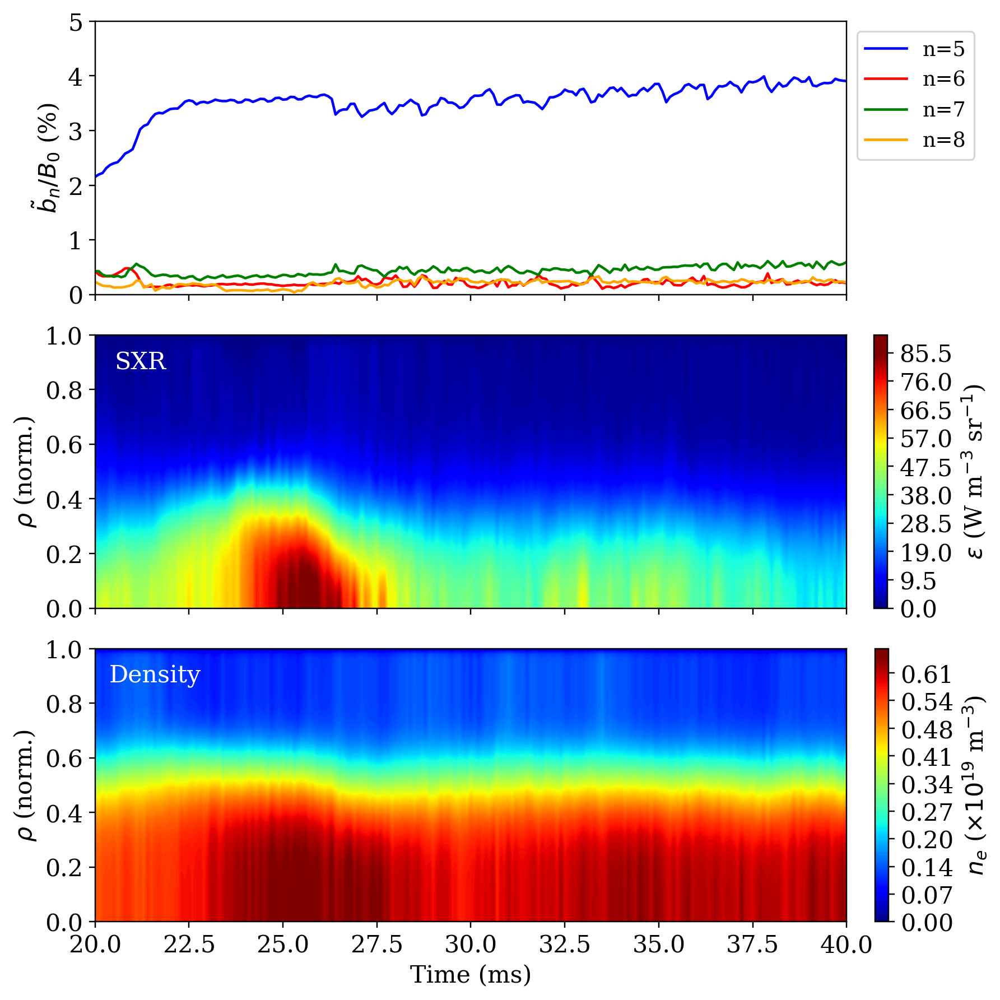

In [720]:
fig, axs = plt.subplots(3, 1, sharex=True, constrained_layout=True, figsize=(8,8))

# Magnetics signals    
b0 = np.sqrt(mags.BP['EQ']**2 + mags.BT['EQ'])
for n,color in zip([5,6,7,8], ['blue','red','green','orange']):
    key = 'N{0:02d}'.format(n)
    b_n = np.sqrt(mags.BP[key]['Amplitude']**2 + mags.BT[key]['Amplitude'])
    axs[0].plot(mags.Time, b_n / b0 * 100, label='n={0:d}'.format(n), color=color)

axs[0].legend(loc='upper left', bbox_to_anchor=(1.00, 1.0))
axs[0].set_ylabel(r'$\tilde{b}_n/B_{0}$ (%)')
axs[0].set_ylim([0,5])

# Emissivity
cax = axs[1].contourf(ts, ps, emiss_MLE.T, 200, cmap=cm.jet, vmin=0, vmax=85)
fig.colorbar(cax, ax=axs[1], label=r'$\varepsilon$ (W m$^{-3}$ sr$^{-1}$)')
axs[1].set_ylabel(r'$\rho$ (norm.)')
text(0.06, 0.9, 'SXR', axs[1], fontsize=14, color='white')

# Density
cax = axs[2].contourf(ts, ps, dens_MLE.T, 200, cmap=cm.jet, vmin=0, vmax=0.65)
cb = fig.colorbar(cax, ax=axs[2], label=r'$n_e$ ($\times 10^{19}$ m$^{-3}$)', pad=-0.01)
cb.ax.set_yticklabels(["{:.2f}".format(i) for i in cb.get_ticks()])
axs[2].set_ylabel(r'$\rho$ (norm.)')
text(0.08, 0.9, 'Density', axs[2], fontsize=14, color='white')

for ax in axs:
    ax.set_xlim([ts[0], ts[-1]])
    
axs[-1].set_xlabel('Time (ms)');

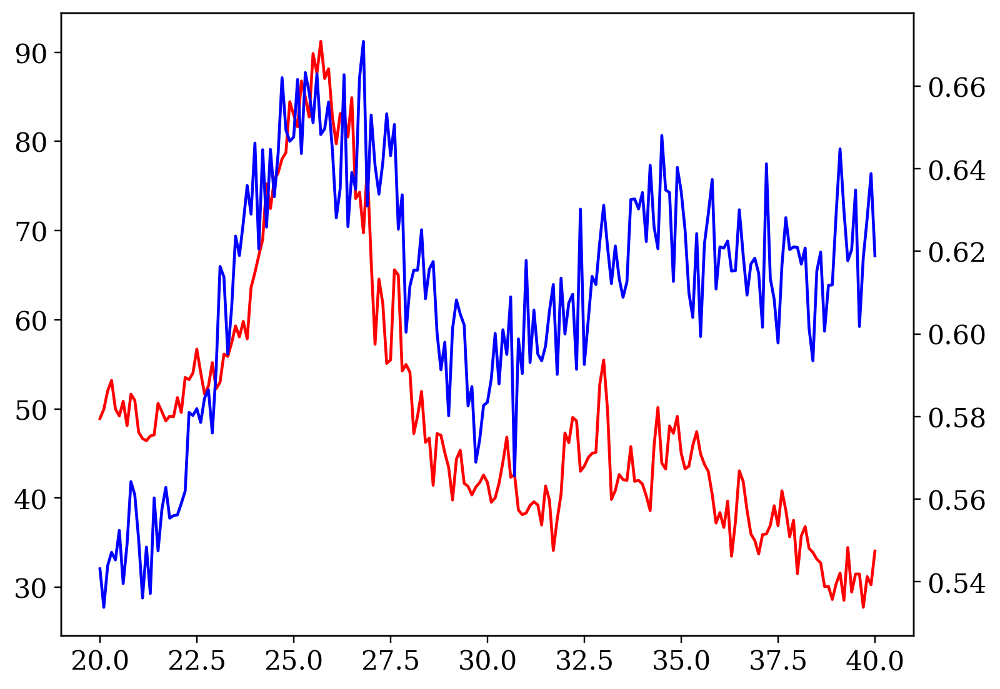

In [711]:
plt.plot(ts, emiss_MLE[:,0], color='red')

ax2 = plt.twinx()
ax2.plot(ts, dens_MLE[:,0], color='blue');

Do density fluctuations/$\nabla n_e$ correlate with $\tilde{b}_5$?

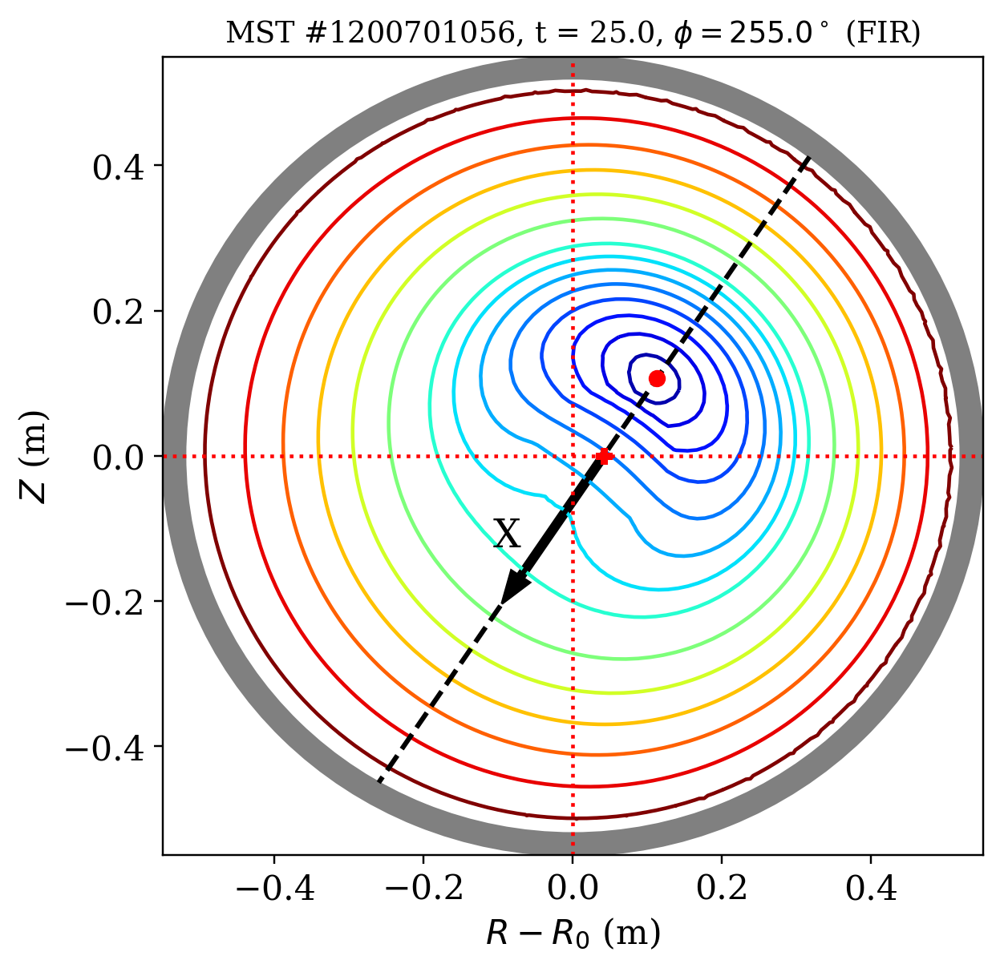

In [772]:
from mst_ida.models.base.geometry import line_of_sight

fig = plt.figure(figsize=(6,6))

# Plot flux contours
t = 25.0
levels = [0.01, 0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 0.99]
xs, ys = sunflower_points(5000)
rs = rho_xy(xs, ys, t, label='FIR_P')
cax2 = plt.tricontour(xs, ys, rs, levels=levels, cmap=cm.jet)

# Find the o-point
n_op = np.argmin(rs)
x_op = xs[n_op]
y_op = ys[n_op]
plt.plot([x_op], [y_op], 'or', zorder=100)

# Get the LoS parameters
delta = float(avg.delta)
plt.plot([delta], [0], 'Pr', zorder=100)
impact_phi = np.pi/2 - np.arctan2(y_op, delta - x_op)
impact_p = delta * np.cos(impact_phi)

# Plot the LoS
los = line_of_sight(impact_p, impact_phi)
ell_max = los.intercept_with_circle(0.52)
ells = np.linspace(-ell_max, ell_max, num=100)
xl, yl = los.get_xy(ells)
plt.plot(xl, yl, '--k', linewidth=2)

# Indicate direction with an arrow
theta = impact_phi - np.pi/2
plt.arrow(delta, 0, 0.2*np.cos(theta), 0.2*np.sin(theta), width=0.01, color='black')
text(0.42, 0.4, 'X', plt.gca(), fontsize=16)

# Make it look nice
plt.axvline(x=0, color='red', linestyle=':')
plt.axhline(y=0, color='red', linestyle=':')
overplot_shell(plt.gca())
plt.xlabel('$R - R_0$ (m)')
plt.ylabel('$Z$ (m)')
plt.xlim([-0.55, 0.55])
plt.ylim([-0.55, 0.55])
plt.title(r'MST #{0:10d}, t = {1:.1f}, $\phi = {2:.1f}^\circ$ (FIR)'.format(shot, t, 255.0));

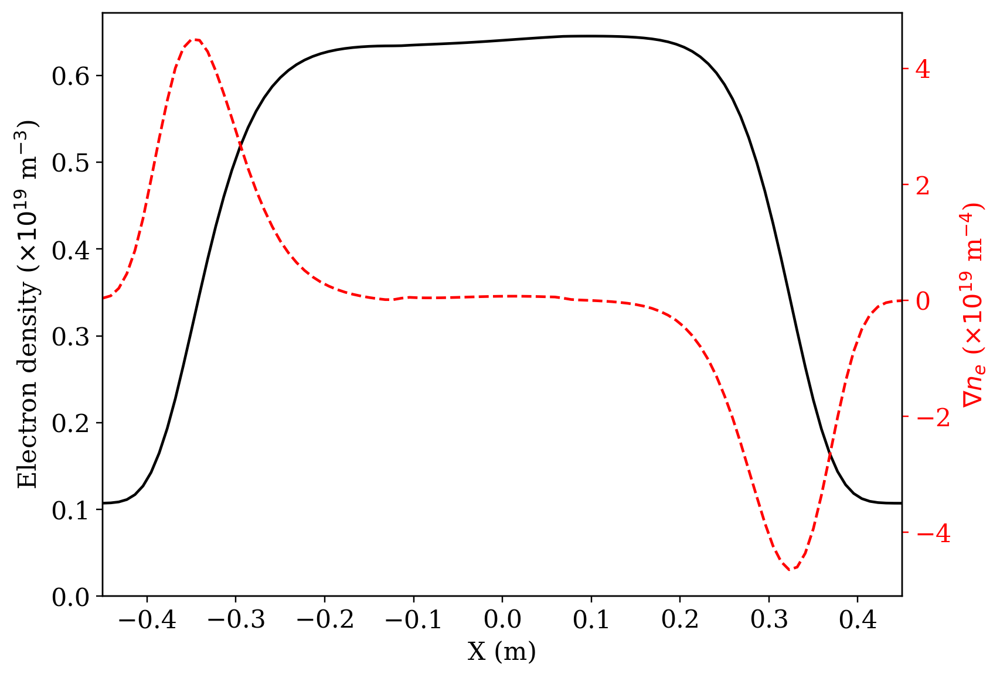

In [789]:
from mst_ida.models.base.geometry import line_of_sight

delta = float(avg.delta)
t = 25.0
tn = np.argmin(np.abs(ts - t))

# Load the rhos
xs, ys = sunflower_points(5000)
rs = rho_xy(xs, ys, t, label='FIR_P')

# Find the o-point
n_op = np.argmin(rs)
x_op = xs[n_op]
y_op = ys[n_op]

# Get the line of sight
impact_phi = np.pi/2 - np.arctan2(y_op, delta - x_op)
impact_p = delta * np.cos(impact_phi)
los = line_of_sight(impact_p, impact_phi)
ell_max = 0.45
ells = np.linspace(-ell_max, ell_max, num=100)
xl, yl = los.get_xy(ells)
rhos = rho_xy(xl, yl, t)
ne_ls = ne_prof(rhos, *popt_dens[tn,:], gamma=gamma)

# Plot the profile
plt.plot(ells, ne_ls, color='black')
plt.xlim([-0.45, 0.45])
plt.ylim([0,None])
plt.xlabel('X (m)')
plt.ylabel(r'Electron density ($\times 10^{19}$ m$^{-3}$)')

# Get the gradient
grad_n = np.gradient(ne_ls, ells)

ax2 = plt.twinx()
ax2.plot(ells, grad_n, color='red', linestyle='--')
color_axis(ax2, color='red')
ax2.set_ylabel(r'$\nabla n_e$ ($\times 10^{19}$ m$^{-4}$)');

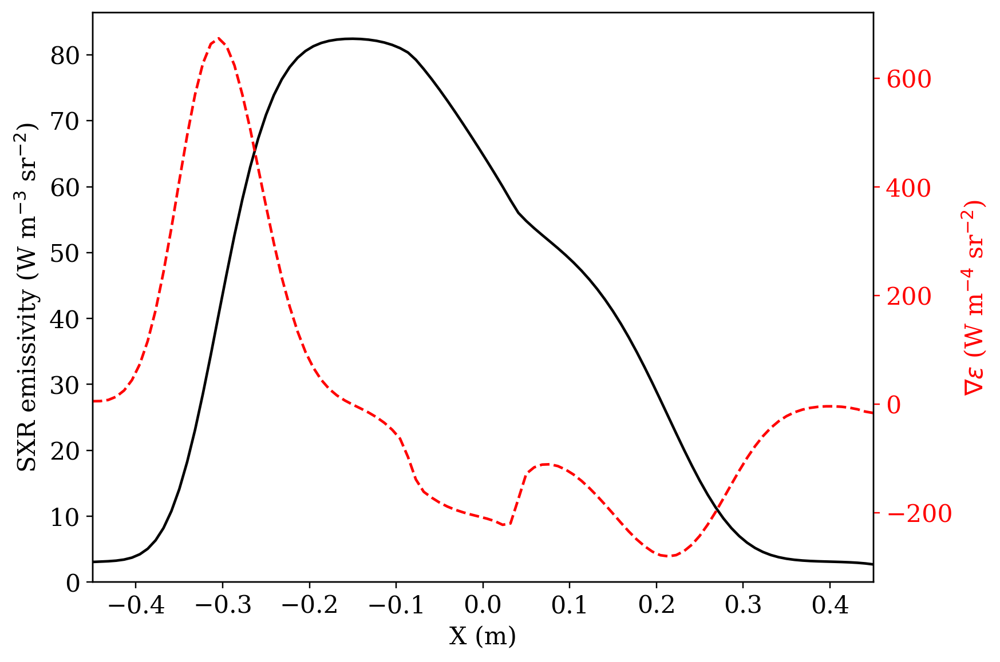

In [790]:
# Load the rhos
xs, ys = sunflower_points(5000)
rs = rho_xy(xs, ys, t, label='SXT')

# Find the o-point
n_op = np.argmin(rs)
x_op = xs[n_op]
y_op = ys[n_op]

# Get the line of sight
impact_phi = np.pi/2 - np.arctan2(y_op, delta - x_op)
impact_p = delta * np.cos(impact_phi)
los = line_of_sight(impact_p, impact_phi)
ell_max = 0.45
ells = np.linspace(-ell_max, ell_max, num=100)
xl, yl = los.get_xy(ells)
rhos = rho_xy(xl, yl, t)
ne_ls = emiss_prof(rhos, *popt_emiss[tn,:])

# Plot the profile
plt.plot(ells, ne_ls, color='black')
plt.xlim([-0.45, 0.45])
plt.ylim([0,None])
plt.xlabel('X (m)')
plt.ylabel(r'SXR emissivity (W m$^{-3}$ sr$^{-2}$)')

# Get the gradient
grad_n = np.gradient(ne_ls, ells)

ax2 = plt.twinx()
ax2.plot(ells, grad_n, color='red', linestyle='--')
color_axis(ax2, color='red')
ax2.set_ylabel(r'$\nabla \varepsilon$ (W m$^{-4}$ sr$^{-2}$)');

I need to evaluate $\Delta$ at each time point for this analysis. Then I can hopefully interpolate this to intermediate times.

In [793]:
%%capture
avgs = [sheq_averages(shot, t) for t in times]    
deltas = np.array([avg.delta for avg in avgs])

def get_delta(t):
    return np.interp(t, times, deltas)

In [1264]:
fdir = '/home/pdvanmeter/data/sheq/interpolators'
fname = 'avg_set_s{0:10d}.pkl'.format(shot)
fpath = os.path.join(fdir, fname)

with open(fpath, 'wb') as f:
    pickle.dump(avgs, f)

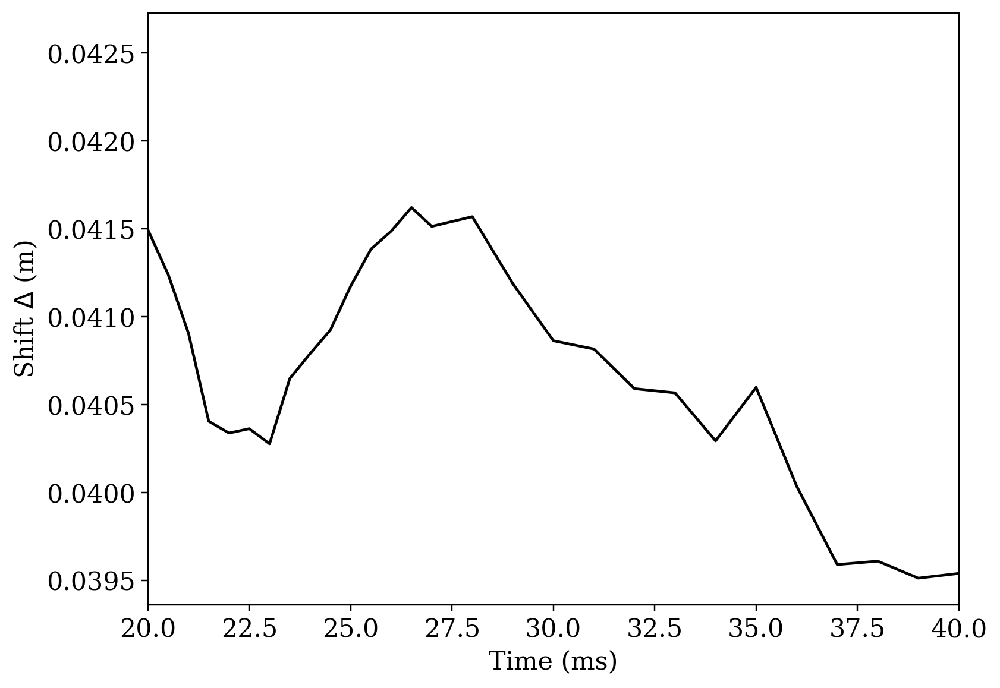

In [800]:
plt.plot(times, deltas, color='black')
plt.ylabel(r'Shift $\Delta$ (m)')
plt.xlabel('Time (ms)')
plt.xlim([20,40]);

In [850]:
# Evaluate the gradient over time
ells = np.linspace(-0.45, 0.45, num=100)
prof_n = np.zeros([len(ts), len(ells)])
grad_n = np.zeros([len(ts), len(ells)])
grad_n_max = np.zeros(len(ts))
grad_n_x0 = np.zeros(len(ts))

for t in tqdm(ts):
    # Avoid issue with rounding on last frame
    t = 40. if t > 40. else t
    tn = np.argmin(np.abs(ts - t))
    delta = get_delta(t)
    

    # Load the rhos
    xs, ys = sunflower_points(5000)
    rs = rho_xy(xs, ys, t, label='FIR_P')

    # Find the o-point
    n_op = np.argmin(rs)
    x_op = xs[n_op]
    y_op = ys[n_op]

    # Get the line of sight
    impact_phi = np.pi/2 - np.arctan2(y_op, delta - x_op)
    impact_p = delta * np.cos(impact_phi)
    los = line_of_sight(impact_p, impact_phi)
    xl, yl = los.get_xy(ells)
    rhos = rho_xy(xl, yl, t)
    ne_ls = ne_prof(rhos, *popt_dens[tn,:], gamma=gamma)
    
    # Get the gradient
    prof_n[tn,:] =  ne_ls
    grad_n[tn,:] = np.gradient(ne_ls, ells)
    grad_n_max[tn] = np.amax(np.abs(grad_n[tn,:]))
    grad_n_x0[tn] = ells[np.argmax(np.abs(grad_n[tn,:]))]

100%|██████████| 201/201 [00:10<00:00, 19.22it/s]


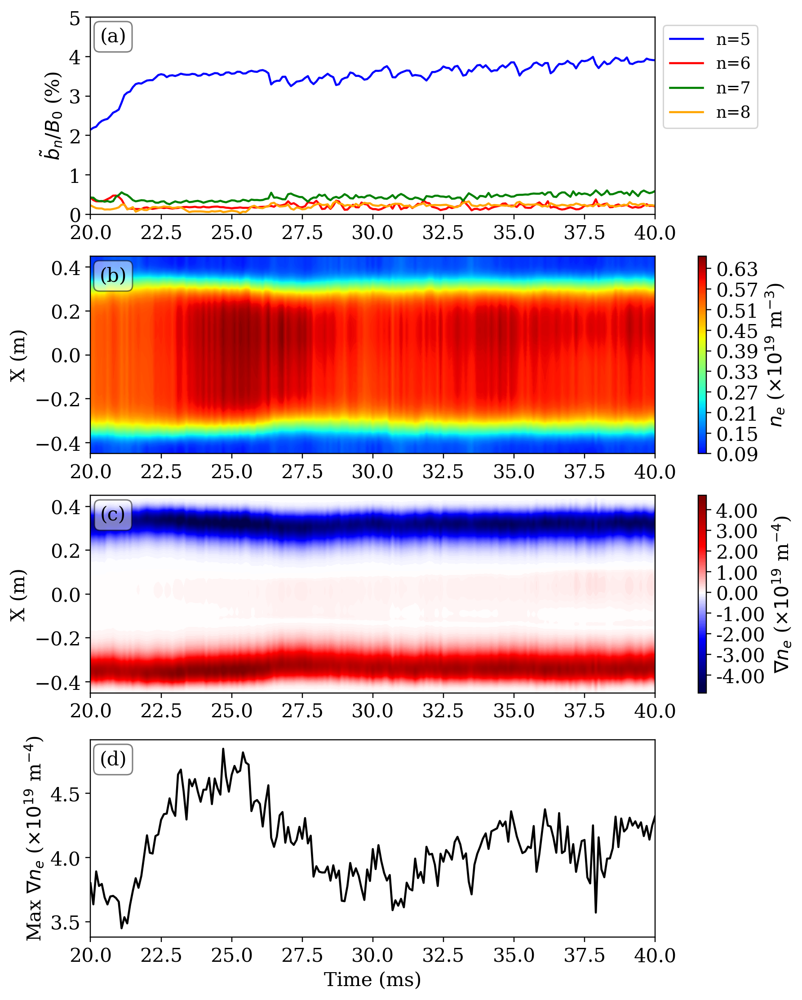

In [855]:
fig, axs = plt.subplots(4, 1, constrained_layout=True, figsize=(8,10))
props = dict(boxstyle='round', facecolor='white', alpha=0.5)

# Magnetics signals    
b0 = np.sqrt(mags.BP['EQ']**2 + mags.BT['EQ'])
for n,color in zip([5,6,7,8], ['blue','red','green','orange']):
    key = 'N{0:02d}'.format(n)
    b_n = np.sqrt(mags.BP[key]['Amplitude']**2 + mags.BT[key]['Amplitude'])
    axs[0].plot(mags.Time, b_n / b0 * 100, label='n={0:d}'.format(n), color=color)

axs[0].legend(loc='upper left', bbox_to_anchor=(1.00, 1.0))
axs[0].set_ylabel(r'$\tilde{b}_n/B_{0}$ (%)')
axs[0].set_ylim([0,5])

# Density
cax = axs[1].contourf(ts, ells, prof_n.T, 200, cmap=cm.jet, vmin=0)
fig.colorbar(cax, ax=axs[1], label=r'$n_e$ ($\times 10^{19}$ m$^{-3}$)')
axs[1].set_ylabel(r'X (m)')

# Gradient
cax = axs[2].contourf(ts, ells, grad_n.T, 200, cmap=cm.seismic, vmin=-4.5, vmax=4.5)
cb = fig.colorbar(cax, ax=axs[2], label=r'$\nabla n_e$ ($\times 10^{19}$ m$^{-4}$)')
cb.ax.set_yticklabels(["{:.2f}".format(i) for i in cb.get_ticks()])
axs[2].set_ylabel(r'X (m)')

# Max gradient
axs[3].plot(ts, grad_n_max, color='black')
axs[3].set_ylabel(r'Max $\nabla n_e$ ($\times 10^{19}$ m$^{-4}$)')

for ax,alpha in zip(axs,['a','b','c','d']):
    text(0.04, 0.9, r'({0:})'.format(alpha), ax, fontsize=14, color='black', bbox=props)
    ax.set_xlim([ts[0], ts[-1]])
    
axs[-1].set_xlabel('Time (ms)');

In [823]:
mags = ops.get_magnetics(shot, t_start=ts[0], t_end=ts[-1], delta_t=dt, modes=np.arange(1,16))
b5 = np.sqrt(mags.BP['N05']['Amplitude']**2 + mags.BT['N05']['Amplitude'])
b6 = np.sqrt(mags.BP['N05']['Amplitude']**2 + mags.BT['N05']['Amplitude'])

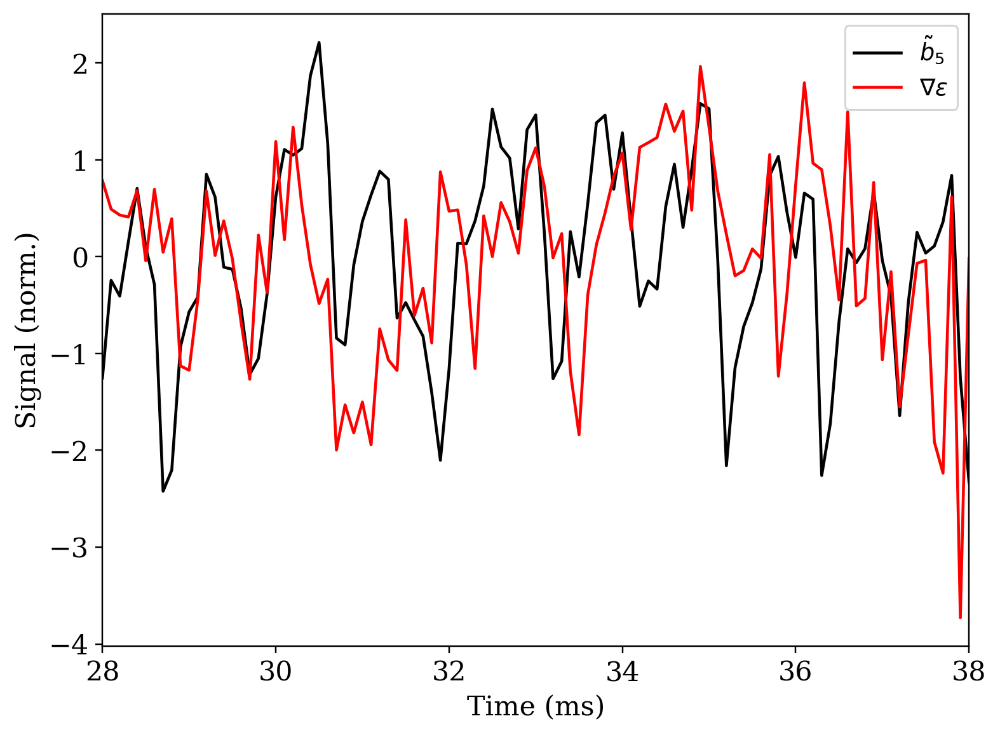

In [837]:
n0 = np.argmin(np.abs(ts - 28))
n1 = np.argmin(np.abs(ts - 38)) + 1

# Limit to the desired interval
a = np.copy(b5[n0:n1])
b = np.copy(grad_n_max[n0:n1])
ty = np.copy(ts[n0:n1])

# Detrend the signals
p = np.polyfit(ty, a, 1)
a -= p[0]*ty - p[1]

p = np.polyfit(ty, b, 1)
b -= p[0]*ty - p[1]

# Normalize the signals
yb = (a - np.mean(a))/np.std(a)
yn = (b - np.mean(b))/np.std(b)

plt.plot(ty, yb, color='black', label=r'$\tilde{b}_5$')
plt.plot(ty, yn, color='red', label=r'$\nabla \n_e$')
plt.legend()
plt.xlabel('Time (ms)')
plt.ylabel('Signal (norm.)')
plt.xlim([ty[0], ty[-1]]);

In [838]:
def get_corr(y1, y2, ts, mode='full'):
    corr = np.correlate(y1, y2, mode=mode)
    n_max = int((len(corr) - 1) / 2)
    ns = np.arange(-n_max, n_max+1)
    dt = ts[1] - ts[0]
    tau = dt*ns
    return tau, corr

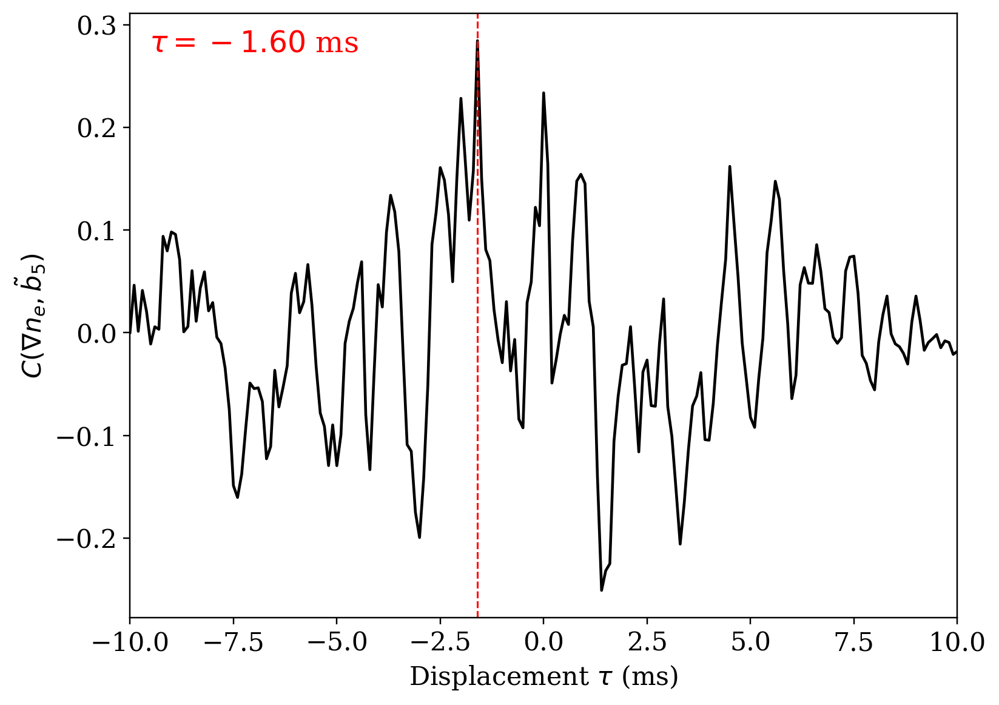

In [842]:
tau, corr = get_corr(yb, yn, ty, mode='full')
plt.plot(tau, corr/len(ty), color='black')
plt.xlabel(r'Displacement $\tau$ (ms)')
plt.ylabel(r'$C(\nabla n_e, \tilde{b}_5)$')
plt.xlim([tau[0], tau[-1]])

# Find the maximum offset
n_max = np.argmax(np.abs(corr))
tau_max = tau[n_max]
plt.axvline(x=tau_max, color='red', linestyle='--', linewidth=1)
text(0.15, 0.95, r'$\tau = {0:.2f}$ ms'.format(tau_max), plt.gca(), color='red', fontsize=16)

In [843]:
# Evaluate the gradient over time
ells = np.linspace(-0.45, 0.45, num=100)
prof_em = np.zeros([len(ts), len(ells)])
grad_em = np.zeros([len(ts), len(ells)])
grad_em_max = np.zeros(len(ts))
grad_em_x0 = np.zeros(len(ts))

for t in tqdm(ts):
    # Avoid issue with rounding on last frame
    t = 40. if t > 40. else t
    tn = np.argmin(np.abs(ts - t))
    delta = get_delta(t)

    # Load the rhos
    xs, ys = sunflower_points(5000)
    rs = rho_xy(xs, ys, t, label='SXT')

    # Find the o-point
    n_op = np.argmin(rs)
    x_op = xs[n_op]
    y_op = ys[n_op]

    # Get the line of sight
    impact_phi = np.pi/2 - np.arctan2(y_op, delta - x_op)
    impact_p = delta * np.cos(impact_phi)
    los = line_of_sight(impact_p, impact_phi)
    xl, yl = los.get_xy(ells)
    rhos = rho_xy(xl, yl, t)
    em_ls = emiss_prof(rhos, *popt_emiss[tn,:])
    
    # Get the gradient
    prof_em[tn,:] =  em_ls
    grad_em[tn,:] = np.gradient(em_ls, ells)
    grad_em_max[tn] = np.amax(np.abs(grad_em[tn,:]))
    grad_em_x0[tn] = ells[np.argmax(np.abs(grad_em[tn,:]))]

100%|██████████| 201/201 [03:05<00:00,  1.09it/s]


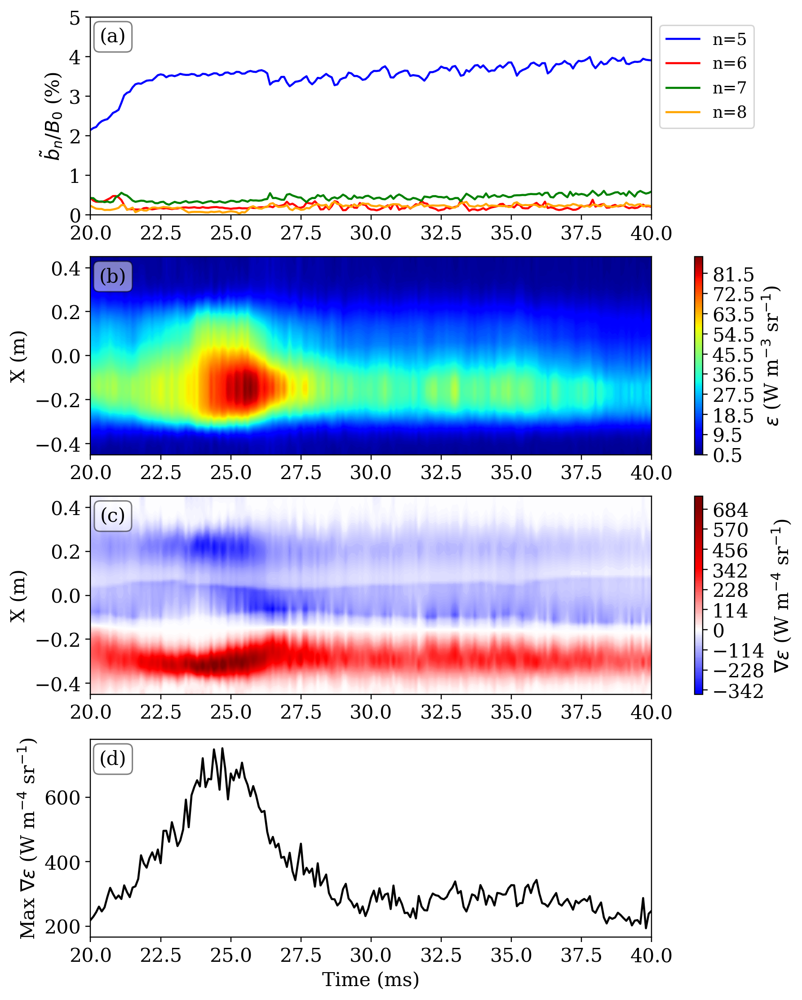

In [853]:
fig, axs = plt.subplots(4, 1, constrained_layout=True, figsize=(8,10))
props = dict(boxstyle='round', facecolor='white', alpha=0.5)

# Magnetics signals    
b0 = np.sqrt(mags.BP['EQ']**2 + mags.BT['EQ'])
for n,color in zip([5,6,7,8], ['blue','red','green','orange']):
    key = 'N{0:02d}'.format(n)
    b_n = np.sqrt(mags.BP[key]['Amplitude']**2 + mags.BT[key]['Amplitude'])
    axs[0].plot(mags.Time, b_n / b0 * 100, label='n={0:d}'.format(n), color=color)

axs[0].legend(loc='upper left', bbox_to_anchor=(1.00, 1.0))
axs[0].set_ylabel(r'$\tilde{b}_n/B_{0}$ (%)')
axs[0].set_ylim([0,5])

# Emissivity
cax = axs[1].contourf(ts, ells, prof_em.T, 200, cmap=cm.jet, vmin=0)
fig.colorbar(cax, ax=axs[1], label=r'$\varepsilon$ (W m$^{-3}$ sr$^{-1}$)')
axs[1].set_ylabel(r'X (m)')

# Gradient
cax = axs[2].contourf(ts, ells, grad_em.T, 200, cmap=cm.seismic, vmin=-700, vmax=700)
cb = fig.colorbar(cax, ax=axs[2], label=r'$\nabla \varepsilon$ (W m$^{-4}$ sr$^{-1}$)')
#cb.ax.set_yticklabels(["{:.2f}".format(i) for i in cb.get_ticks()])
axs[2].set_ylabel(r'X (m)')

# Max gradient
axs[3].plot(ts, grad_em_max, color='black')
axs[3].set_ylabel(r'Max $\nabla \varepsilon$ (W m$^{-4}$ sr$^{-1}$)')

for ax,alpha in zip(axs,['a','b','c','d']):
    text(0.04, 0.9, r'({0:})'.format(alpha), ax, fontsize=14, color='black', bbox=props)
    ax.set_xlim([ts[0], ts[-1]])
    
axs[-1].set_xlabel('Time (ms)');

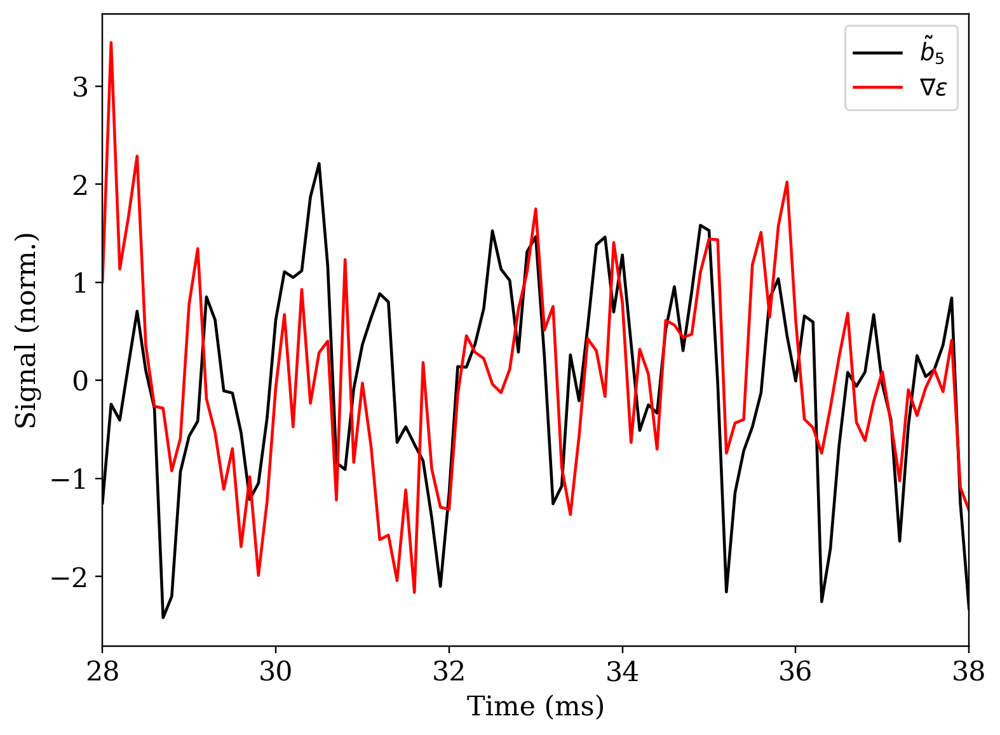

In [854]:
n0 = np.argmin(np.abs(ts - 28))
n1 = np.argmin(np.abs(ts - 38)) + 1

# Limit to the desired interval
a = np.copy(b5[n0:n1])
b = np.copy(grad_em_max[n0:n1])
ty = np.copy(ts[n0:n1])

# Detrend the signals
p = np.polyfit(ty, a, 1)
a -= p[0]*ty - p[1]

p = np.polyfit(ty, b, 1)
b -= p[0]*ty - p[1]

# Normalize the signals
yb = (a - np.mean(a))/np.std(a)
yem = (b - np.mean(b))/np.std(b)

plt.plot(ty, yb, color='black', label=r'$\tilde{b}_5$')
plt.plot(ty, yem, color='red', label=r'$\nabla \varepsilon$')
plt.legend()
plt.xlabel('Time (ms)')
plt.ylabel('Signal (norm.)')
plt.xlim([ty[0], ty[-1]]);

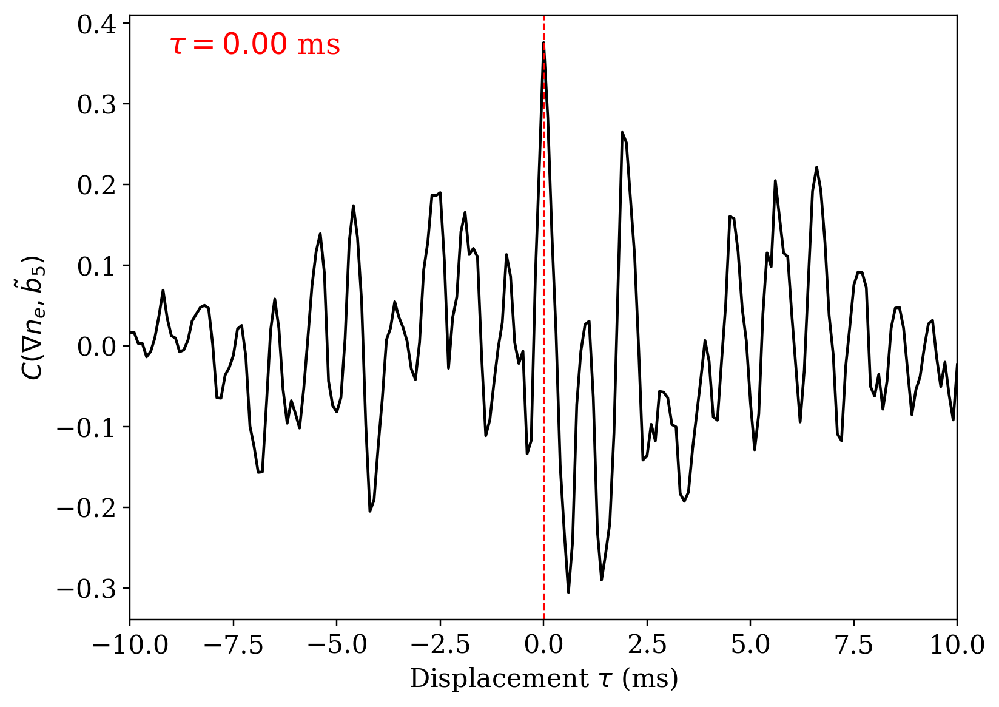

In [857]:
tau, corr = get_corr(yb, yem, ty, mode='full')
plt.plot(tau, corr/len(ty), color='black')
plt.xlabel(r'Displacement $\tau$ (ms)')
plt.ylabel(r'$C(\nabla n_e, \tilde{b}_5)$')
plt.xlim([tau[0], tau[-1]])

# Find the maximum offset
n_max = np.argmax(np.abs(corr))
tau_max = tau[n_max]
plt.axvline(x=tau_max, color='red', linestyle='--', linewidth=1)
text(0.15, 0.95, r'$\tau = {0:.2f}$ ms'.format(tau_max), plt.gca(), color='red', fontsize=16)

Text(0, 0.5, 'Max $\\nabla \\varepsilon$ (W m$^{-4}$ sr$^{-1}$)')

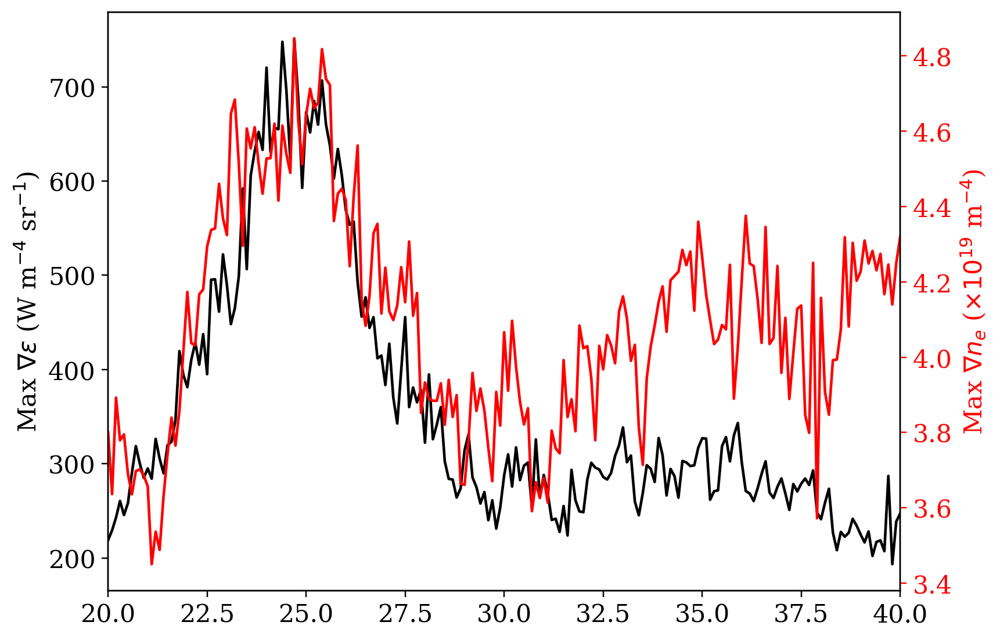

In [861]:
fig, ax = plt.subplots(1,1)

ax.plot(ts, grad_em_max, color='black')
ax.set_xlim([20,40])

ax2 = ax.twinx()
ax2.plot(ts, grad_n_max, color='red')
ax2.set_ylabel(r'Max $\nabla n_e$ ($\times 10^{19}$ m$^{-4}$)')
color_axis(ax2, color='red')

ax.set_ylabel(r'Max $\nabla \varepsilon$ (W m$^{-4}$ sr$^{-1}$)')

## What about thick filter SXT data?

In [866]:
# The model profile
def emiss_prof(rs, eps0, eps1, alpha, beta, dr):
    return eps0 * (1 - rs**alpha) + eps1 * np.exp( -(rs/dr)**beta)

# The model function
def get_model(Rhos, Dx, eps0, eps1, alpha, beta, dr):
    Ems = emiss_prof(Rhos, eps0, eps1, alpha, beta, dr)
    return np.sum(Ems*Dx, axis=0)

In [976]:
#Analysis parameters
shot = 1200701056
dt = 0.5
ts = np.arange(20, 40+dt, dt)
ps = np.linspace(0, 1, num=100)
n_rs = 500

# SXT data
smooth = 10
exclude = [20, 59, 60, 22, 62]
st = load_brightness(shot, t_start=ts[0], t_end=ts[-1], delta=dt, smooth=10, exclude=exclude)
x_data = np.array([n for n in range(40) if n+41 not in exclude])

# Shared parameters
sxt_det = SXT(exclude=exclude)
ts = np.arange(20, 40.5, 0.5)
n_rs = 500
ps = np.linspace(0, 1, num=100)

% SXR_MST_BOX_GET_SIGNALS: beginning for shot #1200701056
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO signals in W/m2
% SXR_MST_BOX_GET_SIGNALS: opening MST for shot 1200701056
% Compiled module: WHOAMI.
% Compiled module: FILEBREAK.
% Compiled module: CALC_GEOM_2.
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO time base, Fri Jul 31 18:21:03 2020
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO signals
% SXR_MST_BOX_GET_SIGNALS: assembling bright structure and transposing matrix
% SXR_MST_BOX_GET_SIGNALS: SXRTOMO done
Time=1.8242760 s


In [934]:
# MLE parameters
theta0 = np.array([ 2.99294787, 79.33864868, 20.69115458,  3.17955924,  0.43978552])
bounds = [(0.0, 5.0),
          (5.0, 150.0),
          (2, 40),
          (1, 16),
          (0.1, 0.6)]

# Make the detector object
filters = filter_list('thin')
sxt_los = np.concatenate([sxt_det.los[f] for f in filters])
labels = np.concatenate([[f]*len(sxt_det.los[f]) for f in filters])
n_chords = len(sxt_los)

# Containers for the results
n_params = len(theta0)
popt_thin = np.zeros([len(ts), n_params])
chi2_thin = np.zeros(len(ts))
emiss_thin = np.zeros([len(ts), len(ps)])

for ii,t in enumerate(tqdm(ts)):
    # Load the data
    t = 40. if t > 40. else t
    tn = np.argmin(np.abs(st.time - t))
    x_data = np.array([n for n in range(40) if n+41 not in exclude])
    y_data = np.concatenate([st.bright[f][:,tn] for f in filters])
    y_sigma = np.concatenate([st.sigma[f][:,tn] for f in filters])
    
    # Set the default MLE
    if ii == 0:
        x0 = theta0
    else:
        x0 = popt_thin[ii-1,:]
    
    # Build the Rhos matrix
    Rhos = np.zeros([n_rs, n_chords])
    Xs = np.zeros([n_rs, n_chords])
    for jj, los in enumerate(sxt_los):
        a = los.intercept_with_circle(0.52)
        ells = np.linspace(-a, a, num=n_rs)
        xl, yl = los.get_xy(ells)
        Rhos[:,jj] = rho_xy(xl, yl, t, label='SXT')
        Xs[:, jj] = ells

    # Explicitly limit the Rhos matrix to between 0 and 1
    Rhos[Rhos < 0] = 0.0
    Rhos[Rhos > 1] = 1.0

    # Delta matrix for quick trapezoidal integration
    Dx = np.ones(Xs.shape)
    Dx[0,:] = Dx[1,:] = 0.5
    for j in range(n_chords):
        Dx[:,j] *= Xs[1,j] - Xs[0,j]
    
    # Use MLE to find the optimal fits
    def get_chi2(theta):
        y_model = get_model(Rhos, Dx, *theta)
        return np.sum( (y_data - y_model)**2 / (y_sigma)**2 )
    
    func = lambda theta: -0.5*get_chi2(theta)
    params = get_MLE(func, x0, bounds=bounds, verbose=False)
    
    # Generate the profiles
    emiss_thin[ii,:] = emiss_prof(ps, *params)
    popt_thin[ii,:] = params
    chi2_thin[ii] = get_chi2(params)

100%|██████████| 41/41 [00:29<00:00,  1.37it/s]


In [936]:
# MLE parameters
theta0 = np.array([ 2.99294787, 10.000, 20.69115458,  3.17955924,  0.43978552])
bounds = [(0.0, 5.0),
          (5.0, 150.0),
          (2, 40),
          (1, 16),
          (0.1, 0.6)]

# Make the detector object
filters = filter_list('thick')
sxt_los = np.concatenate([sxt_det.los[f] for f in filters])
labels = np.concatenate([[f]*len(sxt_det.los[f]) for f in filters])
n_chords = len(sxt_los)

# Containers for the results
n_params = len(theta0)
popt_thick = np.zeros([len(ts), n_params])
chi2_thick = np.zeros(len(ts))
emiss_thick = np.zeros([len(ts), len(ps)])

for ii,t in enumerate(tqdm(ts)):
    # Load the data
    t = 40. if t > 40. else t
    tn = np.argmin(np.abs(st.time - t))
    x_data = np.array([n for n in range(40) if n+41 not in exclude])
    y_data = np.concatenate([st.bright[f][:,tn] for f in filters])
    y_sigma = np.concatenate([st.sigma[f][:,tn] for f in filters])
    
    # Set the default MLE
    if ii == 0:
        x0 = theta0
    else:
        x0 = popt_thin[ii-1,:]
    
    # Build the Rhos matrix
    Rhos = np.zeros([n_rs, n_chords])
    Xs = np.zeros([n_rs, n_chords])
    for jj, los in enumerate(sxt_los):
        a = los.intercept_with_circle(0.52)
        ells = np.linspace(-a, a, num=n_rs)
        xl, yl = los.get_xy(ells)
        Rhos[:,jj] = rho_xy(xl, yl, t, label='SXT')
        Xs[:, jj] = ells

    # Explicitly limit the Rhos matrix to between 0 and 1
    Rhos[Rhos < 0] = 0.0
    Rhos[Rhos > 1] = 1.0

    # Delta matrix for quick trapezoidal integration
    Dx = np.ones(Xs.shape)
    Dx[0,:] = Dx[1,:] = 0.5
    for j in range(n_chords):
        Dx[:,j] *= Xs[1,j] - Xs[0,j]
    
    # Use MLE to find the optimal fits
    def get_chi2(theta):
        y_model = get_model(Rhos, Dx, *theta)
        return np.sum( (y_data - y_model)**2 / (y_sigma)**2 )
    
    func = lambda theta: -0.5*get_chi2(theta)
    params = get_MLE(func, x0, bounds=bounds, verbose=False)
    
    # Generate the profiles
    emiss_thick[ii,:] = emiss_prof(ps, *params)
    popt_thick[ii,:] = params
    chi2_thick[ii] = get_chi2(params)

100%|██████████| 41/41 [00:40<00:00,  1.01it/s]


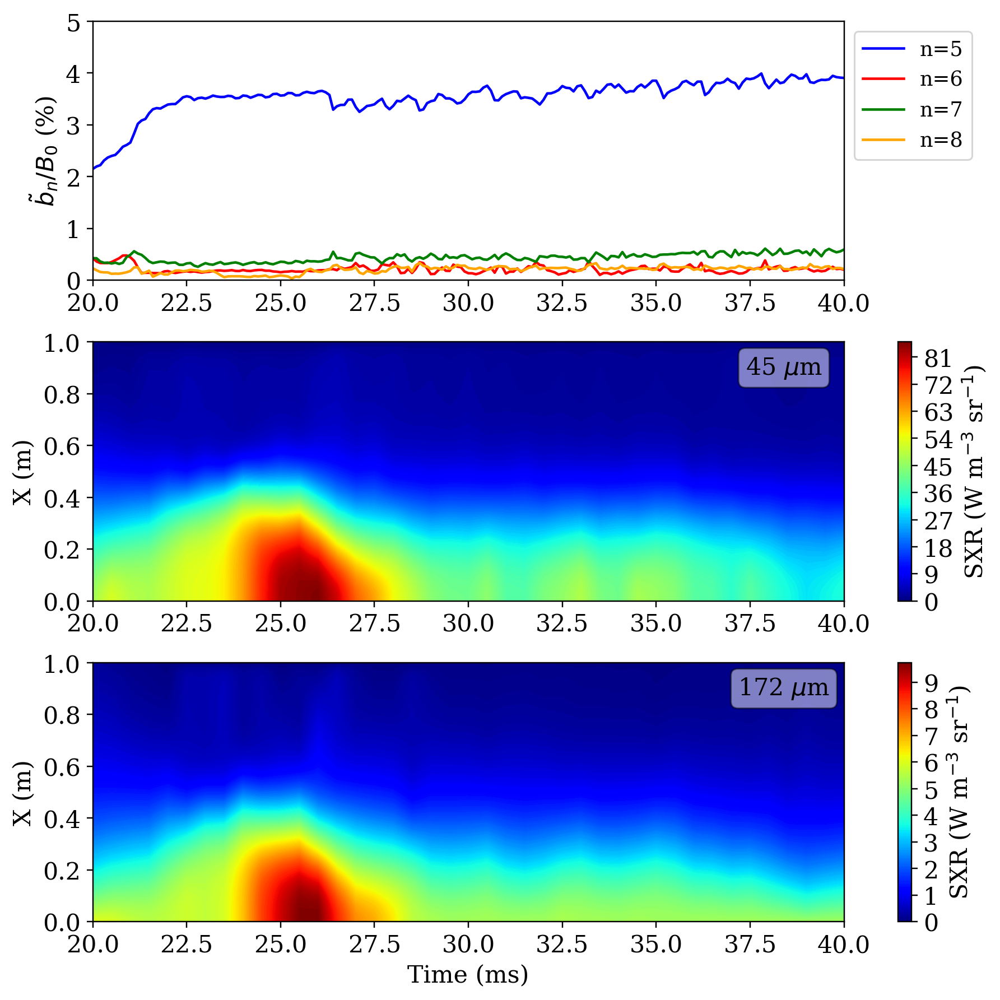

In [938]:
fig, axs = plt.subplots(3, 1, constrained_layout=True, figsize=(8,8))
props = dict(boxstyle='round', facecolor='white', alpha=0.5)

# Magnetics signals    
b0 = np.sqrt(mags.BP['EQ']**2 + mags.BT['EQ'])
for n,color in zip([5,6,7,8], ['blue','red','green','orange']):
    key = 'N{0:02d}'.format(n)
    b_n = np.sqrt(mags.BP[key]['Amplitude']**2 + mags.BT[key]['Amplitude'])
    axs[0].plot(mags.Time, b_n / b0 * 100, label='n={0:d}'.format(n), color=color)

axs[0].legend(loc='upper left', bbox_to_anchor=(1.00, 1.0))
axs[0].set_ylabel(r'$\tilde{b}_n/B_{0}$ (%)')
axs[0].set_ylim([0,5])

# Emissivity - thin
cax = axs[1].contourf(ts, ps, emiss_thin.T, 200, cmap=cm.jet, vmin=0)
fig.colorbar(cax, ax=axs[1], label=r'SXR (W m$^{-3}$ sr$^{-1}$)')
axs[1].set_ylabel(r'X (m)')
text(0.92, 0.9, r'45 $\mu$m', axs[1], fontsize=14, color='black', bbox=props)

# Emissivity - thick
cax = axs[2].contourf(ts, ps, emiss_thick.T, 200, cmap=cm.jet, vmin=0)
cb = fig.colorbar(cax, ax=axs[2], label=r'SXR (W m$^{-3}$ sr$^{-1}$)')
cb.ax.set_yticklabels(["{:.0f}".format(i) for i in cb.get_ticks()])
axs[2].set_ylabel(r'X (m)')
text(0.92, 0.9, r'172 $\mu$m', axs[2], fontsize=14, color='black', bbox=props)

for ax in axs:
    ax.set_xlim([ts[0], ts[-1]])
    
axs[-1].set_xlabel('Time (ms)');

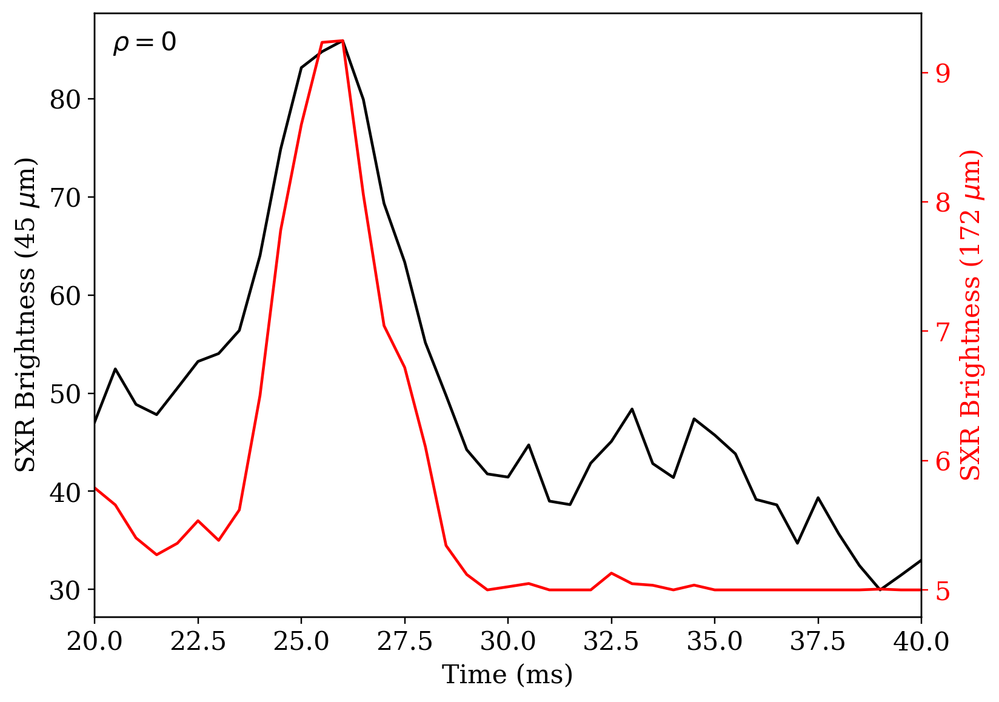

In [943]:
fig, ax1 = plt.subplots(1,1)
ax2 = ax1.twinx()

ax1.plot(ts, emiss_thin[:,0], color='black')
ax2.plot(ts, emiss_thick[:,0], color='red')

ax1.set_xlim([20,40])
ax1.set_xlabel('Time (ms)')
ax1.set_ylabel(r'SXR Brightness (45 $\mu$m)')
ax2.set_ylabel(r'SXR Brightness (172 $\mu$m)')
color_axis(ax2, color='red')
text(0.06, 0.95, r'$\rho = 0$', ax1, fontsize=14)

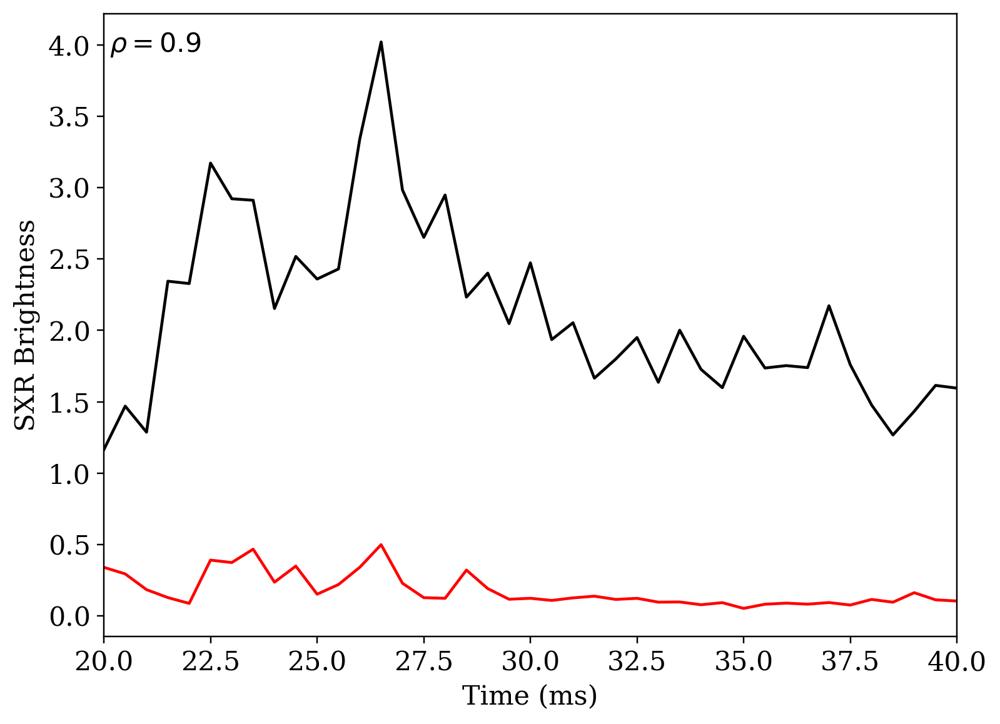

In [947]:
fig, ax1 = plt.subplots(1,1)

ax1.plot(ts, emiss_thin[:,-10], color='black', label=r'45 $\mu$m')
ax1.plot(ts, emiss_thick[:,-10], color='red', label=r'172 $\mu$m')

ax1.set_xlim([20,40])
ax1.set_xlabel('Time (ms)')
ax1.set_ylabel(r'SXR Brightness')
color_axis(ax2, color='red')
text(0.06, 0.95, r'$\rho = 0.9$', ax1, fontsize=14)

Below was my attempt to figure out which channels were causing me problems. No idea what is happening there, but it seems unphysical. So I will drop it.

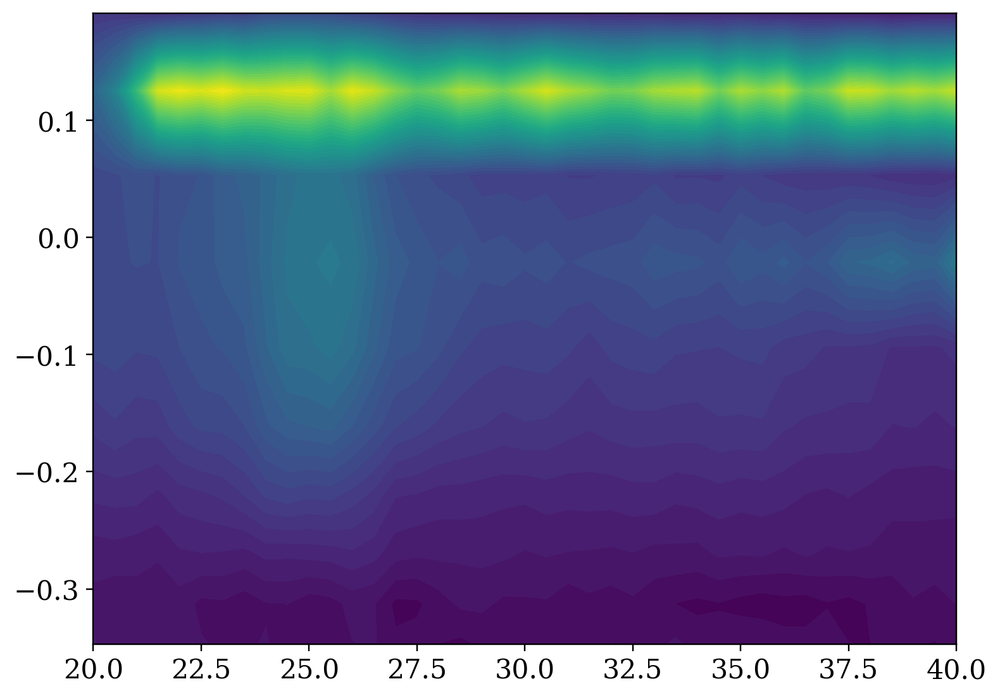

In [898]:
plt.contourf(st.time, st.p['C thick'], st.bright['C thick'], 50)

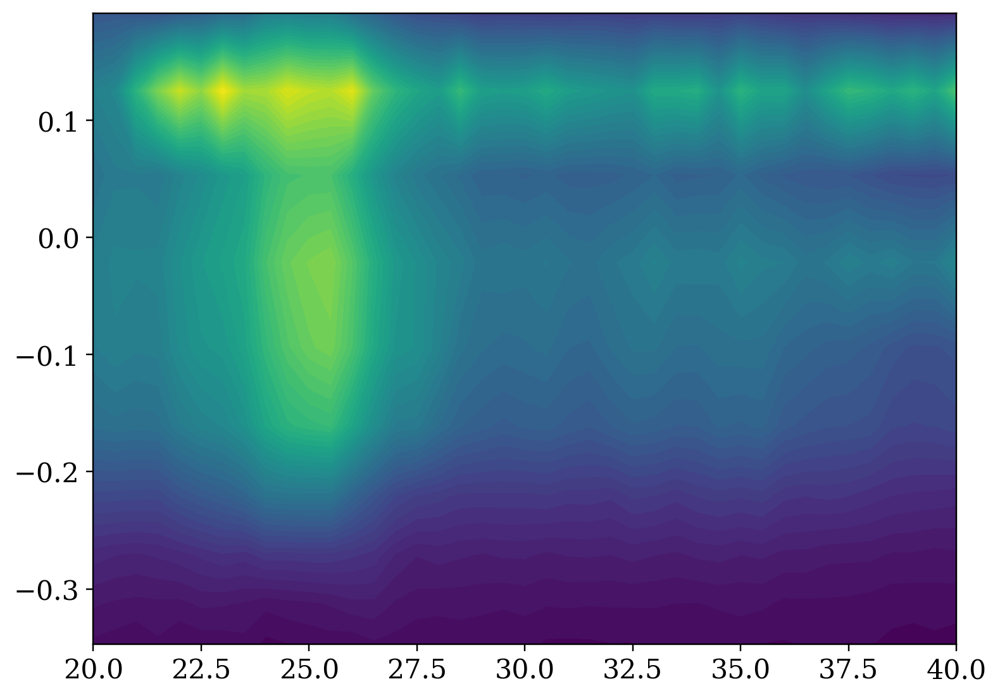

In [914]:
plt.contourf(st.time, st.p['C thin'], st.bright['C thin'], 50)

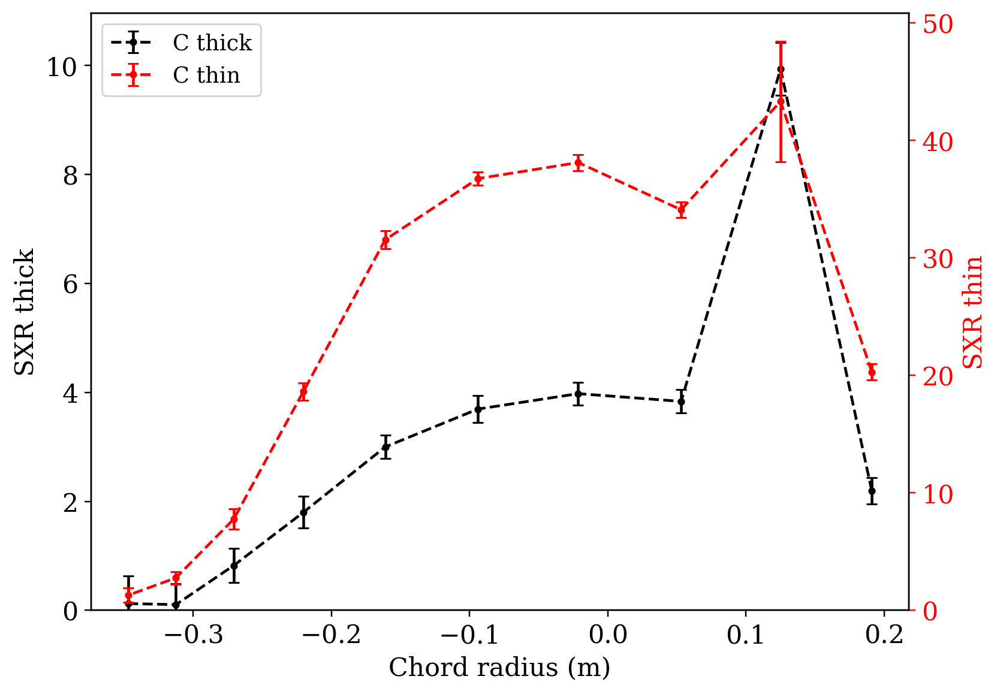

In [927]:
fig, ax1 = plt.subplots(1,1)
lns1 = ax1.errorbar(st.p['C thick'], st.bright['C thick'][:,10], yerr=st.sigma['C thick'][:,10],
                    marker='o', ms=3, capsize=3, color='black', linestyle='--', label='C thick')

ax2 = plt.twinx()
lns2 = ax2.errorbar(st.p['C thin'], st.bright['C thin'][:,10], yerr=st.sigma['C thin'][:,10],
             marker='o', ms=3, capsize=3, color='red', linestyle='--', label='C thin')

lns = [lns1, lns2]
labs = [l.get_label() for l in lns]
ax1.legend(lns, labs, loc=0)
color_axis(ax2, color='red')

ax1.set_xlabel('Chord radius (m)')
ax1.set_ylabel('SXR thick')
ax2.set_ylabel('SXR thin')
ax1.set_ylim([0,None])
ax2.set_ylim([0,None]);

In [930]:
# Figure out the channel to drop
filters = filter_list('thick')
sxt_logicals = np.concatenate([st.logical[f] for f in filters])
y_data = np.concatenate([st.bright[f][:,10] for f in filters])
log = sxt_logicals[np.argmax(y_data)]
print('SXR thin: ' + str(log))

filters = filter_list('thin')
sxt_logicals = np.concatenate([st.logical[f] for f in filters])
y_data = np.concatenate([st.bright[f][:,10] for f in filters])
log = sxt_logicals[np.argmax(y_data)]
print('SXR thin: ' + str(log))

SXR thin: 22
SXR thin: 62


Now I just want to redo a couple of the plots above to leave out the bad data point.

In [948]:
tomo = invert_brightness(shot, t_start=ts[0], t_end=ts[-1], delta=dt, smooth=10, exclude=exclude, thin=True)

% SXR_MST_BOX_GET_SIGNALS: beginning for shot #1200701056
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO signals in W/m2
% SXR_MST_BOX_GET_SIGNALS: opening MST for shot 1200701056
% Compiled module: WHOAMI.
% Compiled module: FILEBREAK.
% Compiled module: CALC_GEOM_2.
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO time base, Fri Jul 31 18:03:45 2020
% SXR_MST_BOX_GET_SIGNALS: reading SXRTOMO signals
% SXR_MST_BOX_GET_SIGNALS: assembling bright structure and transposing matrix
% SXR_MST_BOX_GET_SIGNALS: SXRTOMO done
Time=1.7797229 s
% Compiled module: WORDARRAY.
SHOT #1200701056 t=1.8865781 s


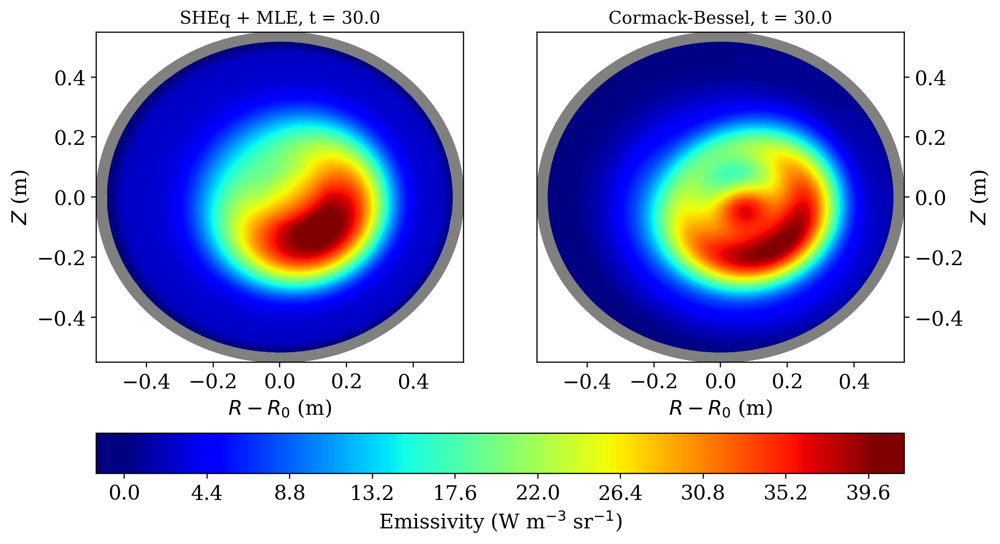

In [961]:
fig, axs = plt.subplots(1, 2, figsize=(10,6))
t = 30.0
vmax = 40
tn = np.argmin(np.abs(ts - t))

# Load the default profile
theta0 = popt_thin[tn,:]
xs, ys = sunflower_points(5000)
rs = rho_xy(xs, ys, t, label='SXT')
emiss = emiss_prof(rs, *theta0)

# SHEq/Bayes
cax1 = axs[0].tricontourf(xs, ys, emiss, 500, cmap=cm.jet, vmax=vmax, vmin=0)
axs[0].set_title('SHEq + MLE, t = {0:.1f}'.format(t))

# Tomography
vals = np.copy(tomo.emiss[:,:,tn])
xs = tomo.xs - tomo.major
ys = tomo.ys

for i,x in enumerate(xs):
    for j,y in enumerate(ys):
        if (x**2 + y**2 > 0.53**2):
            vals[i,j] = np.nan

cax = axs[1].contourf(xs, ys, vals.T, 100, cmap=cm.jet, vmax=vmax, vmin=0)
axs[1].yaxis.tick_right()
axs[1].yaxis.set_label_position("right")
axs[1].set_title('Cormack-Bessel, t = {0:.1f}'.format(t))

# Add the colorbar
cb = fig.colorbar(cax1, ax=axs, label=r'Emissivity (W m$^{-3}$ sr$^{-1}$)', orientation='horizontal')

for ax in axs:
    ax.set_xlabel('$R - R_0$ (m)')
    ax.set_ylabel('$Z$ (m)')
    overplot_shell(ax)
    ax.set_xlim([-0.55, 0.55])
    ax.set_ylim([-0.55, 0.55])

In [987]:
sxt_det = SXT(exclude=exclude)
n_chords = len(sxt_los)
filters = filter_list('thin')
sxt_los = np.concatenate([sxt_det.los[f] for f in filters])
sxt_ps = np.concatenate([sxt_det.p[f] for f in filters])
labels = np.concatenate([[f]*len(sxt_det.los[f]) for f in filters])

y_data = np.concatenate([st.bright[f][:,tn] for f in filters])
y_sigma = np.concatenate([st.sigma[f][:,tn] for f in filters])

# Build the Rhos matrix
Rhos = np.zeros([n_rs, n_chords])
Xs = np.zeros([n_rs, n_chords])
for jj, los in enumerate(sxt_los):
    a = los.intercept_with_circle(0.52)
    ells = np.linspace(-a, a, num=n_rs)
    xl, yl = los.get_xy(ells)
    Rhos[:,jj] = rho_xy(xl, yl, t, label='SXT')
    Xs[:, jj] = ells

# Explicitly limit the Rhos matrix to between 0 and 1
Rhos[Rhos < 0] = 0.0
Rhos[Rhos > 1] = 1.0

# Delta matrix for quick trapezoidal integration
Dx = np.ones(Xs.shape)
Dx[0,:] = Dx[1,:] = 0.5
for j in range(n_chords):
    Dx[:,j] *= Xs[1,j] - Xs[0,j]

y_avg = get_model(Rhos, Dx, *theta0)

# How does this compare to the Cormack-Bessel
xg, yg = np.meshgrid(tomo.xs - tomo.major, tomo.ys, indexing='ij')
sample_coords = list(zip(xg.ravel(), yg.ravel()))
emiss_tomo = Profile_2D_Spline(r'$\rho$', sample_coords, tomo.emiss[:,:,tn].ravel(), units='norm.', dim_units=['m', 'm'],
                               method='linear', boundary=1.0)

y_tomo = np.zeros(y_avg.shape)
for jj, los in enumerate(sxt_los):
    a = los.intercept_with_circle(0.52)
    ells = np.linspace(-a, a, num=n_rs)
    xl, yl = los.get_xy(ells)
    y_tomo[jj] = np.trapz(emiss_tomo(xl,yl), x=ells)

In [996]:
chi2_avg = np.sum((y_data - y_avg)**2 / y_sigma**2)
chi2_tomo = np.sum((y_data - y_tomo)**2 / y_sigma**2)
red_chi2_avg = chi2_avg / (len(y_avg) - 5)
red_chi2_tomo = chi2_tomo / (len(y_avg) - 35)

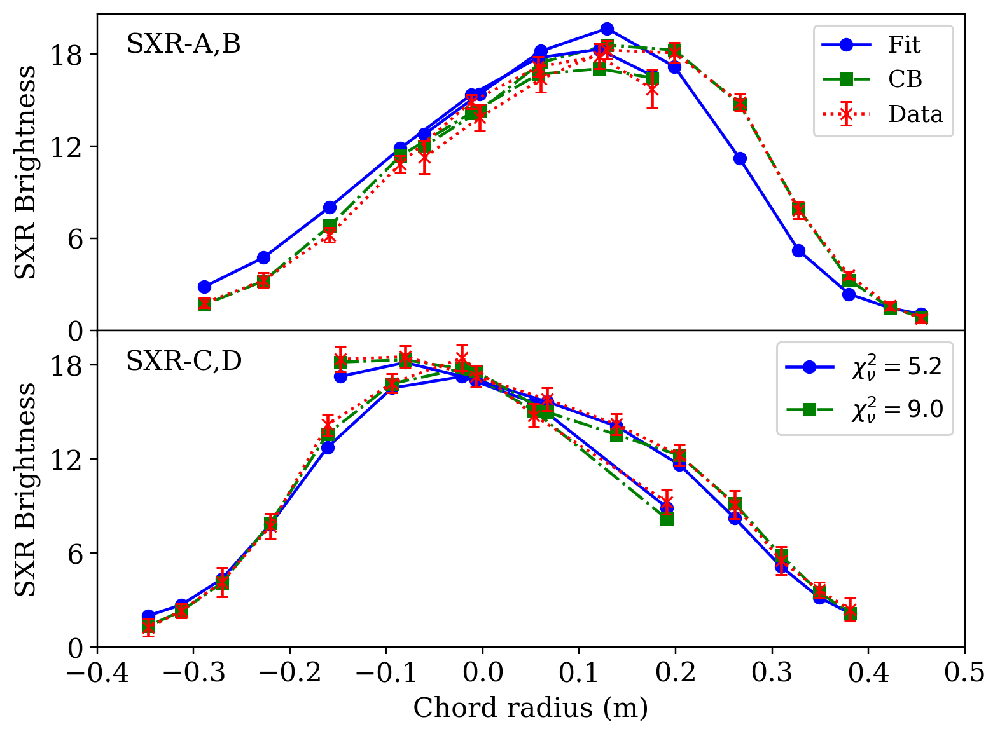

In [998]:
# Use labels to plot more physically
fig, axs = plt.subplots(2,1)

# SXR-A,B
ii, = np.where(labels == 'A thin')
axs[0].errorbar(sxt_ps[ii], y_data[ii], yerr=y_sigma[ii], marker='x', color='red', capsize=3, linestyle=':', label='Data', zorder=100)
axs[0].plot(sxt_ps[ii], y_avg[ii], color='blue', linestyle='-', marker='o', label='Fit')
axs[0].plot(sxt_ps[ii], y_tomo[ii], color='green', linestyle='-.',marker='s', label='CB')

ii, = np.where(labels == 'B thin')
axs[0].errorbar(sxt_ps[ii], y_data[ii], yerr=y_sigma[ii], marker='x', color='red', capsize=3, linestyle=':', zorder=100)
axs[0].plot(sxt_ps[ii], y_avg[ii], color='blue', linestyle='-', marker='o')
axs[0].plot(sxt_ps[ii], y_tomo[ii], color='green', linestyle='-.',marker='s')

# SXR-C,D
ii, = np.where(labels == 'C thin')
axs[1].errorbar(sxt_ps[ii], y_data[ii], yerr=y_sigma[ii], marker='x', color='red', capsize=3, linestyle=':', zorder=100)
axs[1].plot(sxt_ps[ii], y_avg[ii], color='blue', linestyle='-', marker='o', label=r'$\chi^2_\nu = {0:.1f}$'.format(red_chi2_avg))
axs[1].plot(sxt_ps[ii], y_tomo[ii], color='green', linestyle='-.',marker='s', label=r'$\chi^2_\nu = {0:.1f}$'.format(red_chi2_tomo))

ii, = np.where(labels == 'D thin')
axs[1].errorbar(sxt_ps[ii], y_data[ii], yerr=y_sigma[ii], marker='x', color='red', capsize=3, linestyle=':', zorder=100)
axs[1].plot(sxt_ps[ii], y_avg[ii], color='blue', linestyle='-', marker='o')
axs[1].plot(sxt_ps[ii], y_tomo[ii], color='green', linestyle='-.',marker='s')

# Add labels
text(0.1, 0.9, 'SXR-A,B', axs[0], fontsize=14)
text(0.1, 0.9, 'SXR-C,D', axs[1], fontsize=14)

# Format the axes
axs[0].legend()
axs[1].legend()
axs[0].xaxis.set_ticklabels([])

for ax in axs:
    ax.set_xlim([-0.4, 0.5])
    ax.set_ylim([0,None])
    ax.set_ylabel('SXR Brightness')
    ax.yaxis.set_major_locator(MaxNLocator(nbins=4, prune='upper'))

axs[-1].set_xlabel('Chord radius (m)')
plt.subplots_adjust(wspace=0, hspace=0);

## Looking at the emissivity ratio

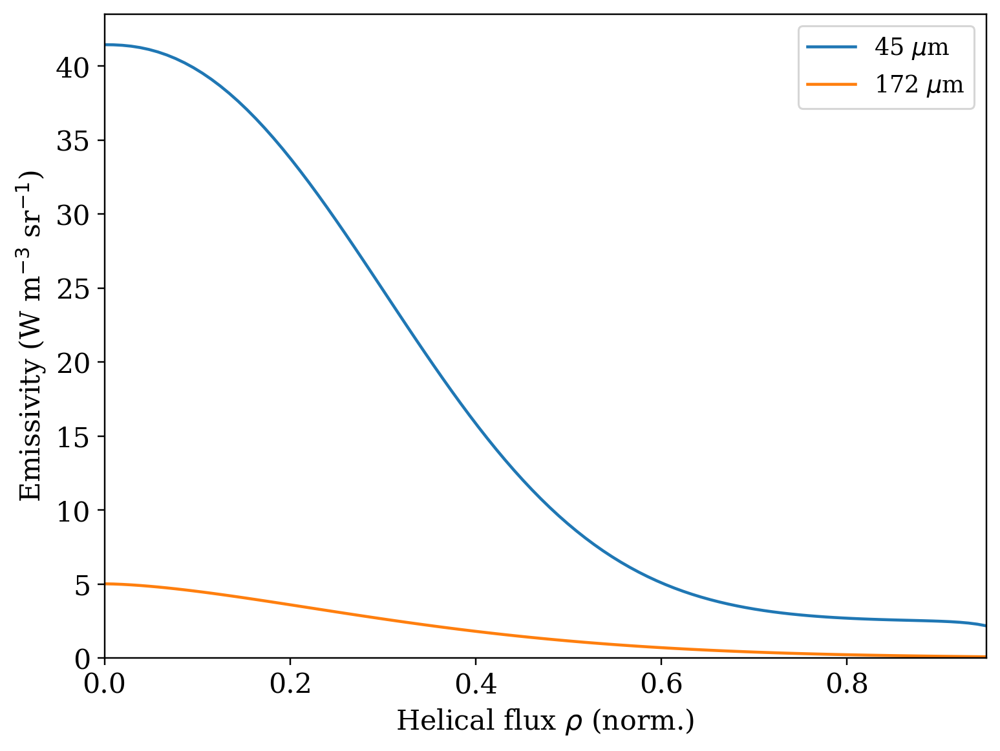

In [1019]:
t = 30.0
tn = np.argmin(np.abs(ts - t))

rs = np.linspace(0, 0.95, num=100)
emiss_45 = emiss_prof(rs, *popt_thin[tn,:])
emiss_172 = emiss_prof(rs, *popt_thick[tn,:])

plt.plot(rs, emiss_45, label=r'45 $\mu$m')
plt.plot(rs, emiss_172, label=r'172 $\mu$m')

plt.legend()
plt.xlabel(r'Helical flux $\rho$ (norm.)')
plt.ylabel(r'Emissivity (W m$^{-3}$ sr$^{-1}$)')
plt.xlim([0,0.95])
plt.ylim([0,None]);

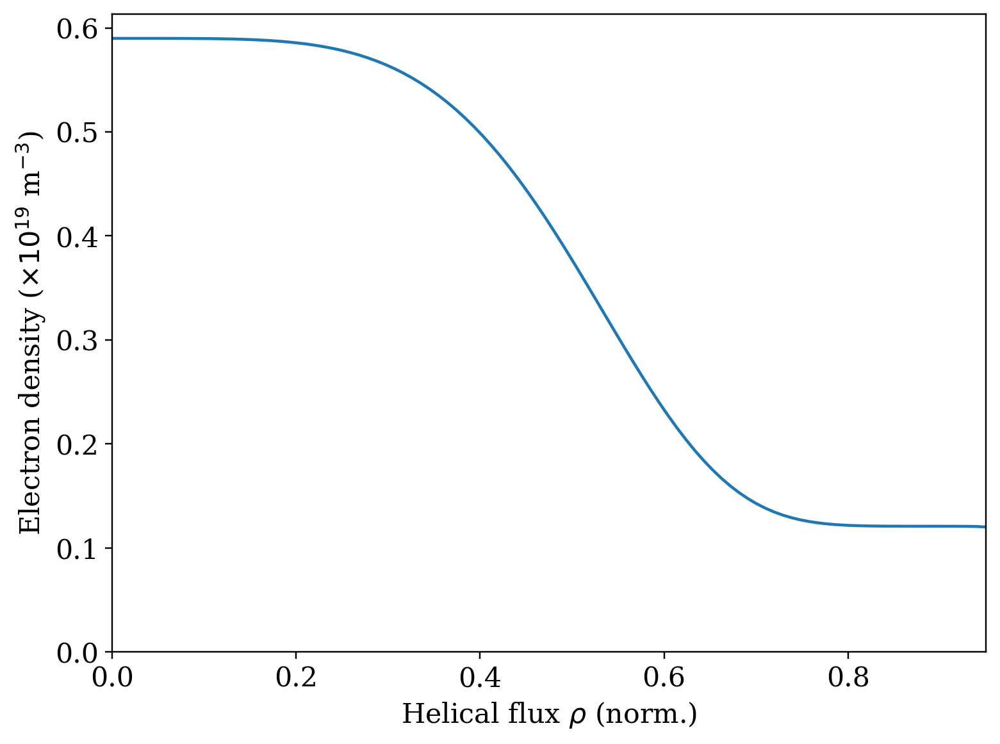

In [1022]:
nes = ne_prof(rs, *popt_set_dens[tn,:], gamma=100.)
plt.plot(rs, nes)

plt.xlabel(r'Helical flux $\rho$ (norm.)')
plt.ylabel(r'Electron density ($\times 10^{19}$ m$^{-3}$)')
plt.xlim([0,0.95])
plt.ylim([0,None]);

(0.0, 0.14435413002467434)

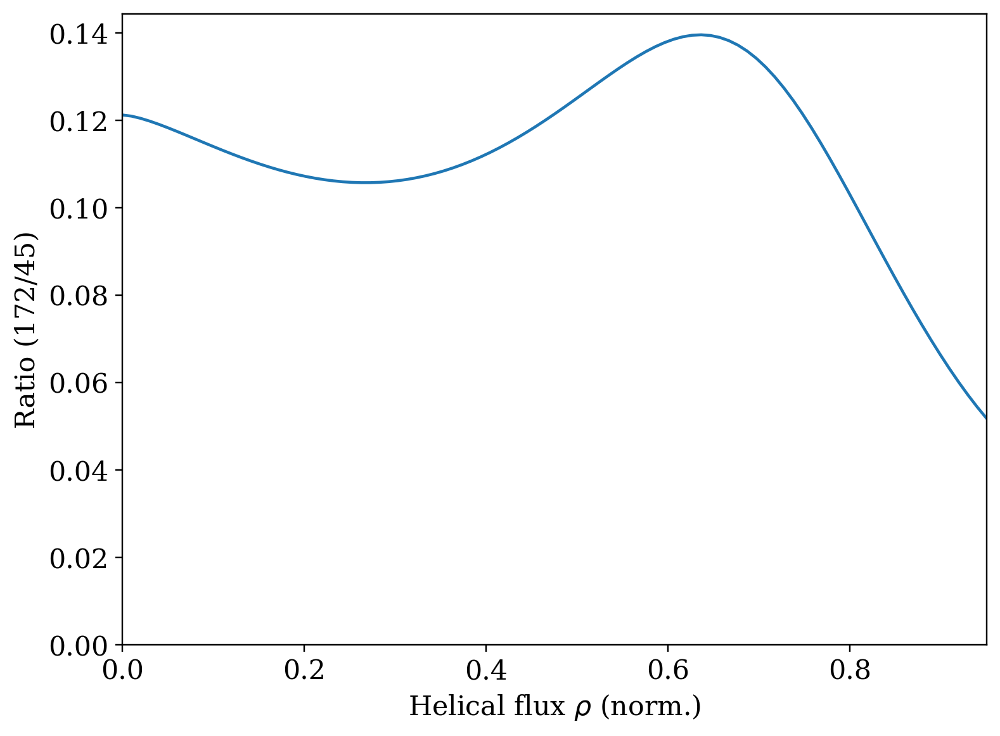

In [1007]:
ratios = emiss_172 / emiss_45

plt.plot(ps, ratios)
plt.xlabel(r'Helical flux $\rho$ (norm.)')
plt.ylabel('Ratio (172/45)')
plt.xlim([0,0.95])
plt.ylim([0,None])

For now, I'm just going to guess some profiles for $n_0$ and the various $n_Z$'s. This can be refined later. I'll stick with these 

In [1021]:
n0_params=np.array([2.0, 10.0, 450.0, 0.6])

def n0_prof(rs, nH_0, nH_rm, nH_1, rm):
    core_value = nH_0
    amp = nH_1 - nH_0
    power = np.log( (nH_rm - nH_0)/(nH_1 - nH_0) ) / np.log(rm)
    return core_value + amp*( rs**power )

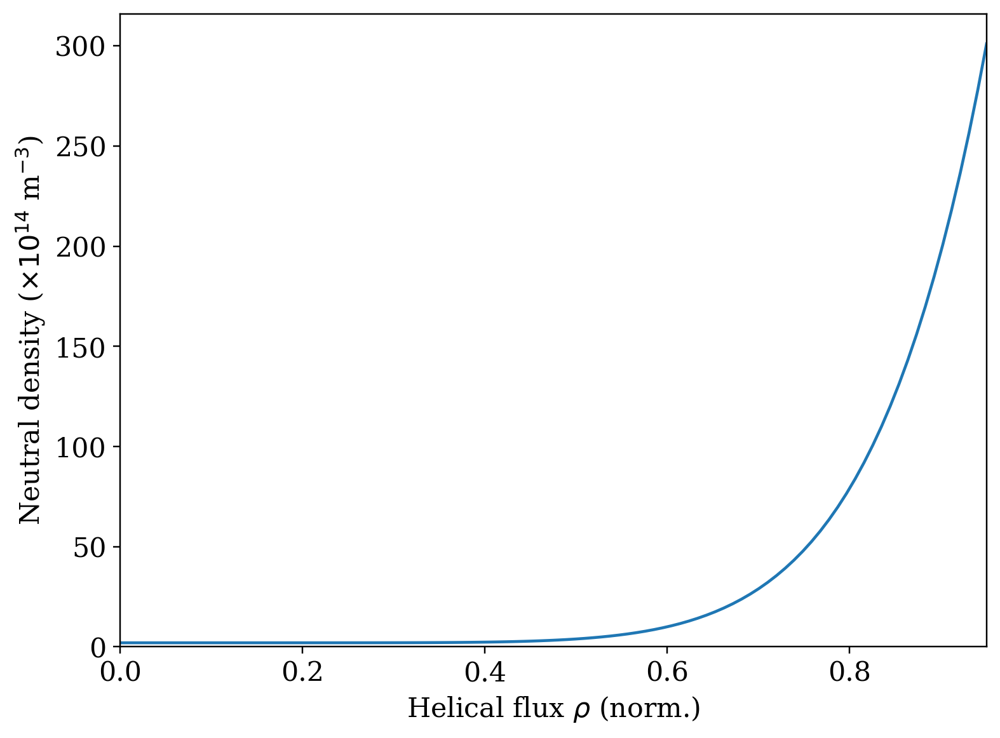

In [1024]:
n0s = n0_prof(rs, *n0_params)
plt.plot(rs, n0s)

plt.xlabel(r'Helical flux $\rho$ (norm.)')
plt.ylabel(r'Neutral density ($\times 10^{14}$ m$^{-3}$)')
plt.xlim([0,0.95])
plt.ylim([0,None]);

In [1197]:
def nZ_prof(rs, nZ0, alpha_Z, beta_Z):
    return nZ0*(1 - rs**alpha_Z)**beta_Z

def get_nZ_profs(rs, nAl0, nC0, alpha_Z, beta_Z):
    nAl_rs = nZ_prof(rs, nAl0, alpha_Z, beta_Z)
    nC_rs = nZ_prof(rs, nC0, alpha_Z, beta_Z)
    nZ_rs = {'Al':nAl_rs, 'C':nC_rs, 'N':0.3*nC_rs, 'B':0.3*nC_rs, 'O':0.9*nC_rs}
    return nZ_rs

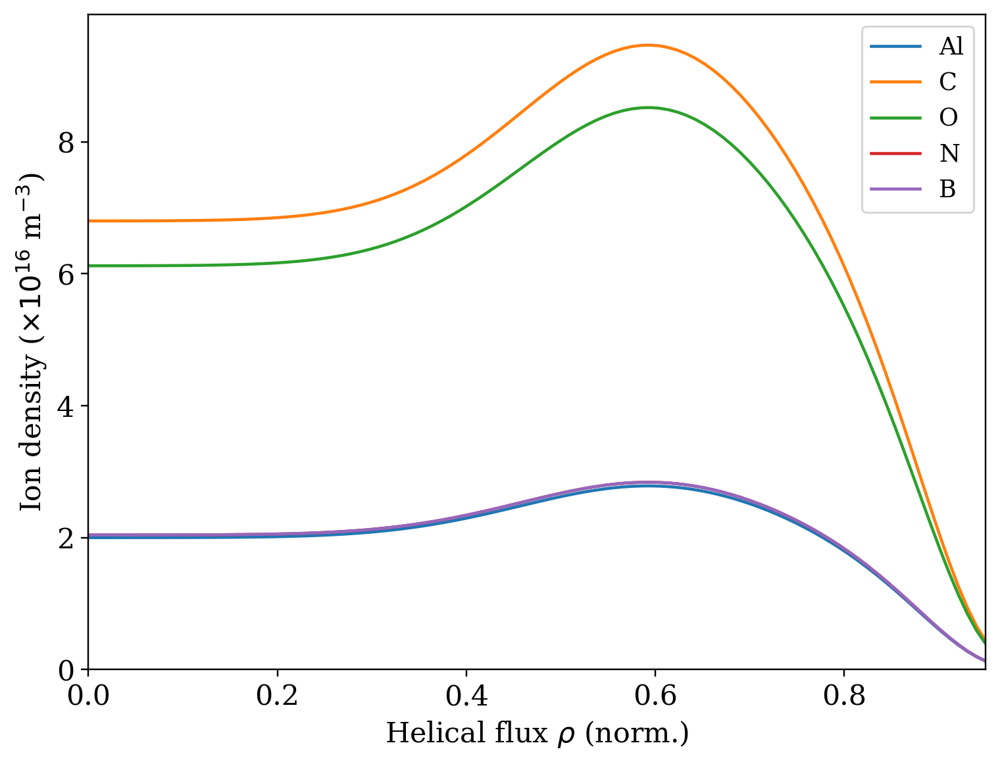

In [1194]:
ions = ['Al', 'C', 'O', 'N', 'B']
nAl0 = 2.0e-3
nC0 = 6.8e-3
alpha_Z = 12.0
beta_Z = 4.0
nZs = get_nZ_profs(rs, nAl0, nC0, alpha_Z, beta_Z)

for ion in ions:
    plt.plot(rs, nZs[ion]*1e3, label=ion)

plt.legend()
plt.xlabel(r'Helical flux $\rho$ (norm.)')
plt.ylabel(r'Ion density ($\times 10^{16}$ m$^{-3}$)')
plt.xlim([0,0.95])
plt.ylim([0,None]);

## Slightly modified approach - fit the inverted emissivity

In order to keep things simple, for now I will assume that $n_D = n_e$. It's not quite right, but shouldn't affect the results by too much

In [1061]:
# Use the emissivity database to do the work
impurities = ['Al', 'C', 'O', 'N', 'B']
fname = 'nickal2_sxt_emiss.pkl'
emiss_dir = '/home/pdvanmeter/data/ADAS/'

fpath = os.path.join(emiss_dir, fname)
with open(fpath, 'rb') as f:
    emiss_db = pickle.load(f, encoding='latin1')

Te_set = emiss_db['axes']['Te']
ne_set = emiss_db['axes']['ne']
n0_set = emiss_db['axes']['n0']

emiss_sxr = {'45um':{}, '172um':{}}
for key in emiss_sxr.keys():
    emiss_sxr[key]['D'] = np.swapaxes(emiss_db['SXT'][key]['H'], 0, 1)
    for ion in impurities:
        emiss_sxr[key][ion] = np.swapaxes(emiss_db['SXT'][key][ion], 0, 1)

In [1065]:
t = 30.0
tn = np.argmin(np.abs(ts - t))
rs = np.linspace(0, 0.95, num=100)

emiss_45 = emiss_prof(rs, *popt_thin[tn,:])
emiss_172 = emiss_prof(rs, *popt_thick[tn,:])

# Get density from previous results
nes = ne_prof(rs, *popt_set_dens[tn,:], gamma=100.)

# Set profiles
n0s = n0_prof(rs, *n0_params)
nZs = get_nZ_profs(rs, nAl0, nC0, alpha_Z, beta_Z)
nZs['D'] = np.copy(nes)

# Look at the emissivity for a specific spatial index
rn = 0
ii = np.argmin(np.abs(nes[rn] - ne_set))
jj = np.argmin(np.abs(n0s[rn] - n0_set))

ions = ['Al', 'C', 'O', 'N', 'B', 'D']
const = 1e19 * 1e19
emiss_Te_45 = np.zeros(Te_set.shape)
emiss_Te_172 = np.zeros(Te_set.shape)

for ion in ions:
    emiss_Te_45 += const * nes[rn] * nZs[ion][rn] * emiss_sxr['45um'][ion][:, ii, jj]
    emiss_Te_172 += const * nes[rn] * nZs[ion][rn] * emiss_sxr['172um'][ion][:, ii, jj]

In [1081]:
temp_45 = Te_set[np.argmin(np.abs(emiss_Te_45 - emiss_45[0]))]
temp_172 = Te_set[np.argmin(np.abs(emiss_Te_172 - emiss_172[0]))]

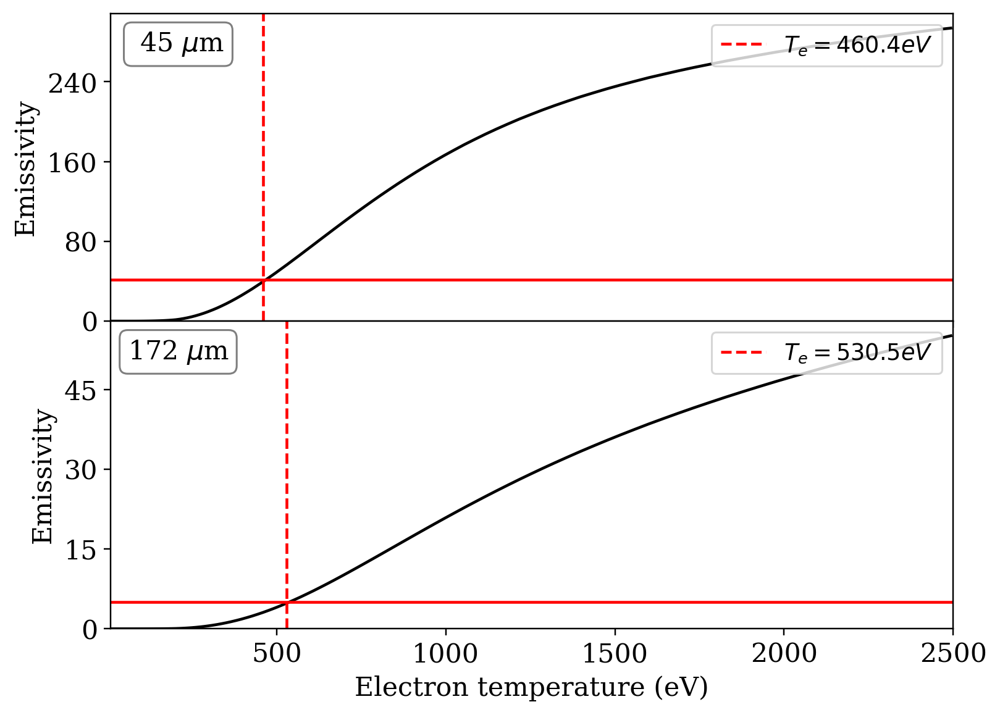

In [1086]:
# Use labels to plot more physically
fig, axs = plt.subplots(2,1)

axs[0].plot(Te_set, emiss_Te_45, color='black')
axs[0].axhline(y=emiss_45[0], color='red', linestyle='-')
axs[0].axvline(x=temp_45, color='red', linestyle='--', label=r'$T_e = {0:.1f} eV$'.format(temp_45))
text(0.08, 0.9, r' 45 $\mu$m', axs[0], fontsize=14, color='black', bbox=props)

axs[1].plot(Te_set, emiss_Te_172, color='black')
axs[1].axhline(y=emiss_172[0], color='red', linestyle='-')
axs[1].axvline(x=temp_172, color='red', linestyle='--', label=r'$T_e = {0:.1f} eV$'.format(temp_172))
text(0.08, 0.9, r'172 $\mu$m', axs[1], fontsize=14, color='black', bbox=props)

# Format the axes
axs[0].xaxis.set_ticklabels([])

for ax in axs:
    ax.legend(loc='upper right')
    ax.set_xlim([10, 2500])
    ax.set_ylim([0, None])
    ax.set_ylabel(r'Emissivity')
    ax.yaxis.set_major_locator(MaxNLocator(nbins=4, prune='upper'))

axs[-1].set_xlabel('Electron temperature (eV)')
plt.subplots_adjust(wspace=0, hspace=0);

I should be able to pring the two measurements into agreement by treating $(T_e, n_{Al})$ as a pair of free parameters.

In [1094]:
nAl_set = np.linspace(1e-4, 8e-3, num=101)
emiss_table = {
    '45um':np.zeros([len(Te_set), len(nAl_set)]),
    '172um':np.zeros([len(Te_set), len(nAl_set)])
}

rn = 0
ii = np.argmin(np.abs(nes[rn] - ne_set))
jj = np.argmin(np.abs(n0s[rn] - n0_set))

ne = nes[rn]
n0 = n0s[rn]

ions = ['C', 'O', 'N', 'B', 'D']
nZ = {ion:nZs[ion][rn] for ion in ions}

const = 1e19 * 1e19
emiss_base_45 = np.zeros(Te_set.shape)
emiss_base_172 = np.zeros(Te_set.shape)
for ion in ions:
    emiss_base_45 += const * nes[rn] * nZs[ion][rn] * emiss_sxr['45um'][ion][:, ii, jj]
    emiss_base_172 += const * nes[rn] * nZs[ion][rn] * emiss_sxr['172um'][ion][:, ii, jj]
    
for j, nAl in enumerate(nAl_set):
    emiss_table['45um'][:,j] = emiss_base_45 + const * nAl * ne * emiss_sxr['45um']['Al'][:, ii, jj]
    emiss_table['172um'][:,j] = emiss_base_172 + const * nAl * ne * emiss_sxr['172um']['Al'][:, ii, jj]

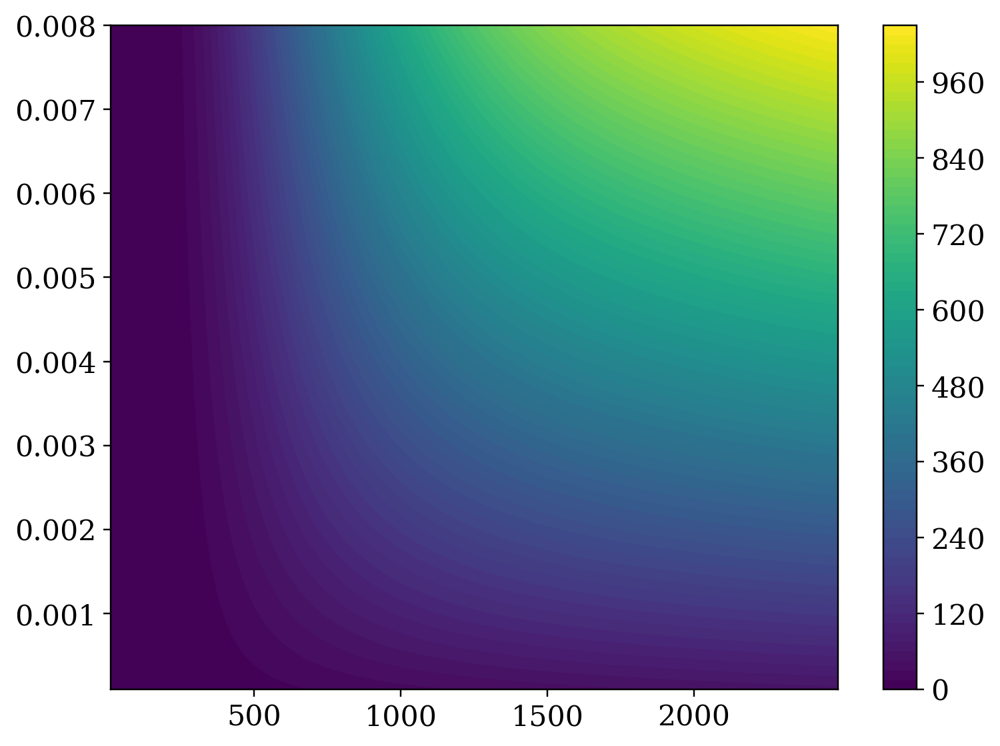

In [1100]:
cax = plt.contourf(Te_set, nAl_set, emiss_table['45um'].T, 100)
plt.colorbar(cax)

In [1108]:
prob_45 = np.exp( -(emiss_table['45um'] - emiss_45[0])**2 / 5.0**2 )
prob_172 = np.exp( -(emiss_table['172um'] - emiss_172[0])**2 / 5.0**2 )
prob_joint = prob_45 * prob_172

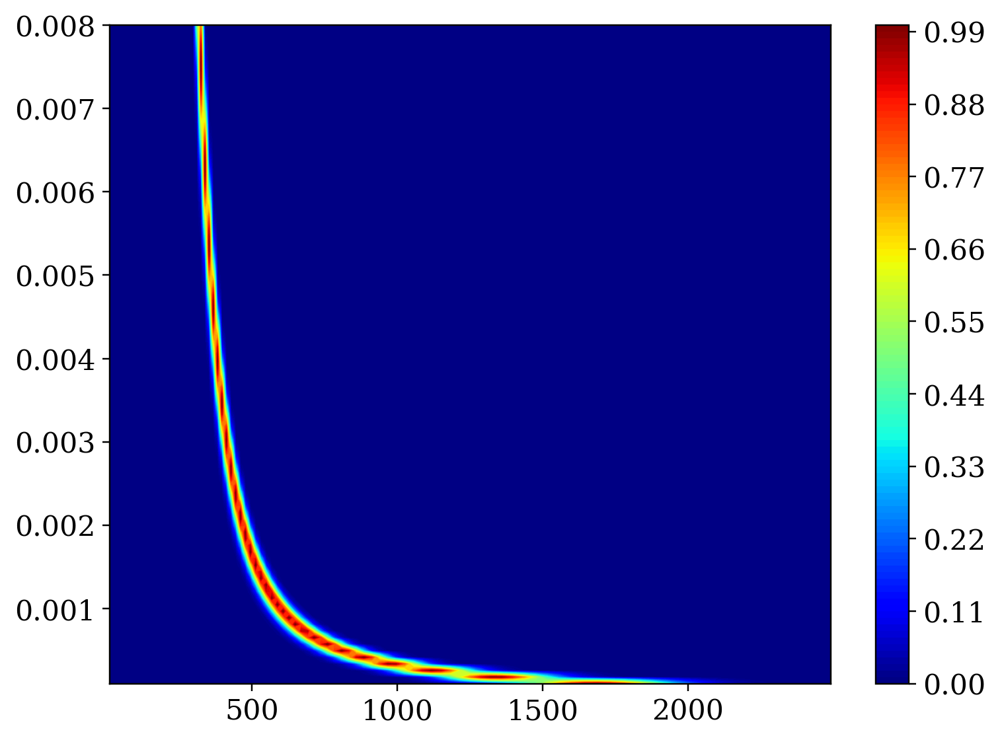

In [1106]:
cax = plt.contourf(Te_set, nAl_set, prob_45.T, 100, cmap=cm.jet)
plt.colorbar(cax)

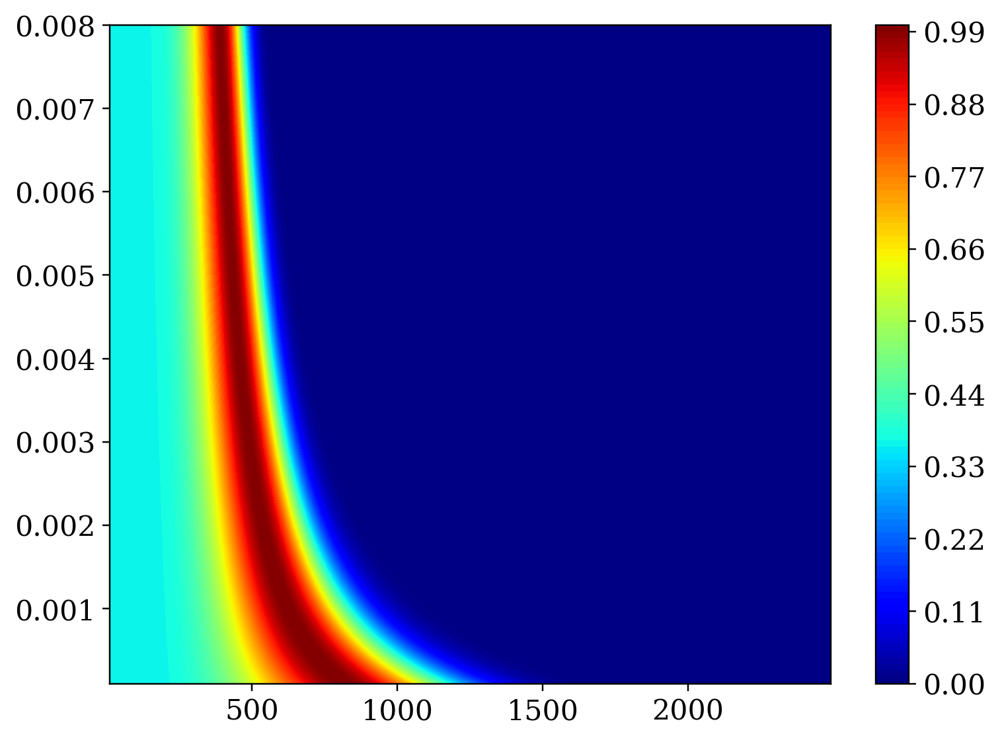

In [1107]:
cax = plt.contourf(Te_set, nAl_set, prob_172.T, 100, cmap=cm.jet)
plt.colorbar(cax)

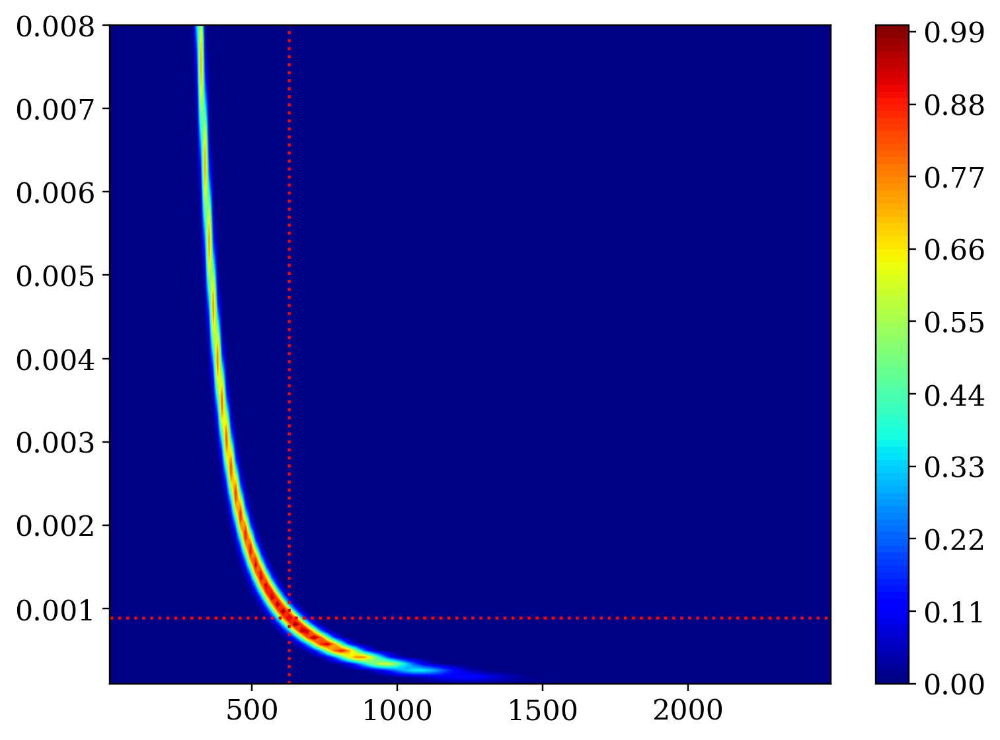

In [1121]:
cax = plt.contourf(Te_set, nAl_set, prob_joint.T, 100, cmap=cm.jet)
plt.colorbar(cax)

plt.axvline(x=Te_max, color='red', linestyle=':')
plt.axhline(y=nAl_max, color='red', linestyle=':')

In [1122]:
i_Te, i_nAl = np.unravel_index(prob_joint.argmax(), prob_joint.shape)
Te_max = Te_set[i_Te]
nAl_max = nAl_set[i_nAl]

j_nAl = np.argmin(np.abs(nAl_set - nAl_max))

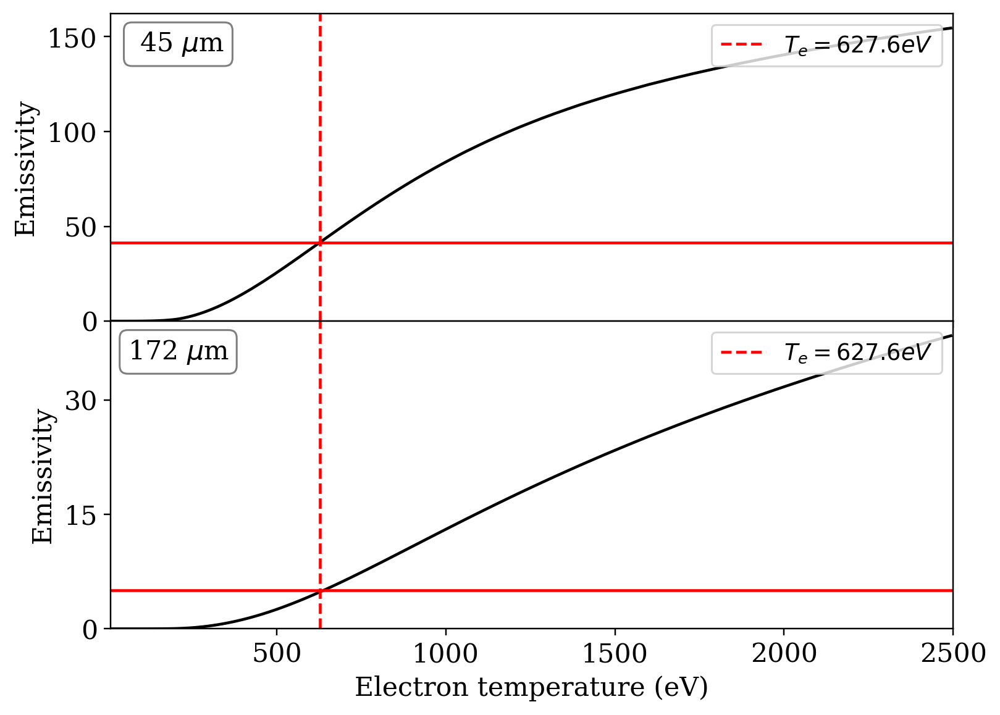

In [1124]:
# Use labels to plot more physically
fig, axs = plt.subplots(2,1)

axs[0].plot(Te_set, emiss_table['45um'][:,j_nAl], color='black')
axs[0].axhline(y=emiss_45[0], color='red', linestyle='-')
axs[0].axvline(x=Te_max, color='red', linestyle='--', label=r'$T_e = {0:.1f} eV$'.format(Te_max))
text(0.08, 0.9, r' 45 $\mu$m', axs[0], fontsize=14, color='black', bbox=props)

axs[1].plot(Te_set, emiss_table['172um'][:,j_nAl], color='black')
axs[1].axhline(y=emiss_172[0], color='red', linestyle='-')
axs[1].axvline(x=Te_max, color='red', linestyle='--', label=r'$T_e = {0:.1f} eV$'.format(Te_max))
text(0.08, 0.9, r'172 $\mu$m', axs[1], fontsize=14, color='black', bbox=props)

# Format the axes
axs[0].xaxis.set_ticklabels([])

for ax in axs:
    ax.legend(loc='upper right')
    ax.set_xlim([10, 2500])
    ax.set_ylim([0, None])
    ax.set_ylabel(r'Emissivity')
    ax.yaxis.set_major_locator(MaxNLocator(nbins=4, prune='upper'))

axs[-1].set_xlabel('Electron temperature (eV)')
plt.subplots_adjust(wspace=0, hspace=0);

 Now, let's do this for the entire radius - single-filter/fixed-Al only for now.

In [1198]:
t = 30.0
tn = np.argmin(np.abs(ts - t))
rs = np.linspace(0, 0.95, num=100)

emiss_45 = emiss_prof(rs, *popt_thin[tn,:])
emiss_172 = emiss_prof(rs, *popt_thick[tn,:])

# Get density from previous results
nes = ne_prof(rs, *popt_set_dens[tn,:], gamma=100.)

# Set profiles
n0s = n0_prof(rs, *n0_params)

nAl0 = 0.9e-3 #2.0e-3
nC0 = 6.8e-3
alpha_Z = 12.0
beta_Z = 4.0
nZs = get_nZ_profs(rs, nAl0, nC0, alpha_Z, beta_Z)
nZs['D'] = np.copy(nes)

# Containers for the results
temp_45 = np.zeros(rs.shape)
temp_172 = np.zeros(rs.shape)

curves = []

for rn in range(len(rs)):
    y_45 = np.maximum(emiss_45[rn] - popt_thin[tn,0], 0.0)
    y_172 = np.maximum(emiss_172[rn] - popt_thick[tn,0], 0.0)
    
    # Indices for the lookup table
    ii = np.argmin(np.abs(nes[rn] - ne_set))
    jj = np.argmin(np.abs(n0s[rn] - n0_set))

    ions = ['Al', 'C', 'O', 'N', 'B', 'D']
    const = 1e19 * 1e19
    emiss_curve_45 = np.zeros(Te_set.shape)
    emiss_curve_172 = np.zeros(Te_set.shape)

    for ion in ions:
        emiss_curve_45 += const * nes[rn] * nZs[ion][rn] * emiss_sxr['45um'][ion][:, ii, jj]
        emiss_curve_172 += const * nes[rn] * nZs[ion][rn] * emiss_sxr['172um'][ion][:, ii, jj]
    
    # Interpolate on the emiss_curve
    temps = np.linspace(0, 1000, num=50000)
    emiss_curve_45_hd = np.interp(temps, Te_set, emiss_curve_45)
    emiss_curve_172_hd = np.interp(temps, Te_set, emiss_curve_172)
    temp_45[rn] = temps[np.argmin(np.abs(emiss_curve_45_hd - y_45))]
    temp_172[rn] = temps[np.argmin(np.abs(emiss_curve_172_hd - y_172))]
    
    curves.append(emiss_curve_45_hd)

(0.0, 800.0)

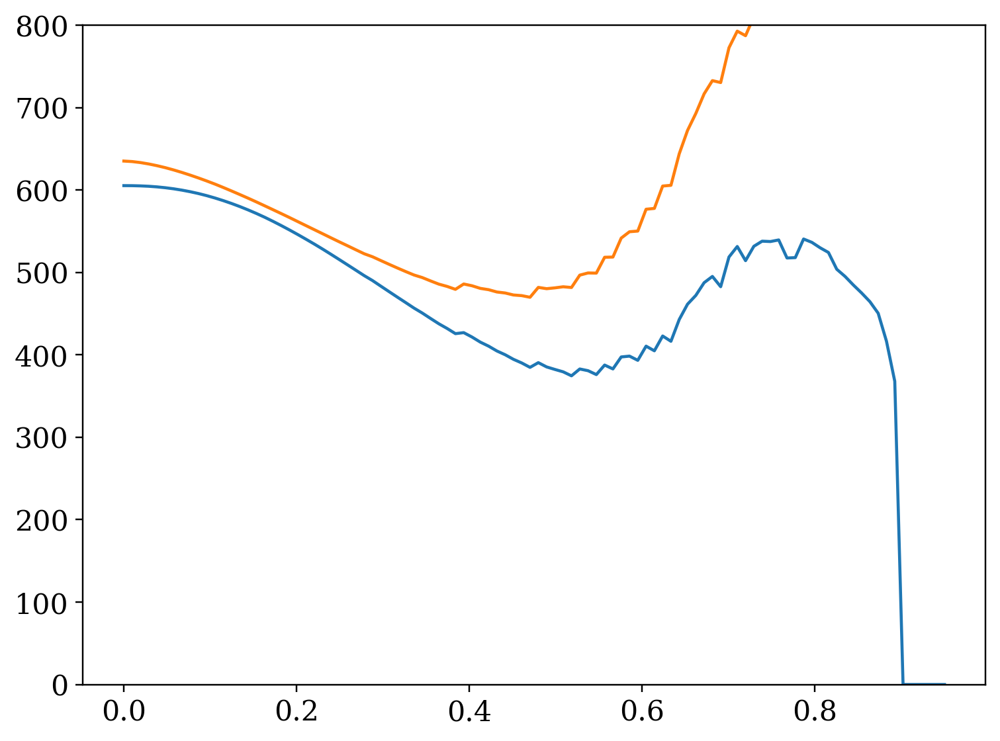

In [1199]:
plt.plot(rs, temp_45)
plt.plot(rs, temp_172)
plt.ylim([0,800])

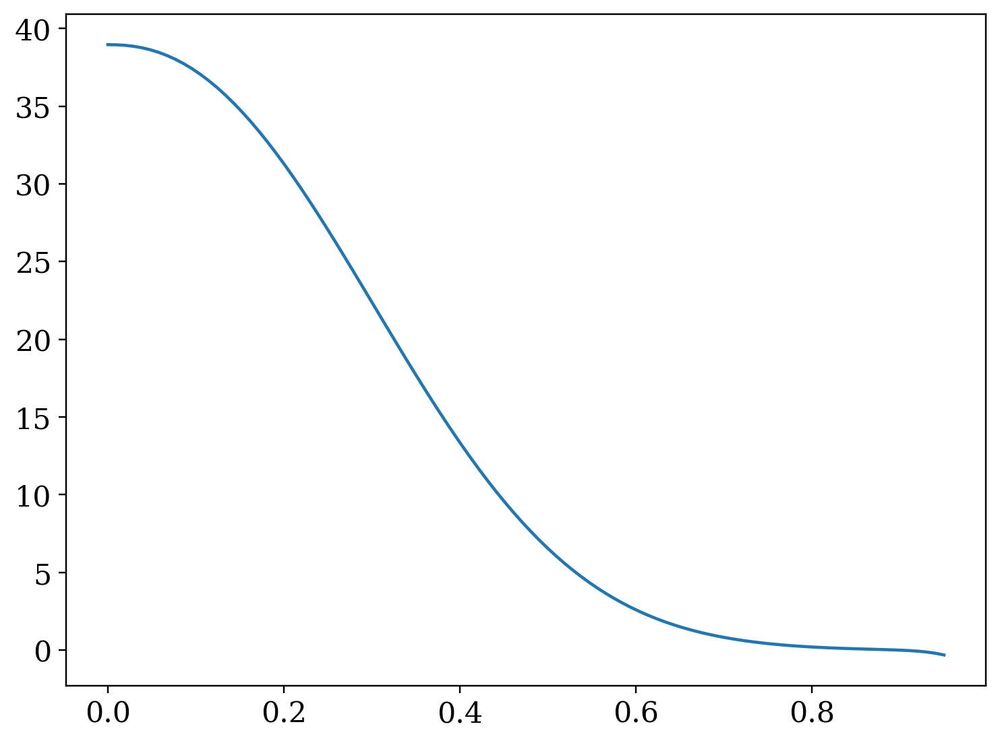

In [1159]:
plt.plot(rs, emiss_45 - popt_thin[tn,0])

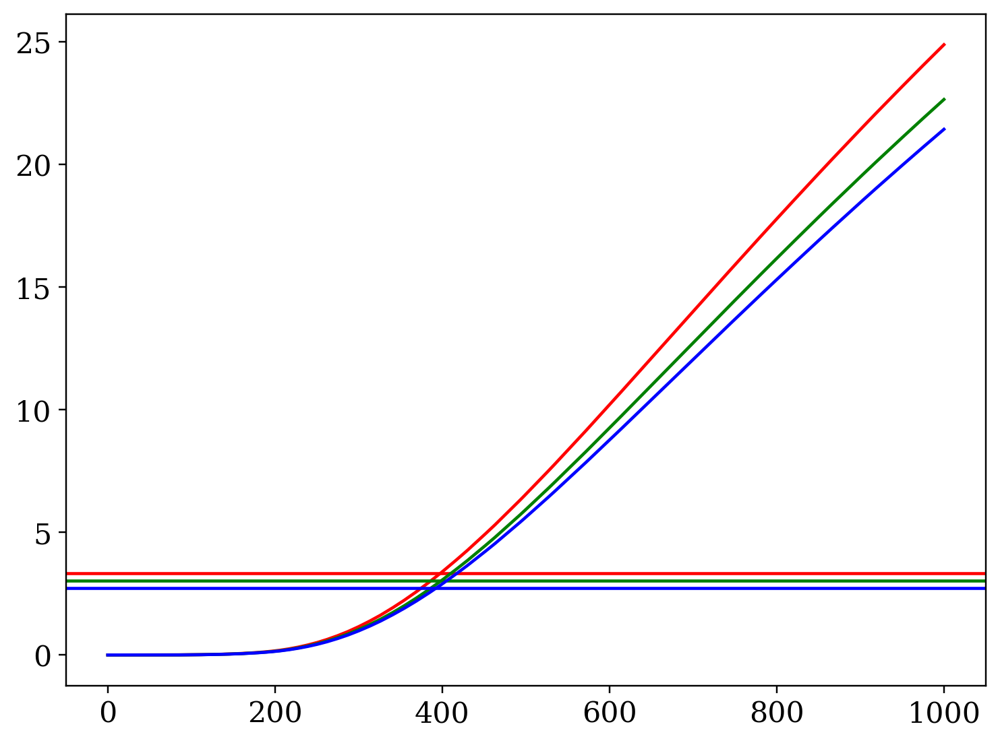

In [1184]:
for rn, color in zip([60, 61, 62], ['red','green','blue']):
    plt.plot(temps, curves[rn], color=color)
    y_45 = np.maximum(emiss_45[rn] - popt_thin[tn,0], 0.0)
    plt.axhline(y=y_45, color=color)

## Ok... I want to compare model emissivity vs the data

In [1248]:
# All of the profiles
def ne_prof(rs, n0, n1, alpha, beta, gamma=100.):
    dens = (n0 - n1) * (1 - rs**alpha)**beta + n1 * (1 - rs**gamma)
    return np.maximum(dens, 0.0)

def n0_prof(rs, nH_0, nH_rm, nH_1, rm):
    core_value = nH_0
    amp = nH_1 - nH_0
    power = np.log( (nH_rm - nH_0)/(nH_1 - nH_0) ) / np.log(rm)
    return core_value + amp*( rs**power )

def nZ_prof(rs, nZ0, alpha_Z, beta_Z):
    return nZ0*(1 - rs**alpha_Z)**beta_Z

def get_nZ_profs(rs, nAl0, nC0, alpha_Z, beta_Z):
    nAl_rs = nZ_prof(rs, nAl0, alpha_Z, beta_Z)
    nC_rs = nZ_prof(rs, nC0, alpha_Z, beta_Z)
    nZ_rs = {'Al':nAl_rs, 'C':nC_rs, 'N':0.3*nC_rs, 'B':0.3*nC_rs, 'O':0.9*nC_rs}
    return nZ_rs

def temp_prof(rs, Te0, Te1, alpha, beta, gamma=100.):
    temp = Te0 * (1 - rs**alpha)**beta + Te1 * (1 - rs**gamma)
    return np.maximum(temp, 0.0)

def temp_prof_v2(rs, Te0, Te1, alpha, beta, dr):
    return Te0 * (1 - rs**alpha) + Te1 * np.exp( -(rs/dr)**beta)

In [1255]:
from mst_ida.models.sxt import SXT
from mst_ida.models.plasma import get_avg_Z

sxt_model = SXT(exclude=exclude)
filters = filter_list('thin')
sxt_los = np.concatenate([sxt_model.los[f] for f in filters])
sxt_ps = np.concatenate([sxt_model.p[f] for f in filters])
labels = np.concatenate([[f]*len(sxt_model.los[f]) for f in filters])

t = 25.0
tn = np.argmin(np.abs(ts - t))

# Fixed profiles
n0_params = np.array([2.0, 10.0, 450.0, 0.6])
ne_params = popt_dens[tn,:]

# Fixed parameters
ions = ['Al', 'C', 'O', 'N', 'B']
alpha_T = 12.0
alpha_Z = 12.0
beta_Z = 4.0
gamma = 100.0

# Galante priors
mu_Al = 2.0e-3
mu_C = 6.8e-3
sigma_Al = 0.5e-3
sigma_C = 1.4e-3

# Default vector
#x0 = np.array([500.0, 100.0, 5.0, 10.0])
x0 = np.array([100., 500., 4.0, 10.0, 0.4])

def get_emiss(Rhos, theta):
    Te_params = theta
    nZ_params = np.array([mu_Al, mu_C, alpha_Z, beta_Z])
    
    # Calculate the base plasma parameters
    Te_rs = temp_prof_v2(Rhos, *Te_params)
    nZ_rs = get_nZ_profs(Rhos, *nZ_params)
    ne_rs = ne_prof(Rhos, *ne_params, gamma=gamma) + 1e-6
    n0_rs = n0_prof(Rhos, *n0_params)
    pts = list( zip( Te_rs.ravel(), ne_rs.ravel(), n0_rs.ravel() ) )

    # Get avg_Z and nD
    avg_Z = get_avg_Z()
    avg_Z_rs = {ion:np.reshape(avg_Z[ion](pts), Rhos.shape) for ion in ions}
    
    nD_rs = np.ones(Rhos.shape)
    for ion in ions:
        nD_rs -= (nZ_rs[ion]/ne_rs)*avg_Z_rs[ion]
    nD_rs *= ne_rs
    nD_rs[nD_rs < 0] = 0.0

    # Get the emissivity
    emiss_rs = {filt:np.zeros(Rhos.shape) for filt in ['thick', 'thin']}
    for filt in ['thick', 'thin']:
        emiss_rs[filt] = ne_rs * nD_rs * np.reshape(sxt_model.emiss['D'][filt](pts), Rhos.shape)
        for ion in ions:
            emiss_rs[filt] += ne_rs * nZ_rs[ion] * np.reshape(sxt_model.emiss[ion][filt](pts), Rhos.shape)

        emiss_rs[filt] *= 1e19 * 1e19
    
    # Add background to thin filters
    for ion in ions:
        emiss_rs['thin']
    
    return emiss_rs

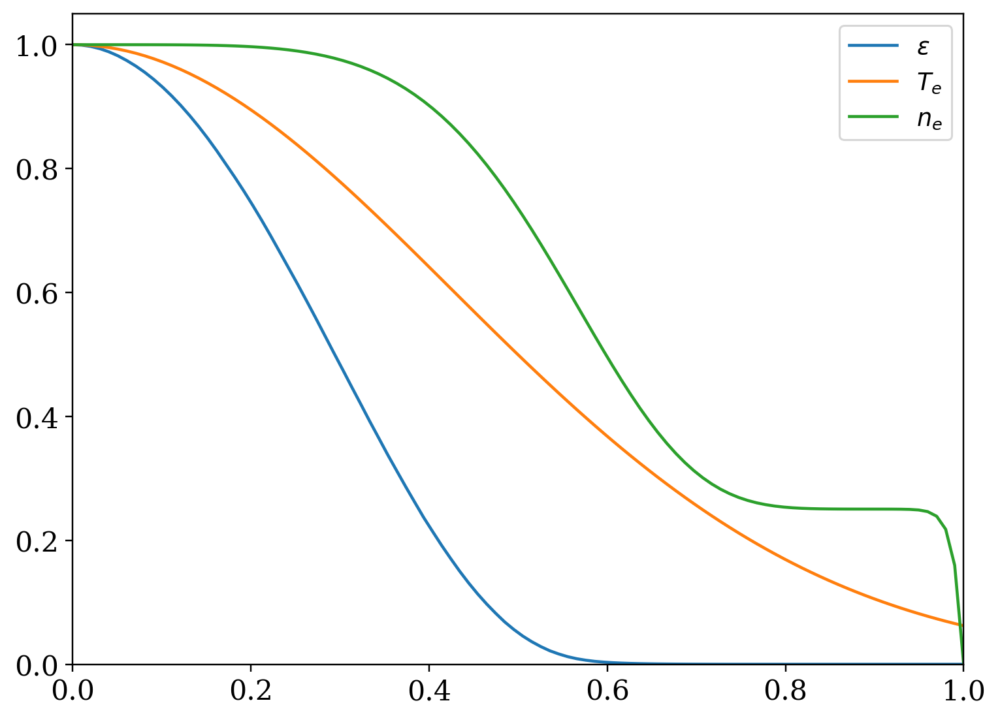

In [1262]:
rs = np.linspace(0, 1, num=100)

x0 = np.array([0., 500., 40.0, 2.0, 0.6])
emiss = get_emiss(rs, x0)
plt.plot(rs, emiss['thin']/emiss['thin'][0], label=r'$\varepsilon$')

temp = temp_prof_v2(rs, *x0)
plt.plot(rs, temp/temp[0], label=r'$T_e$')

dens = ne_prof(rs, *popt_dens[tn,:])
plt.plot(rs, dens/dens[0], label=r'$n_e$')

plt.legend(loc='upper right')
plt.xlim([0,1])
plt.ylim([0,None]);

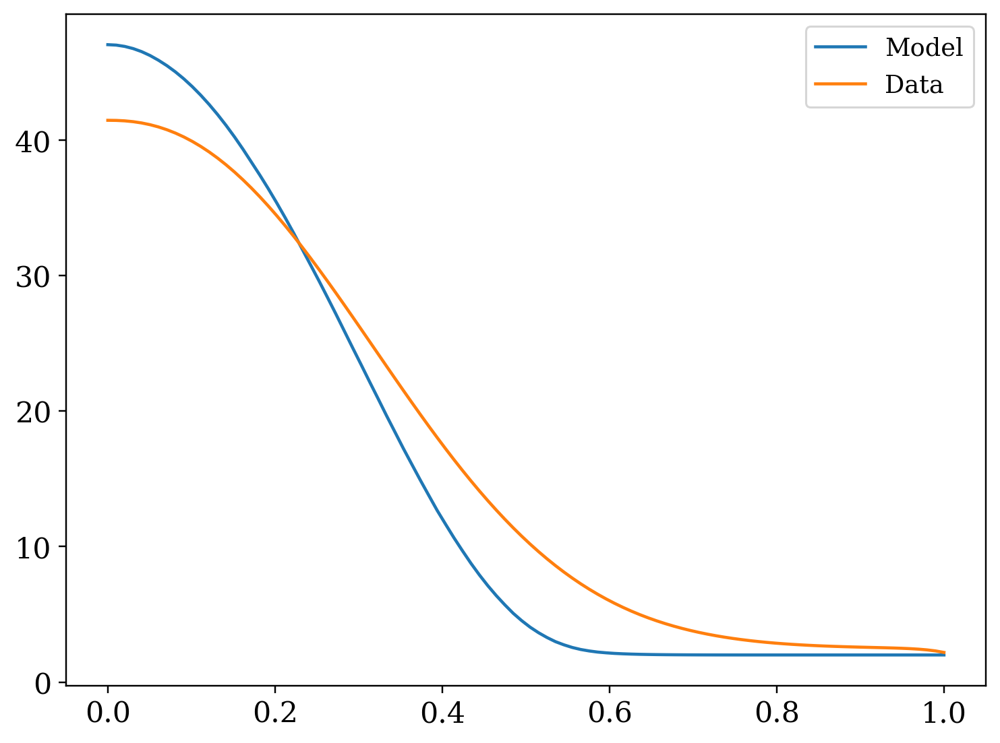

In [1259]:

plt.plot(rs, emiss['thin']+2, label='Model')

plt.plot(rs, emiss_45, label='Data')
plt.legend();

In [1307]:
import pickle

fdir = '/home/pdvanmeter/analysis/python/qsh_Te/pickle_jar'
fname = 'MST_s{0:d}_dens_samples.pkl'.format(shot)
fpath = os.path.join(fdir, fname)

with open(fpath, 'wb') as f:
    pickle.dump(samples, f)